# Hourly PSDS - FURT | WROMY | ROMY

## Load Libraries

In [54]:
from obspy import UTCDateTime
from scipy.signal import welch
from numpy import log10, zeros, pi, append, linspace, mean, median, array, where, transpose, shape, histogram, arange
from numpy import logspace, linspace, log, log10, isinf, ones, nan, count_nonzero, sqrt, isnan
from pandas import DataFrame, concat, Series, date_range, read_csv, read_pickle
from tqdm import tqdm_notebook
from pathlib import Path

import os, sys
import pickle
import matplotlib.pyplot as plt

# sys.path.append("/home/brotzer/andbro_python")

from andbro__querrySeismoData import __querrySeismoData
from andbro__savefig import __savefig


In [5]:
def __get_minimal_psd(psds):

    from numpy import nanmin, array, nonzero

    min_psd = zeros(psds.shape[1])

    for f in range(psds.shape[1]):
        a = psds[:,f]
        min_psd[f] = nanmin(a[nonzero(a)])

    return min_psd

In [6]:
def __get_median_psd(psds):

    from numpy import median, zeros, isnan

    med_psd = zeros(psds.shape[1])

    for f in range(psds.shape[1]):
        a = psds[:,f]
        med_psd[f] = median(a[~isnan(a)])

    return med_psd

In [7]:
def __get_minimum_psd(psds, f_tmp):

    for i, psd in enumerate(psds):
        if i == 0:
            lowest_value = psd.sum()
            idx = 0

        value = psd.sum()

        if value < lowest_value and value != 0:
            lowest_value = value
            idx = i

    return psds[idx]

In [8]:
def __get_array_from_dataframe(df):

    from pandas import to_numeric

    ## convert to list
    psds = []
    for col in array(df.columns):

        ## turn non-float series to float objects
        df[col] = to_numeric(df[col], errors = 'coerce')

        ## add to psds list
        psds.append(array(df[col]))

    return array(psds)

In [9]:
if os.uname().nodename == 'lighthouse':
    root_path = '/home/andbro/'
    data_path = '/home/andbro/kilauea-data/'
    archive_path = '/home/andbro/freenas/'
elif os.uname().nodename == 'kilauea':
    root_path = '/home/brotzer/'
    data_path = '/import/kilauea-data/'
    archive_path = '/import/freenas-ffb-01-data/'

## Configurations

In [10]:
## ---------------------------------------


name = "WROMY"
inname = "2023_WROMY_3600"
subdir = "WROMY/"
threshold = 8e-1
f_limits = 1/1600, 1.0


## ---------------------------------------

path = data_path+f"LNM2/PSDS/"

## load configurations
config = pickle.load(open(path+subdir+inname+"_config.pkl", 'rb'))

config['inname'] = inname
config['inpath'] = path+subdir
config['f_limits'] = f_limits
config['thres'] = threshold
config['station'] = name

config['outpath_figures'] = data_path+f"LNM2/figures/"

config['frequency_limits'] = [config['f_limits'][0], config['f_limits'][1]]


In [11]:
!ls /import/kilauea-data/LNM2/PSDS/FURT

2023_FURT_3600_20230101_hourly.pkl  2023_FURT_3600_20230420_hourly.pkl
2023_FURT_3600_20230102_hourly.pkl  2023_FURT_3600_20230421_hourly.pkl
2023_FURT_3600_20230103_hourly.pkl  2023_FURT_3600_20230422_hourly.pkl
2023_FURT_3600_20230104_hourly.pkl  2023_FURT_3600_20230423_hourly.pkl
2023_FURT_3600_20230105_hourly.pkl  2023_FURT_3600_20230424_hourly.pkl
2023_FURT_3600_20230106_hourly.pkl  2023_FURT_3600_20230425_hourly.pkl
2023_FURT_3600_20230107_hourly.pkl  2023_FURT_3600_20230426_hourly.pkl
2023_FURT_3600_20230108_hourly.pkl  2023_FURT_3600_20230427_hourly.pkl
2023_FURT_3600_20230109_hourly.pkl  2023_FURT_3600_20230428_hourly.pkl
2023_FURT_3600_20230110_hourly.pkl  2023_FURT_3600_20230429_hourly.pkl
2023_FURT_3600_20230111_hourly.pkl  2023_FURT_3600_20230430_hourly.pkl
2023_FURT_3600_20230112_hourly.pkl  2023_FURT_3600_20230501_hourly.pkl
2023_FURT_3600_20230113_hourly.pkl  2023_FURT_3600_20230502_hourly.pkl
2023_FURT_3600_20230114_hourly.pkl  2023_FURT_3600_20230503_hourly.pkl
2023_F

## Methods

In [12]:
def __filter_psds(psds, thresholds):

    from numpy import mean, array

    psds_filtered = []
        ## filter mean psds values
#         m_psd = mean(psd)
#         if m_psd > thresholds[0] and m_psd < thresholds[1]:
#             psds_filtered.append(psd)

    ## filter for periods larger than 20 seconds
    if mean(psd[0:63]) < thresholds[0]:
        psds_filtered.append(psd)

    print(f" -> removed {len(psds)- len(psds_filtered)} of {len(psds)} psds due to thresholds: {thresholds[0]} & {thresholds[1]}")
    return array(psds_filtered)

In [13]:
def __load_data_file(path, file):

    from tqdm.notebook import tqdm
    from numpy import array

    psds_all = []
    psds_hourly = read_pickle(path+file)

    for psd in psds_hourly:
        psds_all.append(psd)

    return array(psds_all)

In [14]:
def __cut_frequencies_array(arr, freqs, fmin, fmax):

    ind = []
    for i, f in enumerate(freqs):
        if f >= fmin and f <= fmax:
            ind.append(i)

    ff = freqs[ind[0]:ind[-1]]
    pp = arr[:,ind[0]:ind[-1]]

    return pp, ff

In [15]:
def __remove_noisy_psds(arr, threshold_mean=1e-16, ff=None, flim=None):

    from numpy import delete, shape, sort, array

    if flim is not None and ff is not None:
        for n, f in enumerate(ff):
            if f > flim:
                idx_max = n
                break

    l1 = shape(arr)[0]

    idx_to_remove = []
    rejected = []
    for ii in range(shape(arr)[0]):

        ## appy upper threshold
        if flim is not None and ff is not None:
            if arr[ii,:idx_max].mean() > threshold_mean:
                    rejected.append(arr[ii,:])
                    idx_to_remove.append(ii)
        else:
            if arr[ii,:].mean() > threshold_mean:
                rejected.append(arr[ii,:])
                idx_to_remove.append(ii)

        ## apply default lowe threshold
        if arr[ii,:].mean() < 1e-26:
            rejected.append(arr[ii,:])
            idx_to_remove.append(ii)

    for jj in sort(array(idx_to_remove))[::-1]:
        arr = delete(arr, jj, axis=0)

    l2 = shape(arr)[0]

    print(f" -> removed {l1-l2} rows due to mean thresholds!")
    print(f" -> {l2} psds remain")

    return arr, rejected

In [16]:
def __makeplot_colorlines(config, ff, psds, rejected, day):

    from tqdm.notebook import tqdm
    from numpy import isnan, median, mean, std, array, zeros
    from scipy.stats import median_abs_deviation as mad

#     psds_median = __get_median_psd(array(psds))
#     psds_minimal = __get_minimal_psd(array(psds))
#     psds_minimum = __get_minimum_psd(array(psds), ff)

    ##____________________________

    fig, axes = plt.subplots(1, 1, figsize=(15,7), sharey=False, sharex=True)

    plt.subplots_adjust(hspace=0.1)

    font = 14

    N = 24
    colors = plt.cm.rainbow(linspace(0, 1, N))
    cmap = plt.get_cmap('rainbow', 24)

    for n, psd in enumerate(psds):
        axes.loglog(ff, psd, color=colors[n], alpha=0.7)
        p2 = axes.scatter(ff[0], psd[0], s=0.1, c=int(n/N), cmap=cmap, vmin=0, vmax=N)

    for reject in rejected:
         axes.loglog(ff, reject, color='grey', alpha=0.6, zorder=1)

    axes.loglog(ff, __get_median_psd(psds), 'black', zorder=3, alpha=0.6, label="Median")

    axes.grid(True, which="both", ls="-", alpha=0.5)
    axes.legend(loc='lower left')
    axes.tick_params(labelsize=font-2)

#     axes.set_ylim(1e-23, 1e-16)

    axes.set_xlabel("  Frequency (Hz)", fontsize=font, labelpad=-1)


    axes.set_ylabel(r"PSD$_{vertical}$ (m$^2$/s$^4$/$Hz)$", fontsize=font)

    ## set colorbar at bottom
    cbar = fig.colorbar(p2, orientation='vertical', ax=axes, aspect=50, pad=-1e-5,
                       ticks=arange(1,N,2))


    plt.show();
    return fig

In [49]:
def __makeplot_colorlines_overview(config, ff, psds, rejected, day):

    from tqdm.notebook import tqdm
    from numpy import isnan, median, mean, std, array, zeros
    from scipy.stats import median_abs_deviation as mad

#     psds_median = __get_median_psd(array(psds))
#     psds_minimal = __get_minimal_psd(array(psds))
#     psds_minimum = __get_minimum_psd(array(psds), ff)


    ## convert frequencies to periods
    pp=[]
    for mm in range(len(ff)):
        ppp = zeros(len(ff[mm]))
        ppp = 1/ff[mm]
        pp.append(ppp)


    ##____________________________

    NN = 3

    fig, axes = plt.subplots(NN,1, figsize=(10,10), sharey=False, sharex=True)

    plt.subplots_adjust(hspace=0.1)

    font = 14

    N =24

    colors = plt.cm.rainbow(linspace(0,1,N))
    cmap = plt.get_cmap('rainbow', 24)


    for j in range(NN):
        for n, psd in enumerate(psds[j]):
            axes[j].loglog(ff[j], psd, color=colors[n], alpha=0.7)
            p2 = axes[j].scatter(ff[j][0], psd[0], s=0., c=n/N, cmap=cmap, vmin=0, vmax=N, zorder=3)

        for reject in rejected[j]:
             axes[j].loglog(ff[j],reject, color='grey', alpha=0.6, zorder=2)

        axes[j].loglog(ff[j], __get_median_psd(psds[j]), 'black', zorder=3, alpha=0.6, label="Median")

        axes[j].set_xlim(config['frequency_limits'][0], config['frequency_limits'][1])
        axes[j].grid(True, which="both", ls="-", alpha=0.5)
        axes[j].legend(loc='lower left')
        axes[j].tick_params(labelsize=font-2)

    freq = arange(0.0001, 1, 0.001)
    plim = 0.1**2 * ones(len(freq)) / freq  ## resolution = 0.1 hPa
    axes[1].loglog(freq, plim, color="black", ls="--", zorder=1)
    axes[2].loglog(freq, plim, color="black", ls="--", zorder=1)

    axes[NN-1].set_xlabel("  Frequency (Hz)", fontsize=font, labelpad=-1)

    ## panel labels
    axes[0].text(.01, .99, 'a)', ha='left', va='top', transform=axes[0].transAxes, fontsize=font+2)
    axes[1].text(.01, .99, 'b)', ha='left', va='top', transform=axes[1].transAxes, fontsize=font+2)
    axes[2].text(.01, .99, 'c)', ha='left', va='top', transform=axes[2].transAxes, fontsize=font+2)


    axes[0].text(.8, .9, 'ROMY-Z', ha='left', va='top', transform=axes[0].transAxes, fontsize=font+2)
    axes[1].text(.8, .9, 'FURT', ha='left', va='top', transform=axes[1].transAxes, fontsize=font+2)
    axes[2].text(.8, .9, 'WS1', ha='left', va='top', transform=axes[2].transAxes, fontsize=font+2)

    axes[0].set_ylim(bottom=1e-23)

    axes[0].set_ylabel(r"ROMY PSD$_{Z}$ (rad$^2$/s$^4$/Hz)", fontsize=font)
    axes[1].set_ylabel(r"FURT PSD (hPa$^2$/Hz)", fontsize=font)
    axes[2].set_ylabel(r"WROMY PSD (hPa$^2$/Hz)", fontsize=font)

    ## set colorbar at bottom
    cbar = fig.colorbar(p2, orientation='vertical', ax=axes.ravel().tolist(), aspect=50, pad=-1e-5,
                       ticks=arange(1,N,2))


    plt.show();
    return fig

## RUN for all files 

2023_WROMY_3600_20230324_hourly.pkl
 -> removed 10 rows due to mean thresholds!
 -> 14 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 5 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
Exception ignored in: <function tqdm.__del__ at 0x7f98803d64c0>
Traceback (most recent call last):
  File "/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/tqdm/std.py", line 1147, in __del__
    self.close()
  File "/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/tqdm/notebook.py", line 283, in close
    self.disp(bar_style='danger', check_delay=False)
AttributeError: 'tqdm_notebook' object has no attribute 'disp'


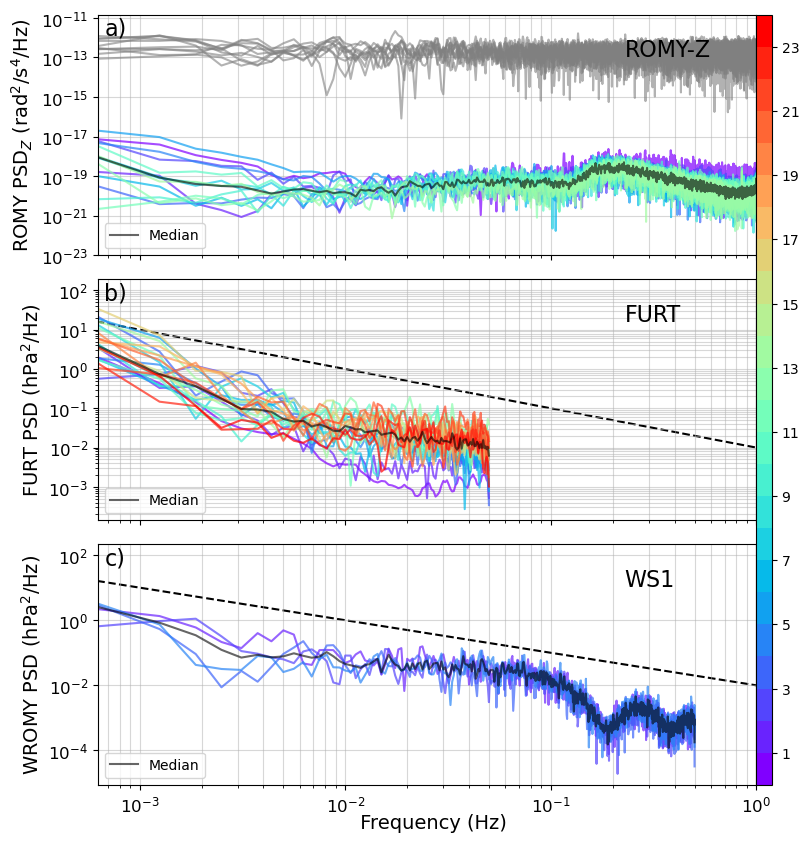

2023_WROMY_3600_20230325_hourly.pkl
 -> removed 11 rows due to mean thresholds!
 -> 13 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


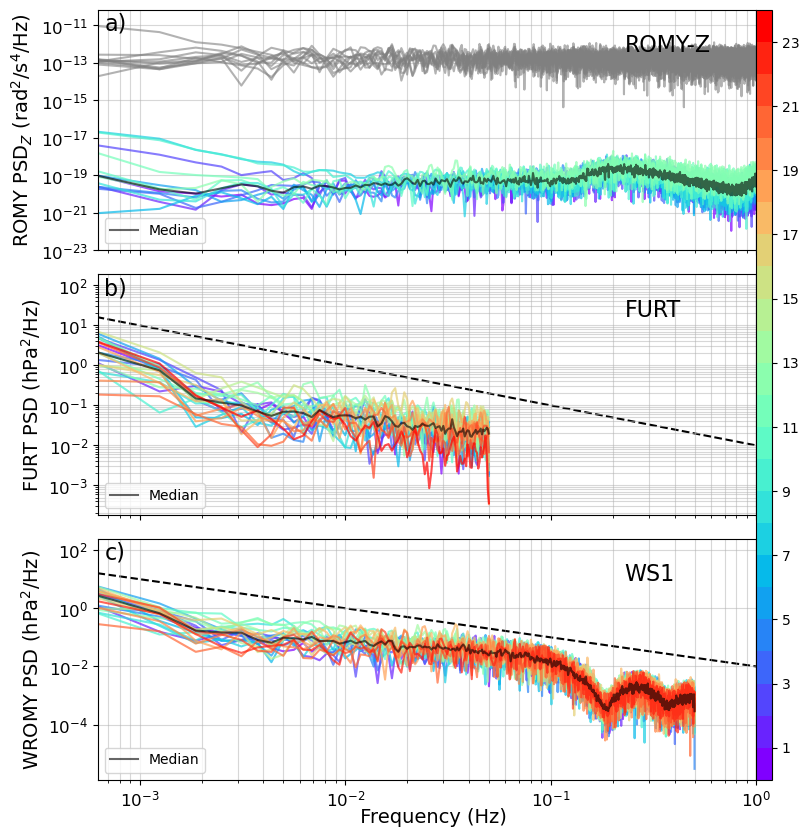

2023_WROMY_3600_20230326_hourly.pkl
 -> removed 21 rows due to mean thresholds!
 -> 3 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


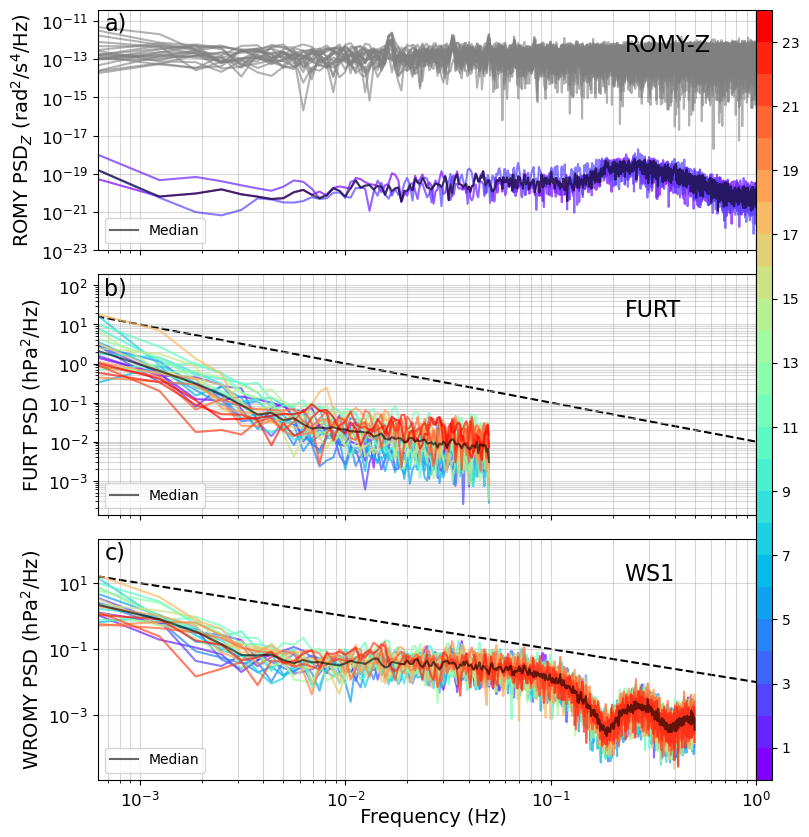

2023_WROMY_3600_20230327_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


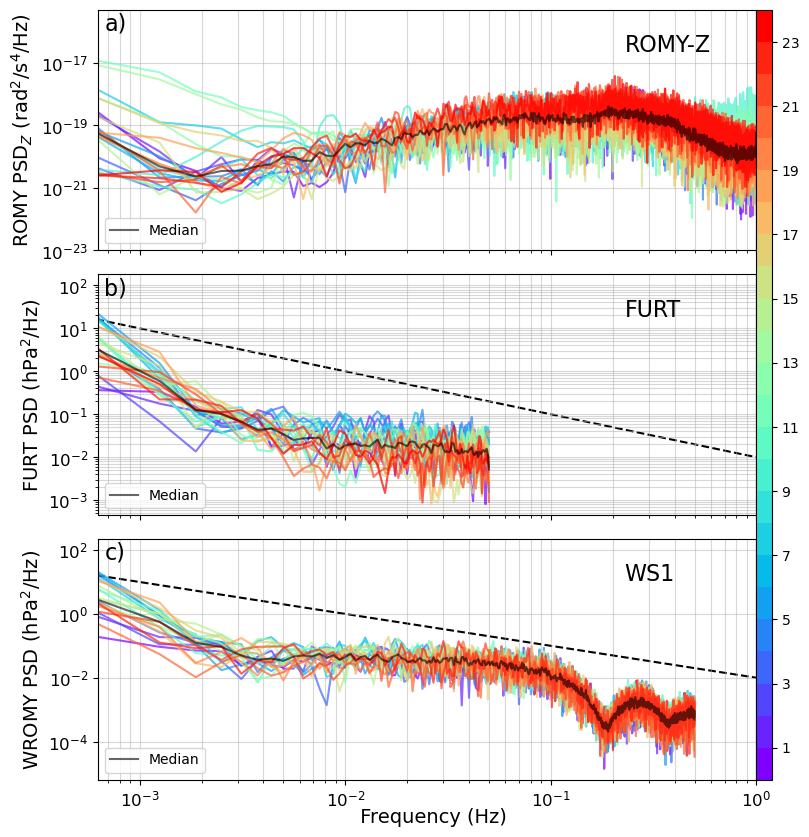

2023_WROMY_3600_20230328_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


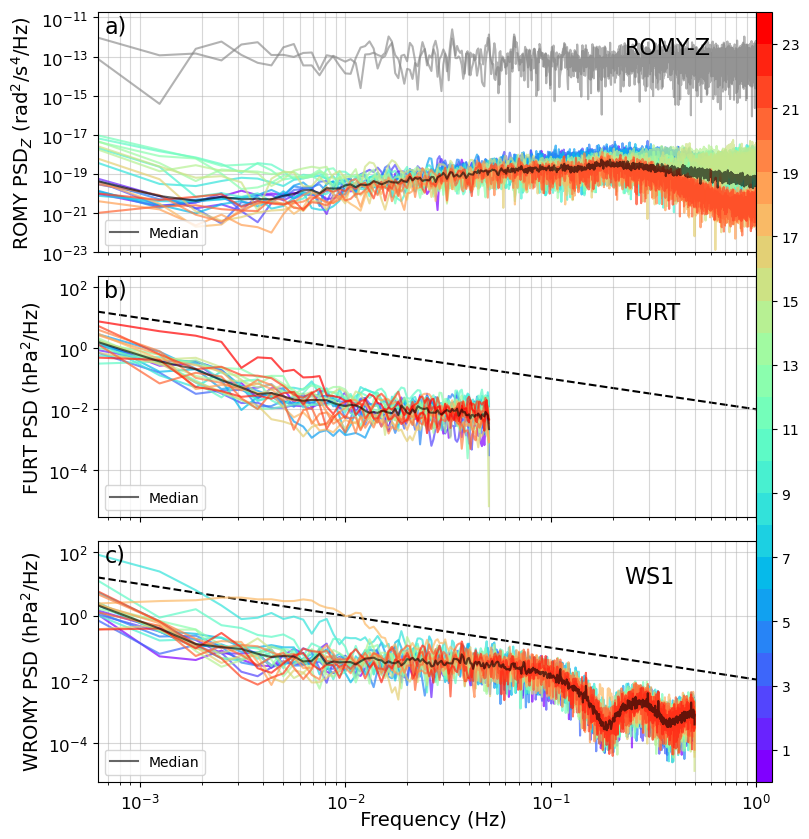

2023_WROMY_3600_20230329_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


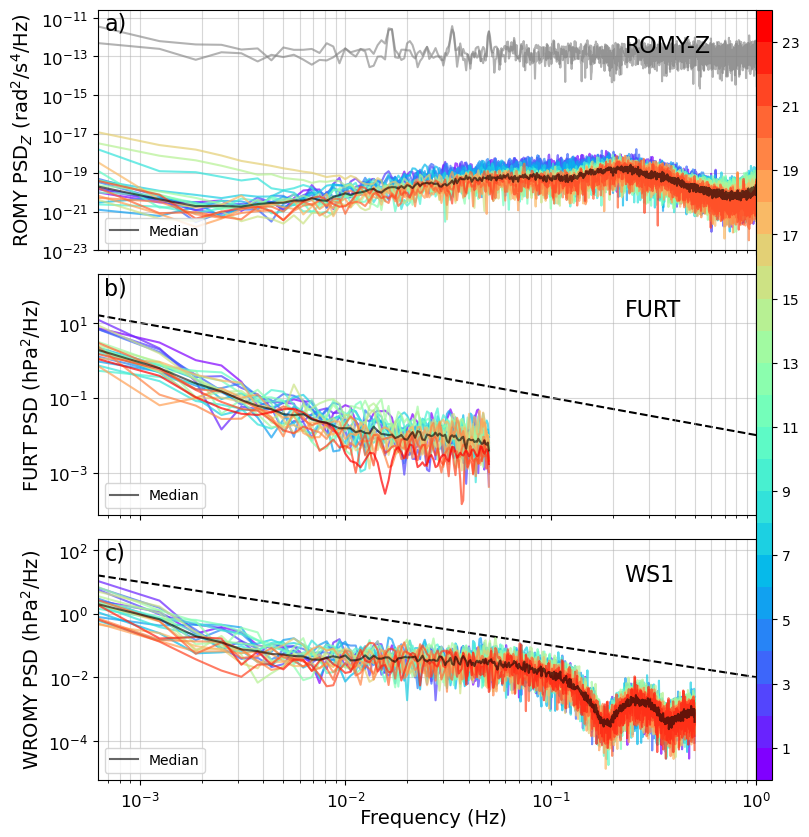

2023_WROMY_3600_20230330_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


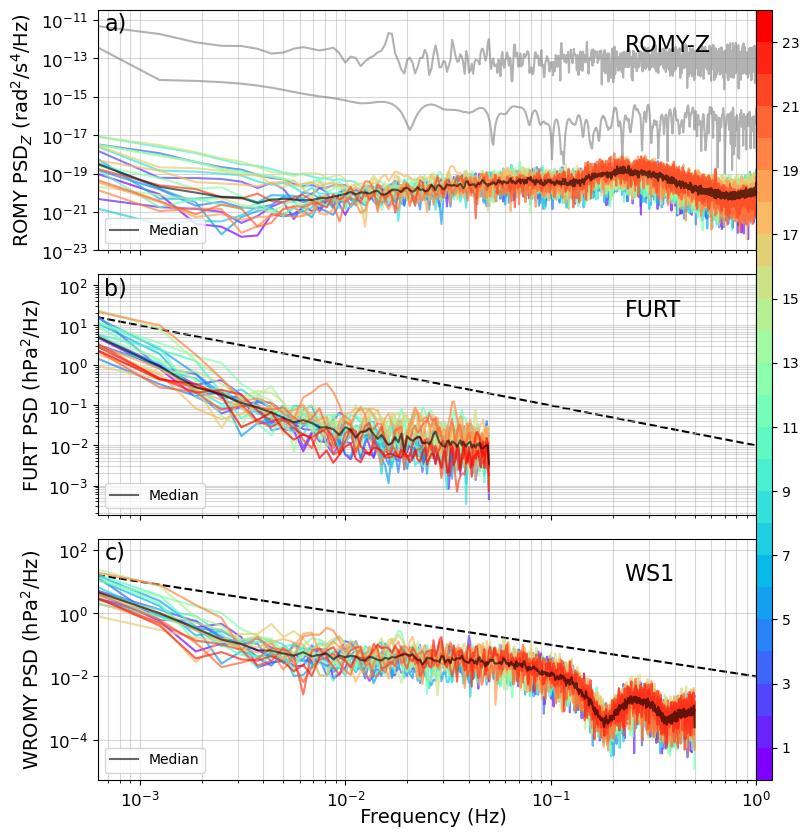

2023_WROMY_3600_20230331_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


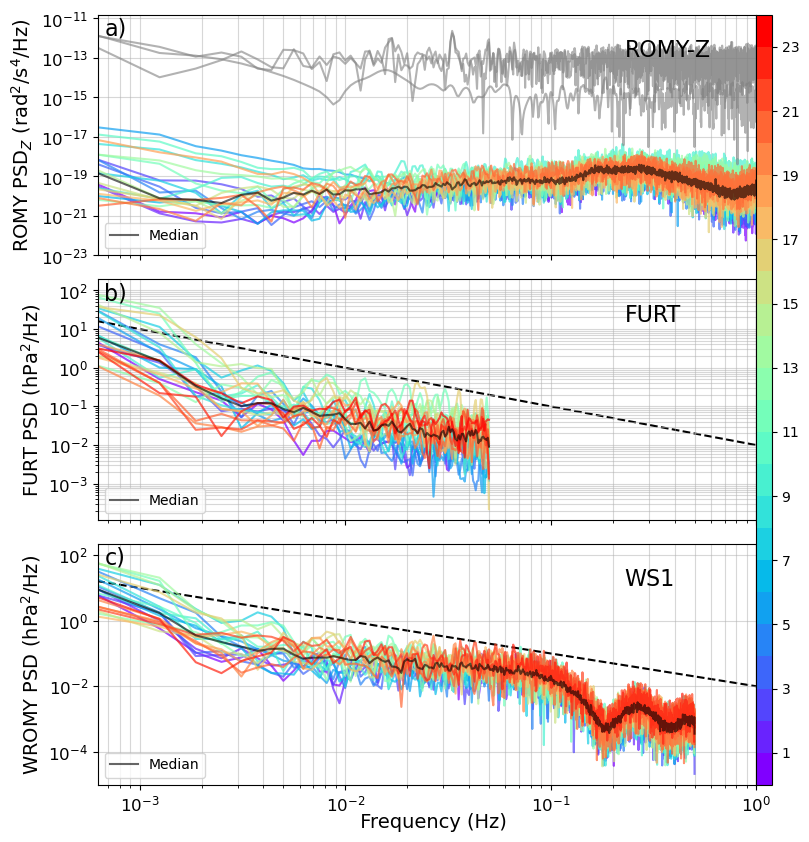

2023_WROMY_3600_20230401_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


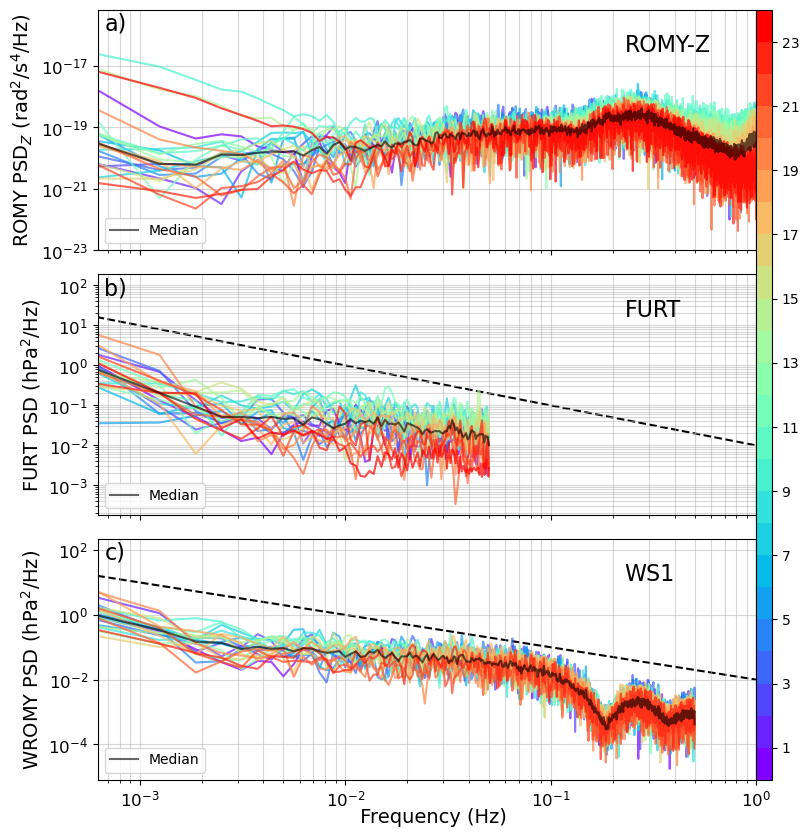

2023_WROMY_3600_20230402_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


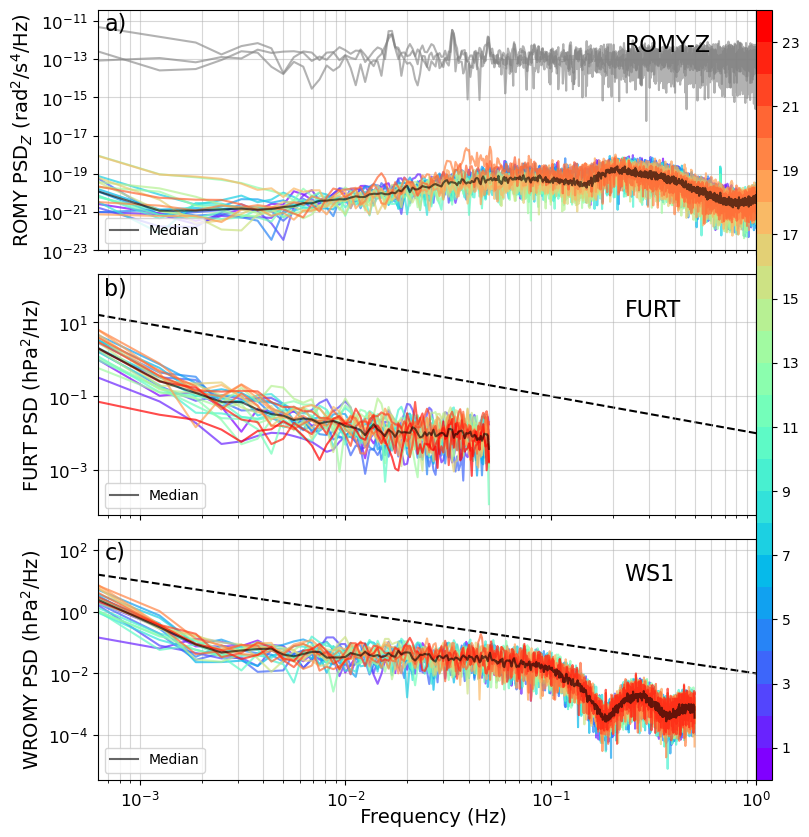

2023_WROMY_3600_20230403_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
2023_WROMY_3600_20230404_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


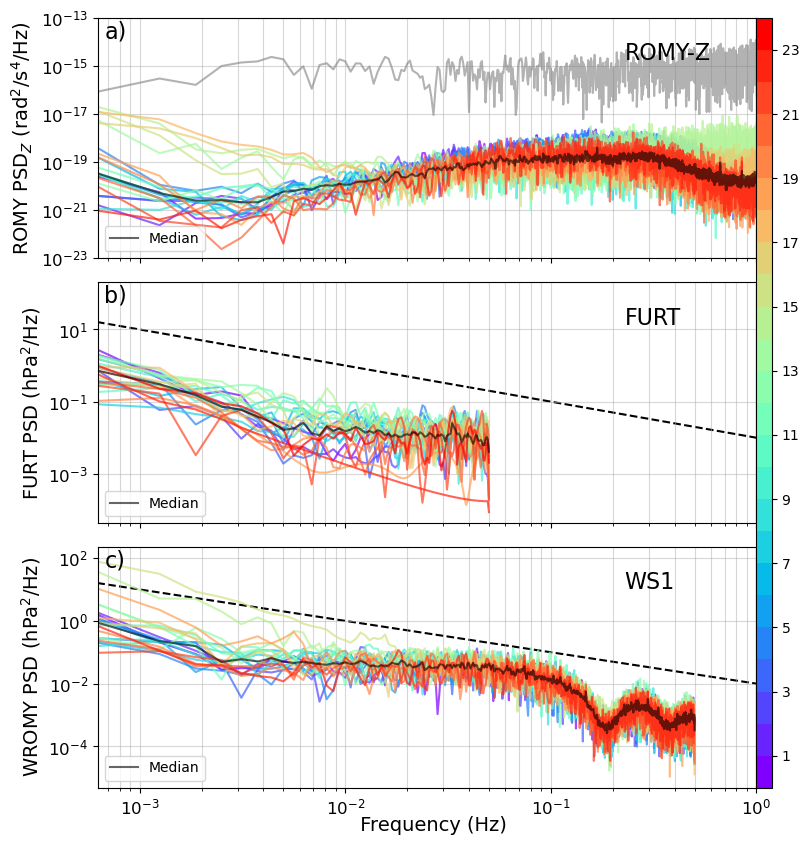

2023_WROMY_3600_20230405_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


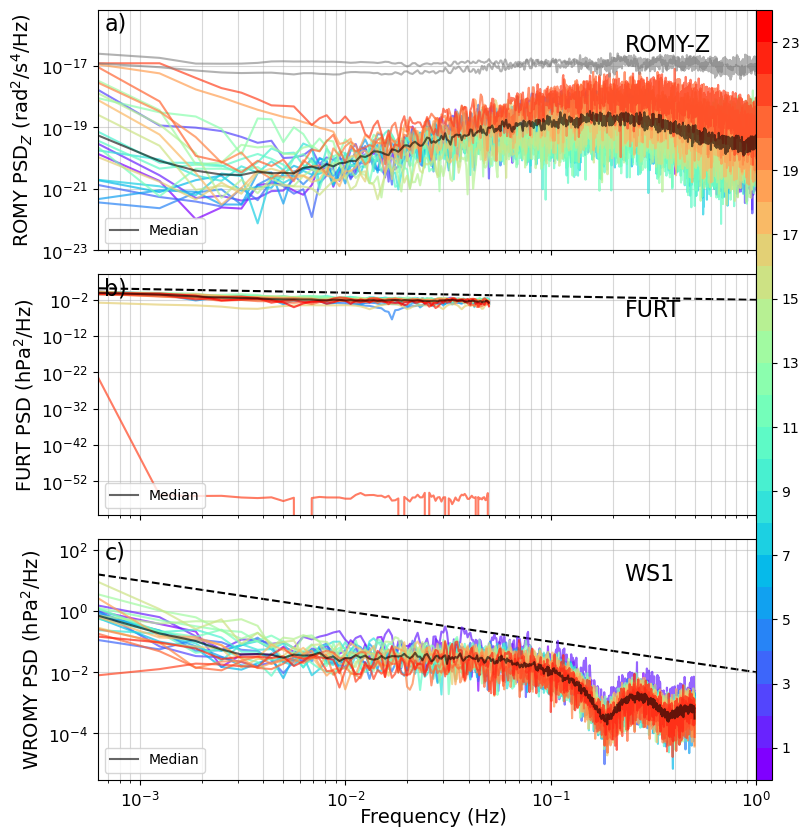

2023_WROMY_3600_20230406_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


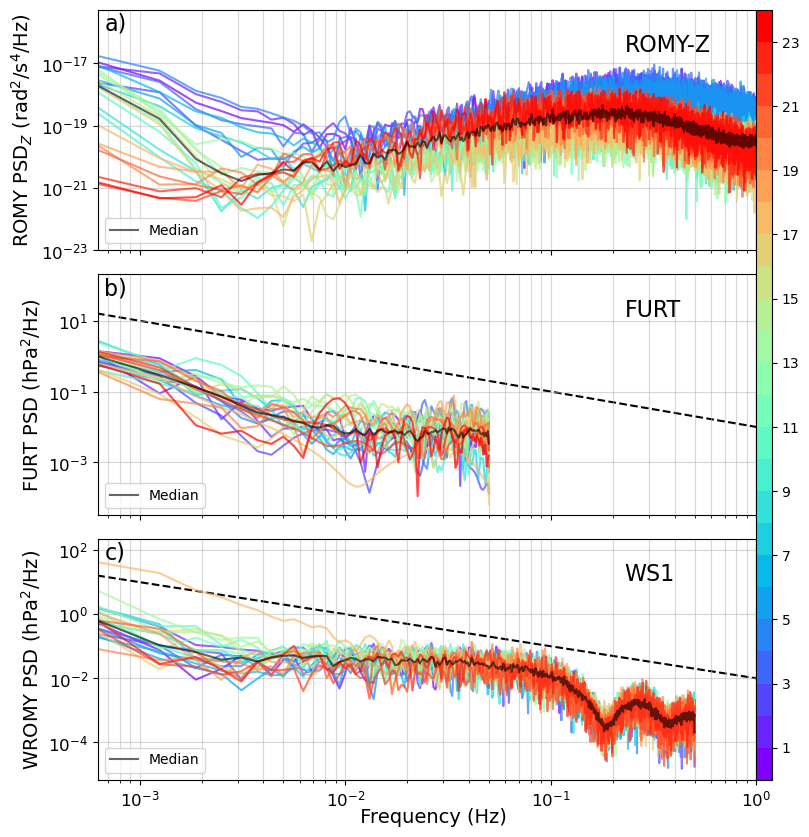

2023_WROMY_3600_20230407_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


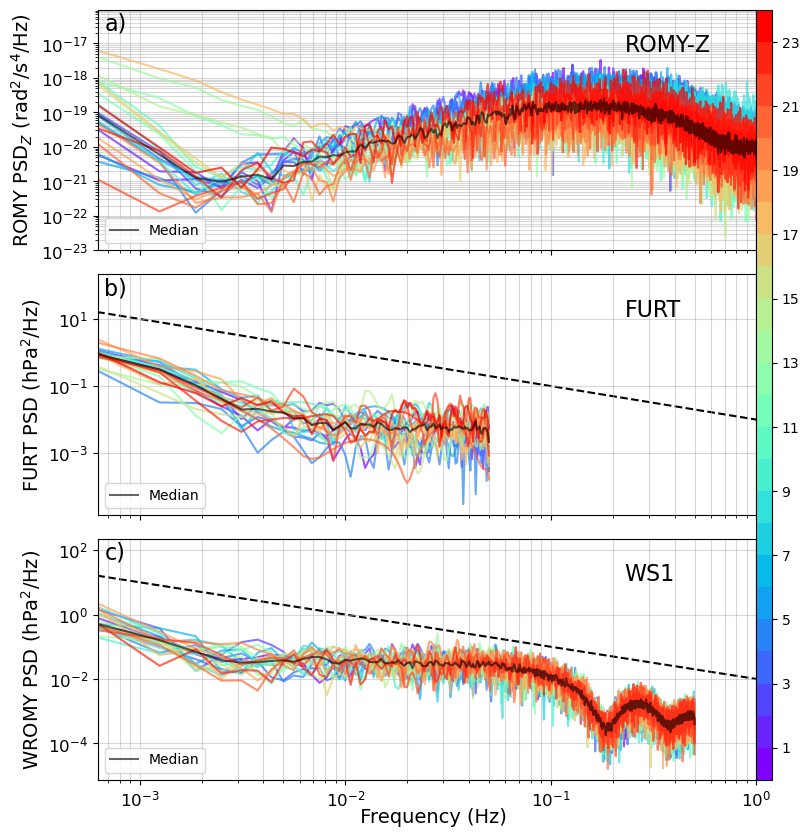

2023_WROMY_3600_20230408_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


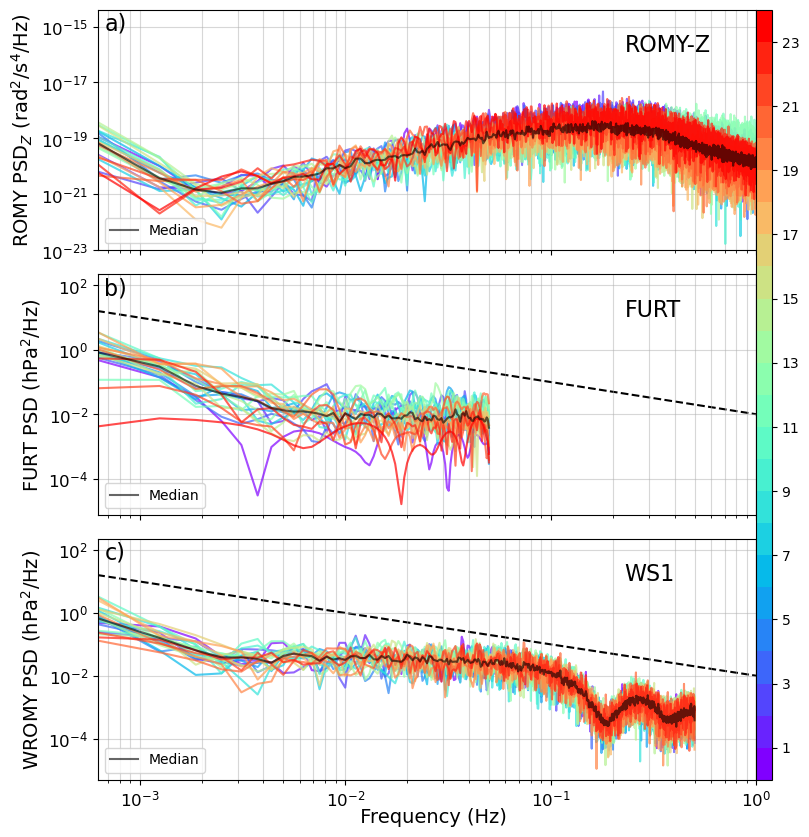

2023_WROMY_3600_20230409_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


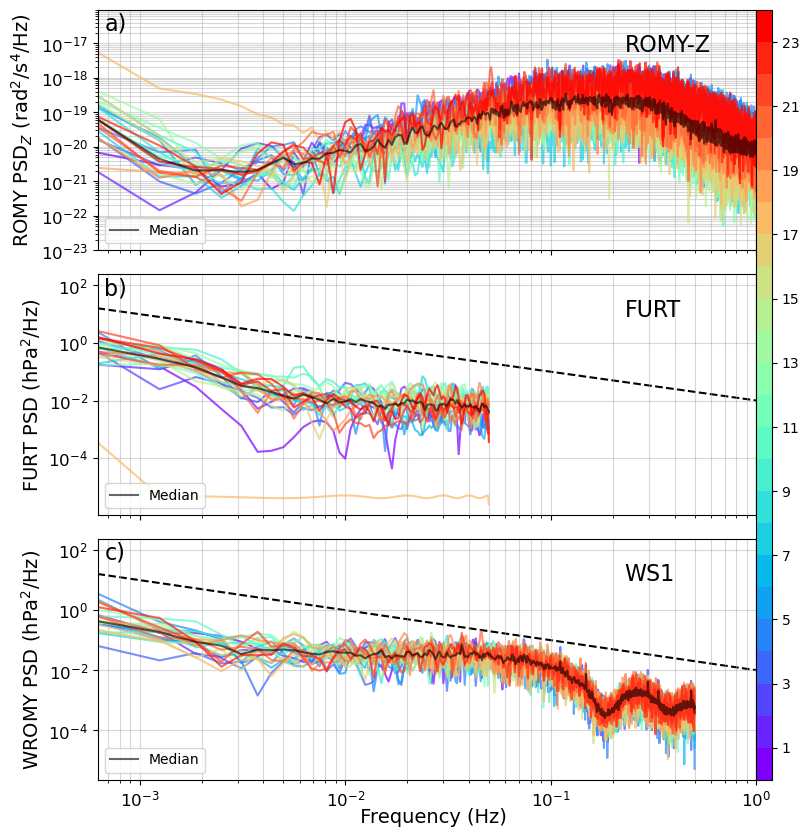

2023_WROMY_3600_20230410_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


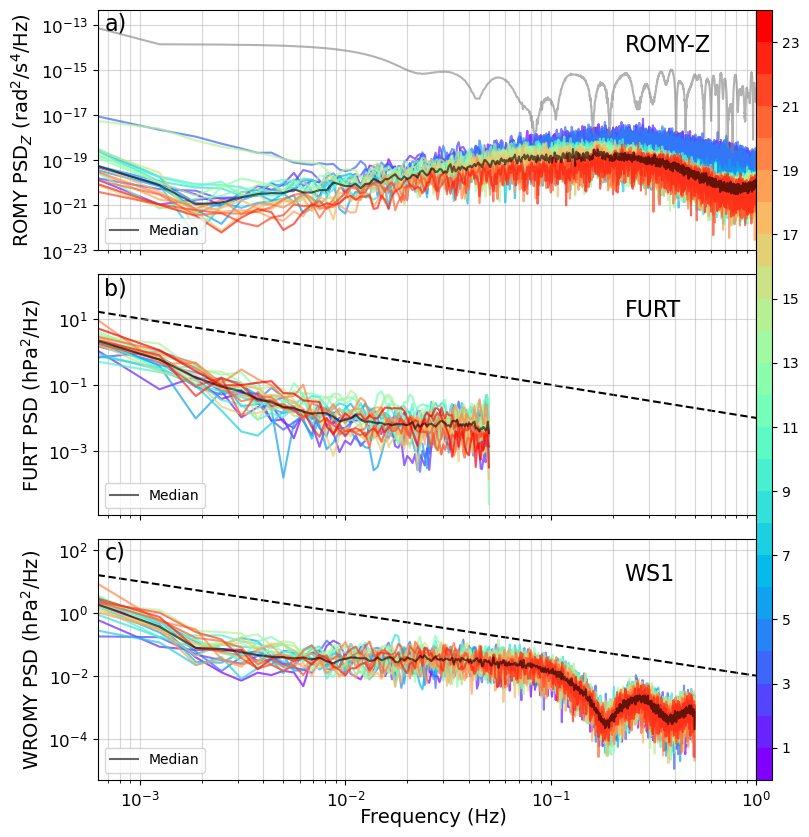

2023_WROMY_3600_20230411_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


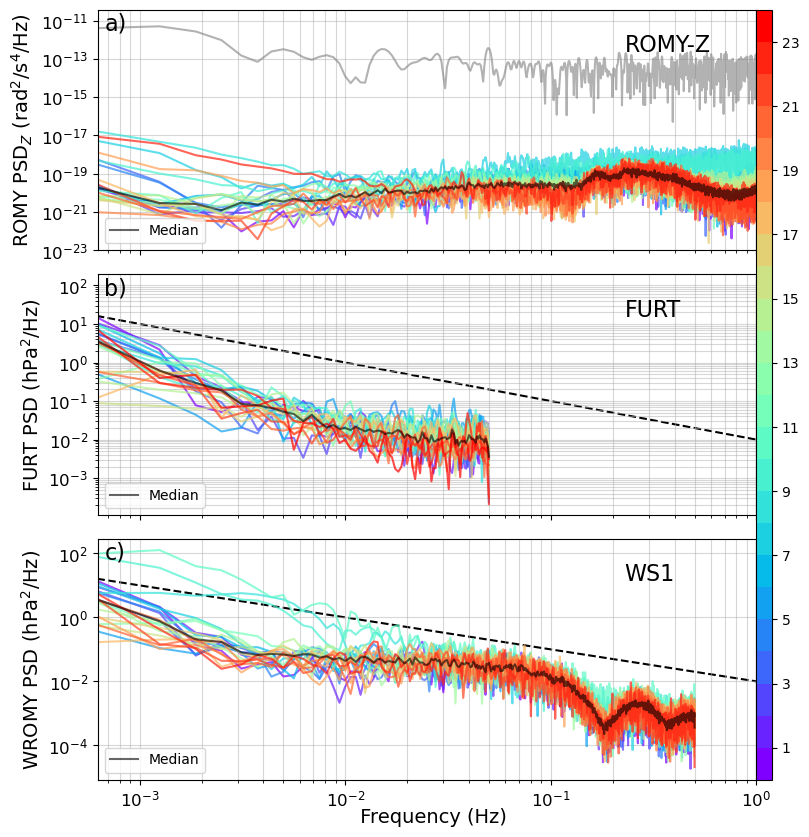

2023_WROMY_3600_20230412_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


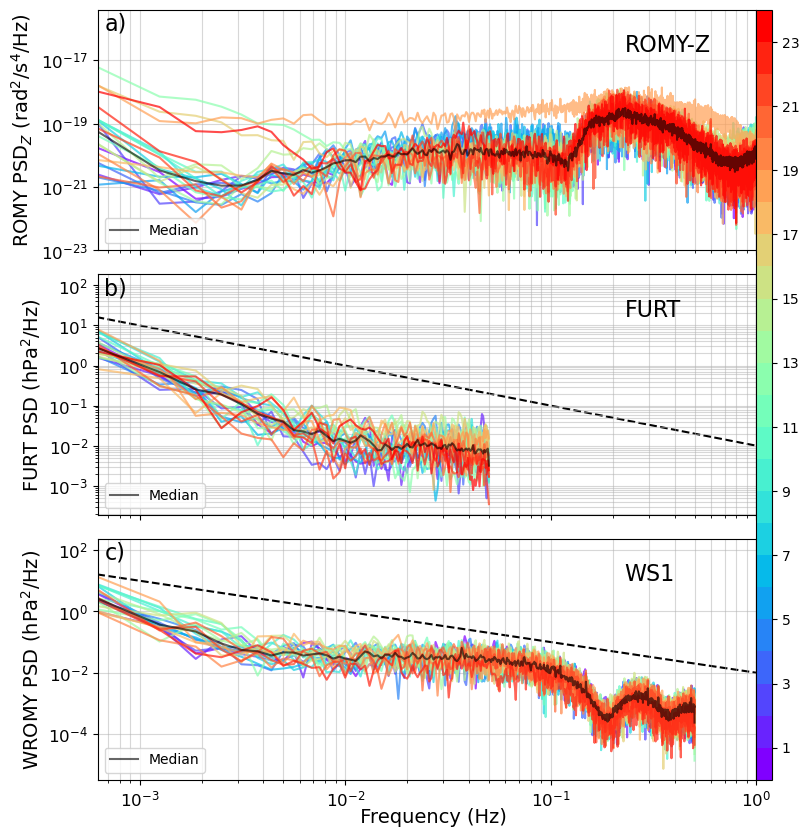

2023_WROMY_3600_20230413_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


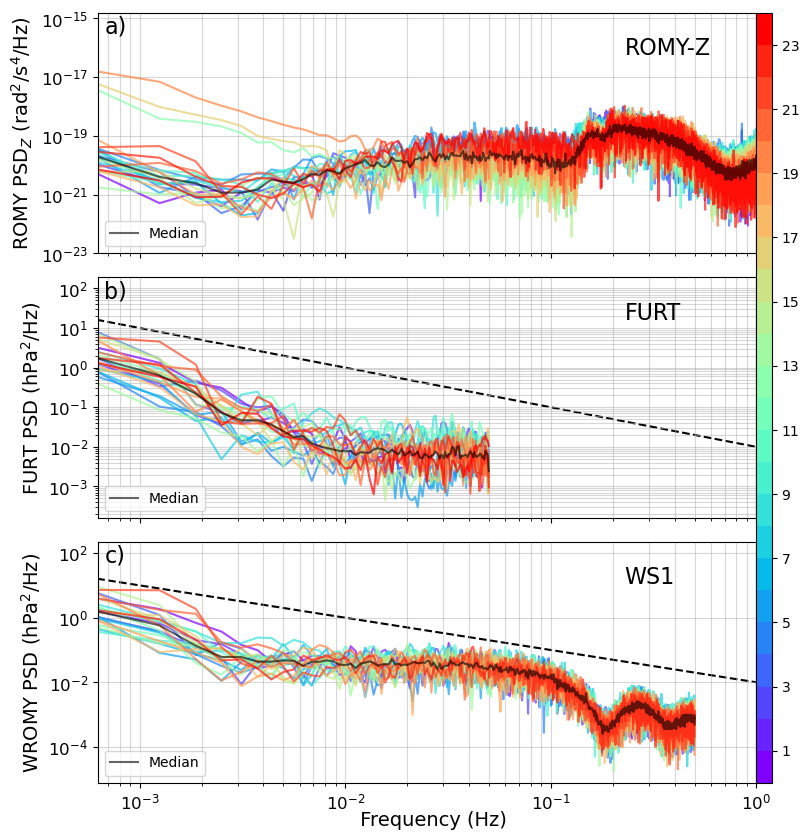

2023_WROMY_3600_20230414_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


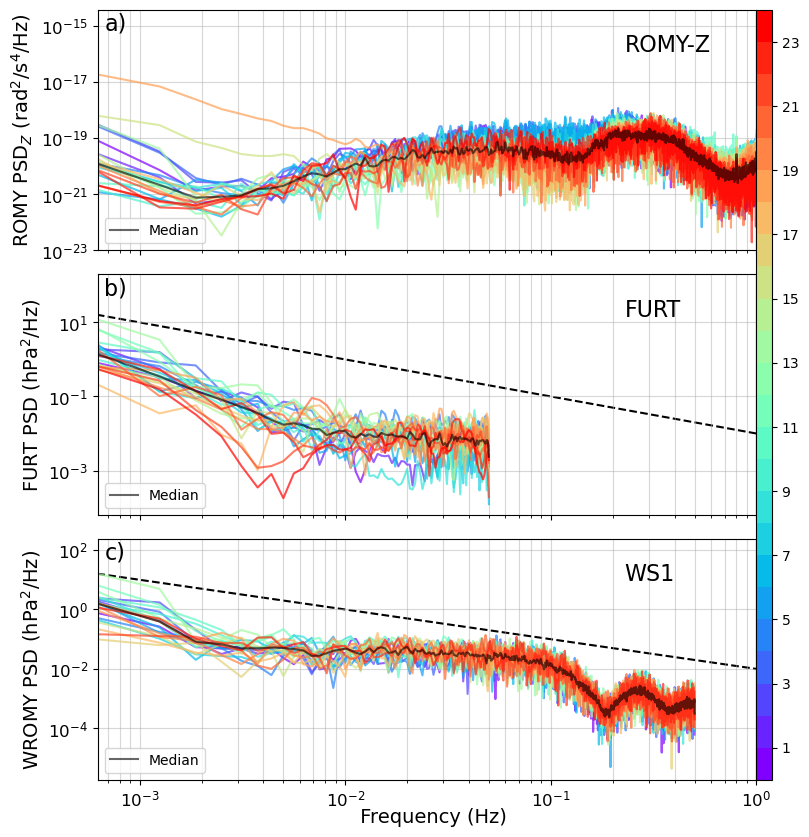

2023_WROMY_3600_20230415_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


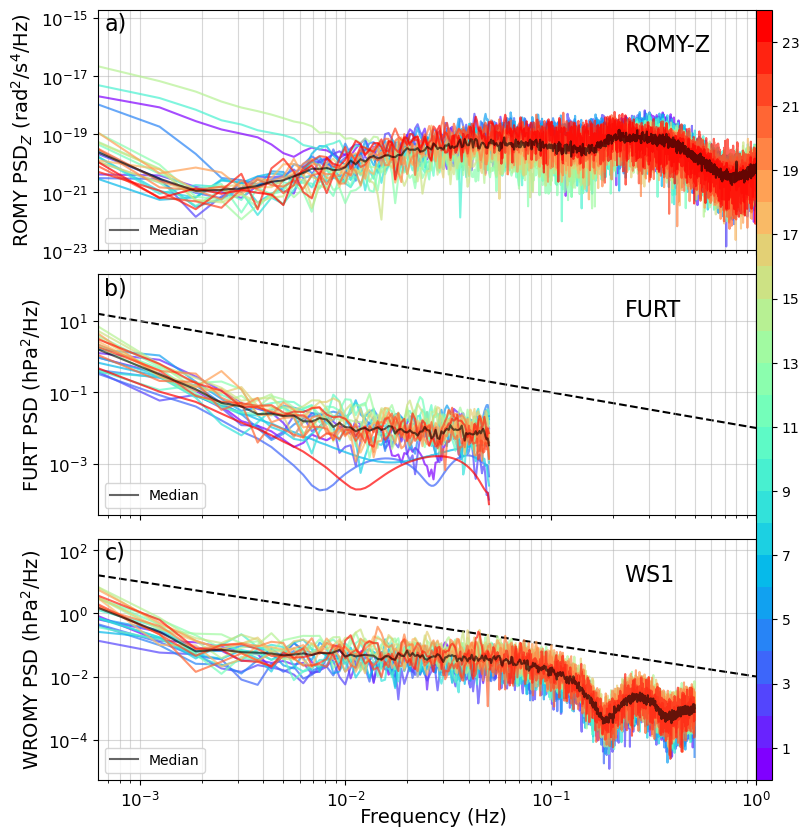

2023_WROMY_3600_20230416_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


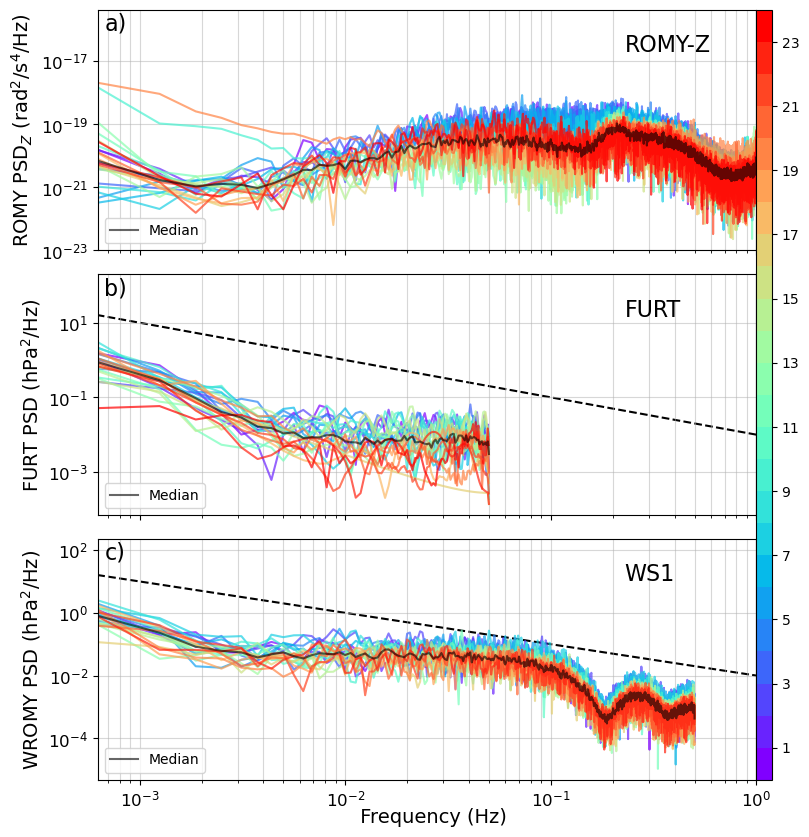

2023_WROMY_3600_20230417_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


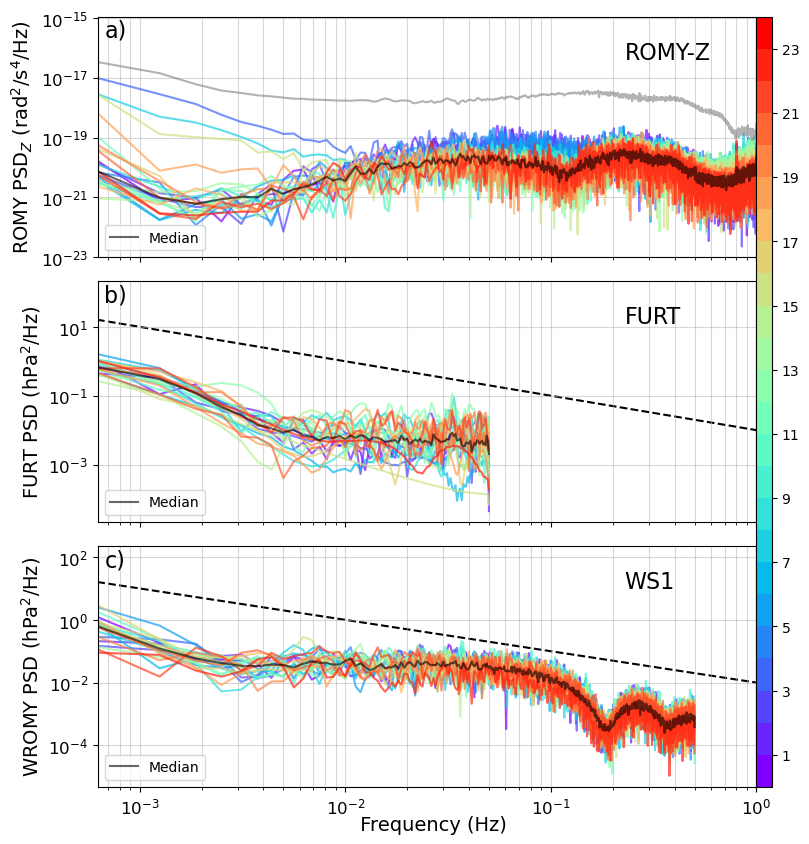

2023_WROMY_3600_20230418_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


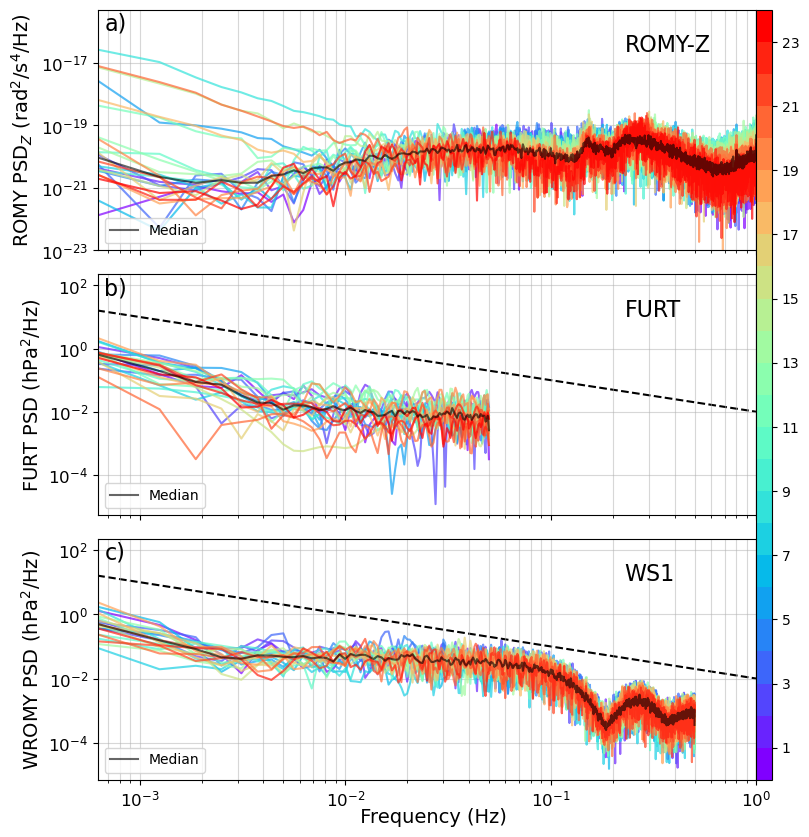

2023_WROMY_3600_20230419_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


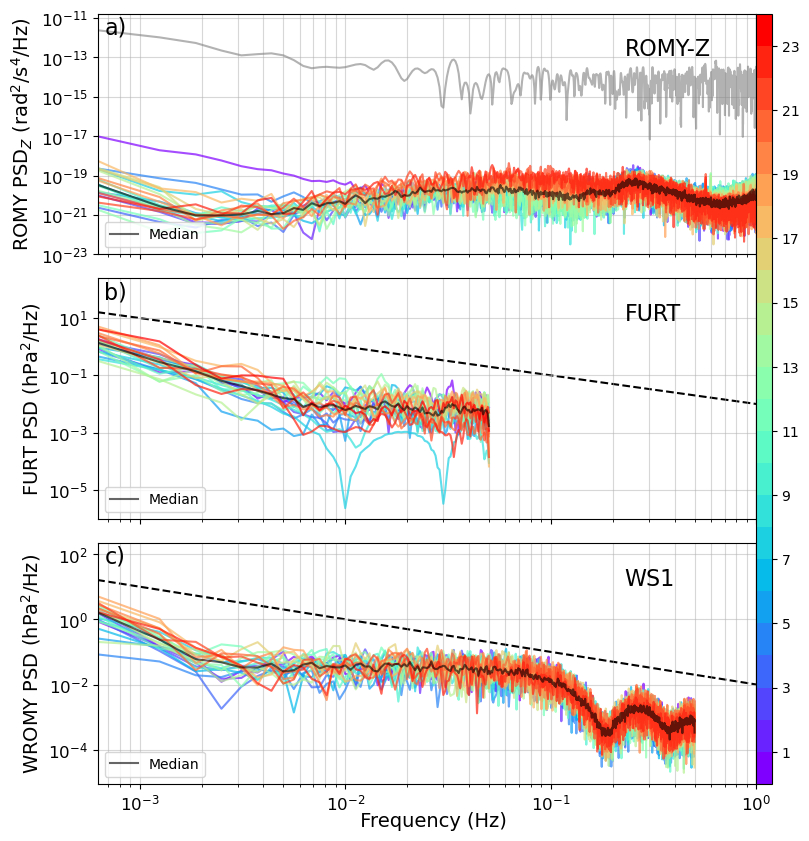

2023_WROMY_3600_20230420_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


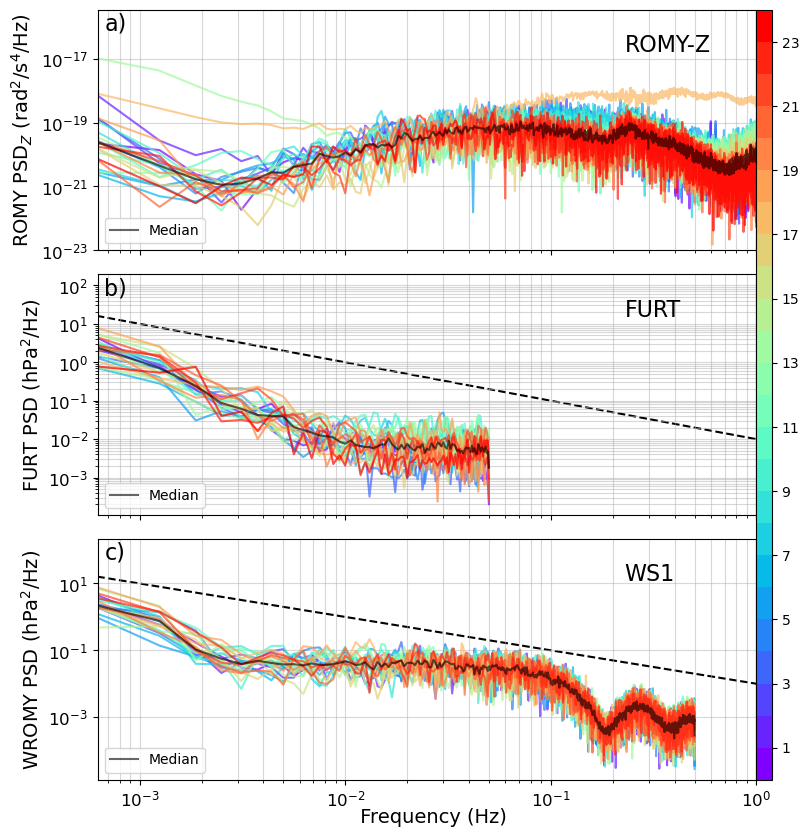

2023_WROMY_3600_20230421_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


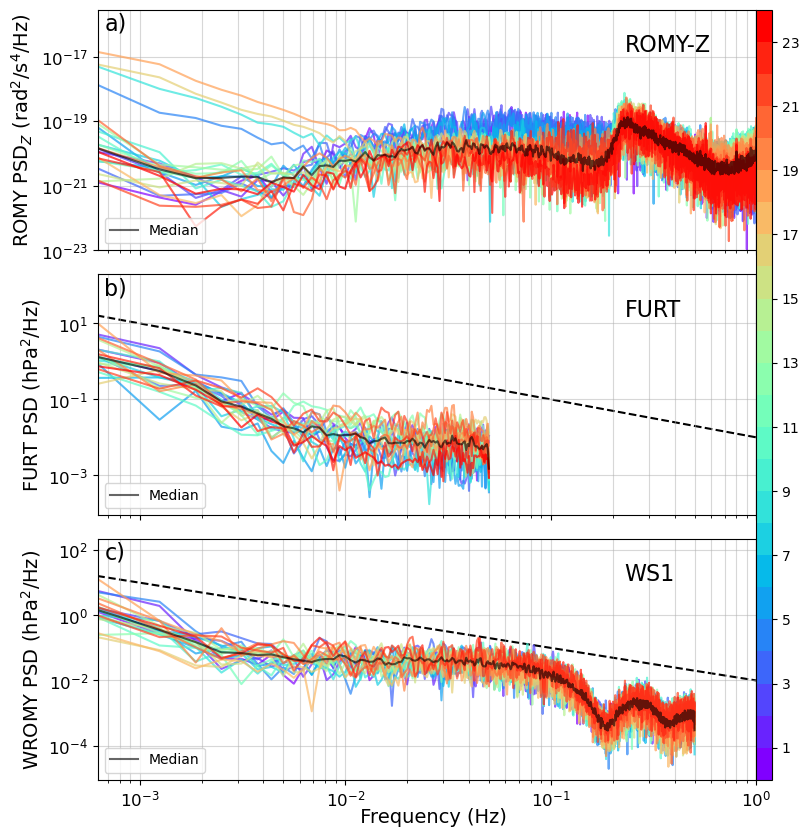

2023_WROMY_3600_20230422_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


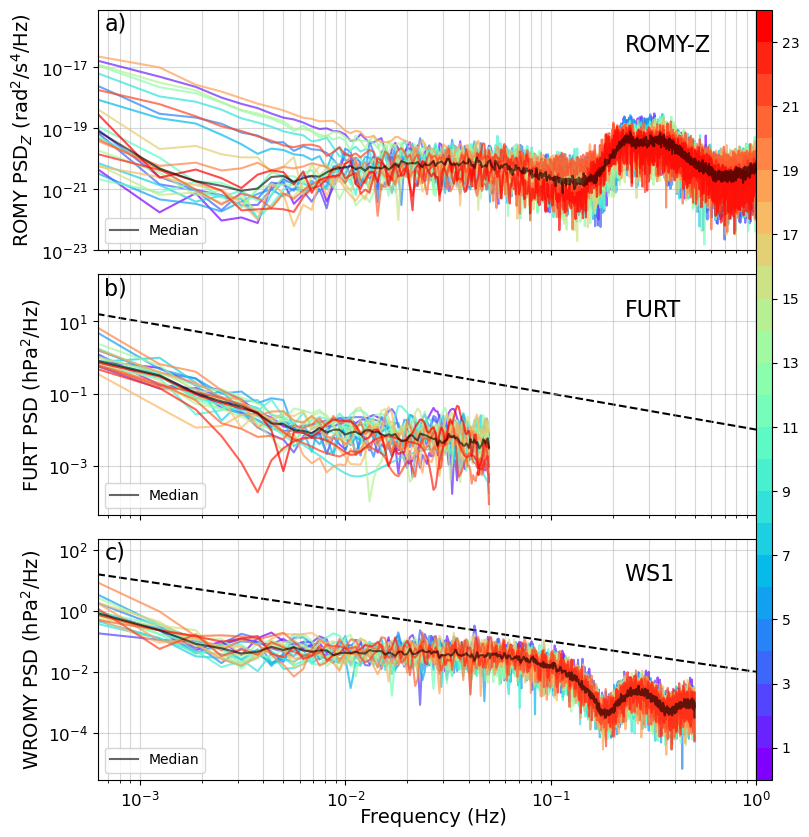

2023_WROMY_3600_20230423_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


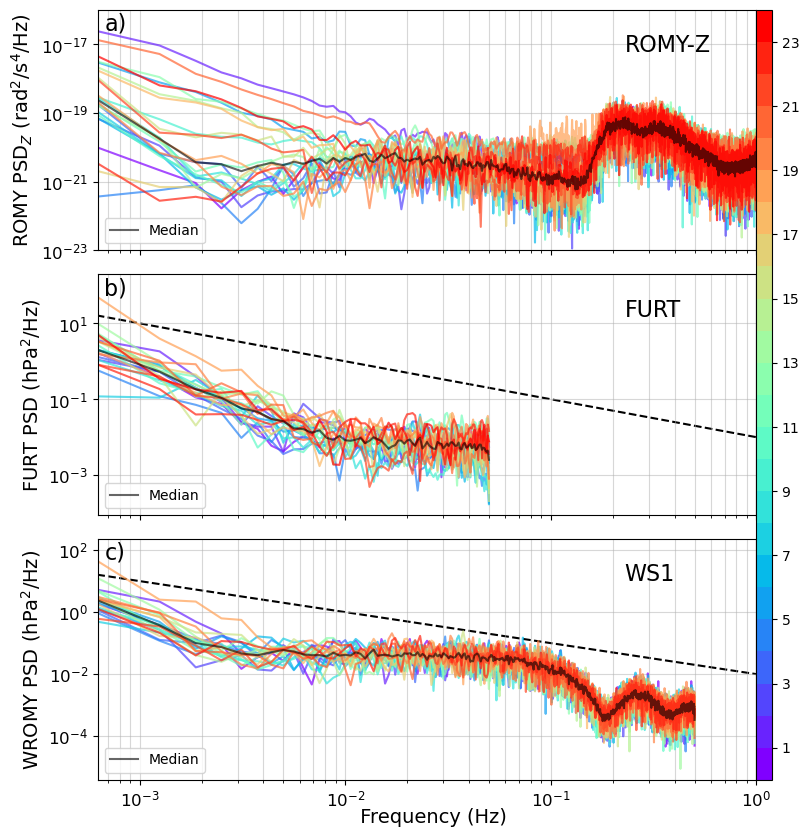

2023_WROMY_3600_20230424_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


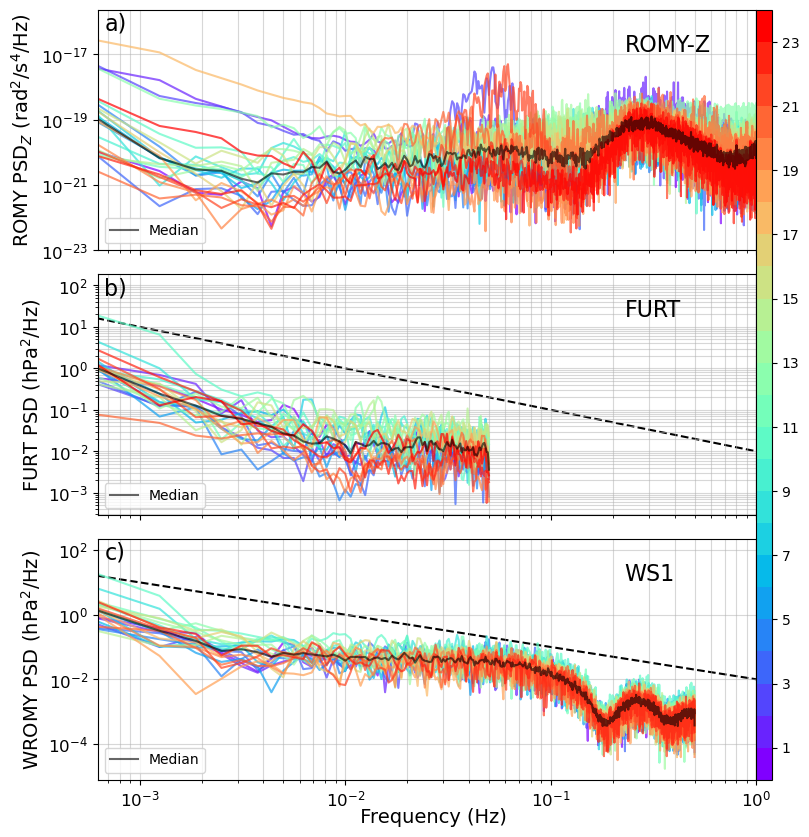

2023_WROMY_3600_20230425_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


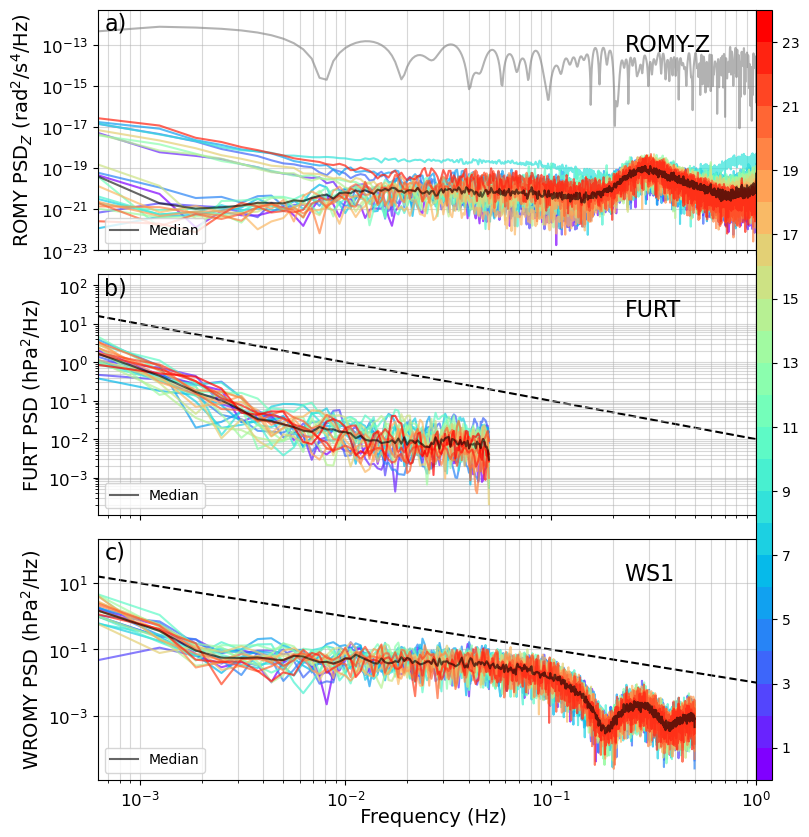

2023_WROMY_3600_20230426_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


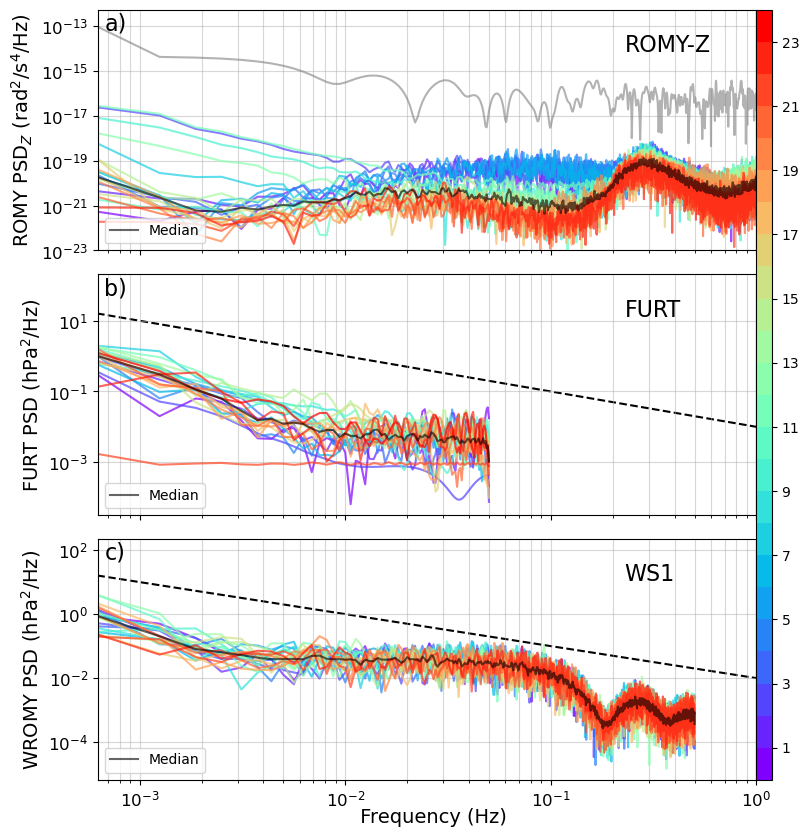

2023_WROMY_3600_20230427_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


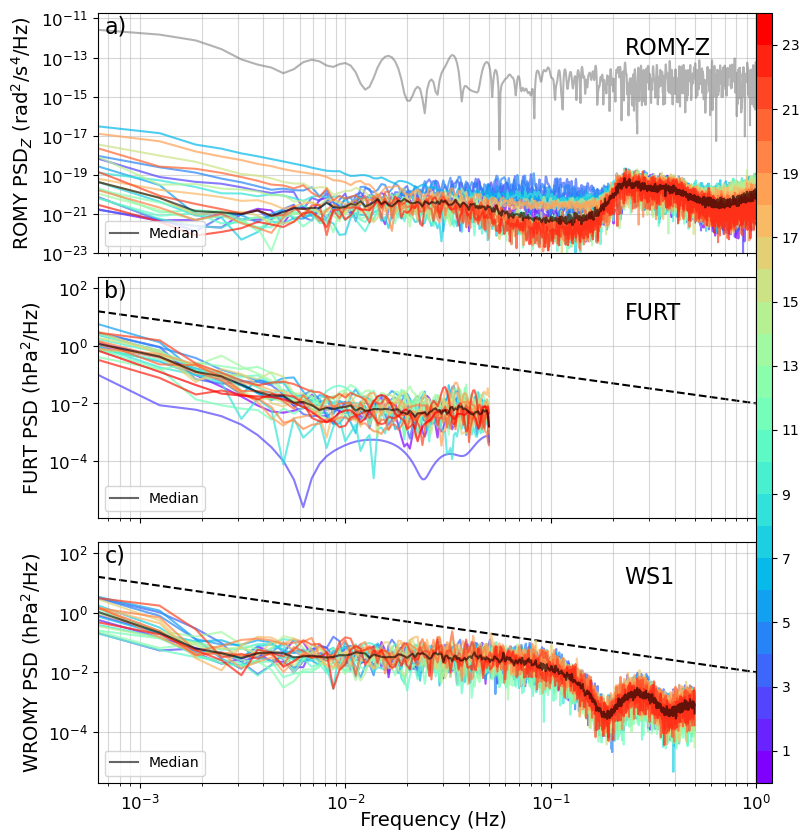

2023_WROMY_3600_20230428_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


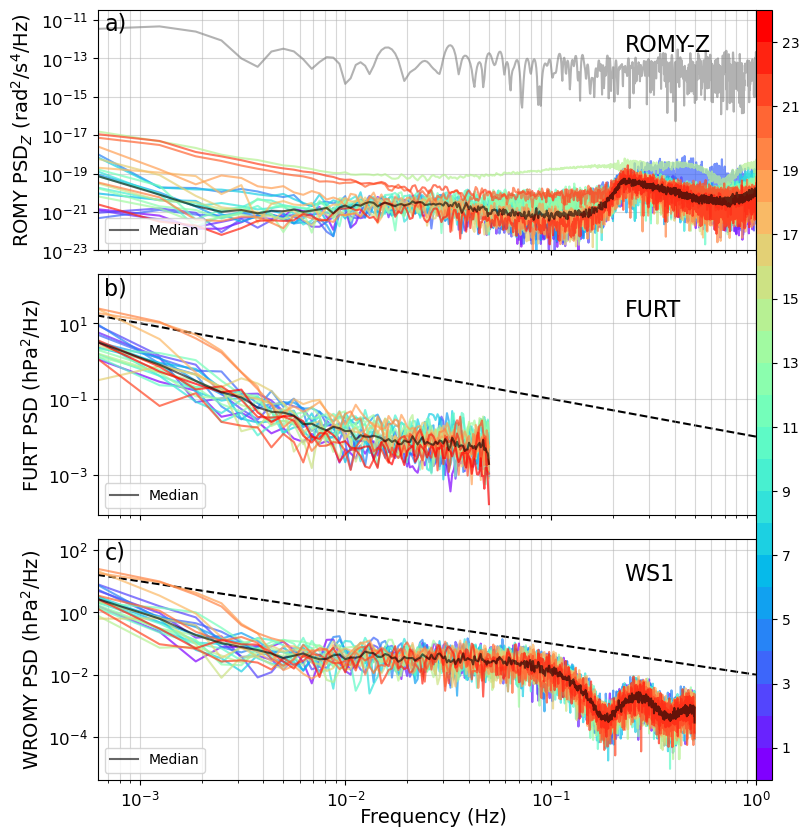

2023_WROMY_3600_20230429_hourly.pkl
 -> removed 4 rows due to mean thresholds!
 -> 20 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


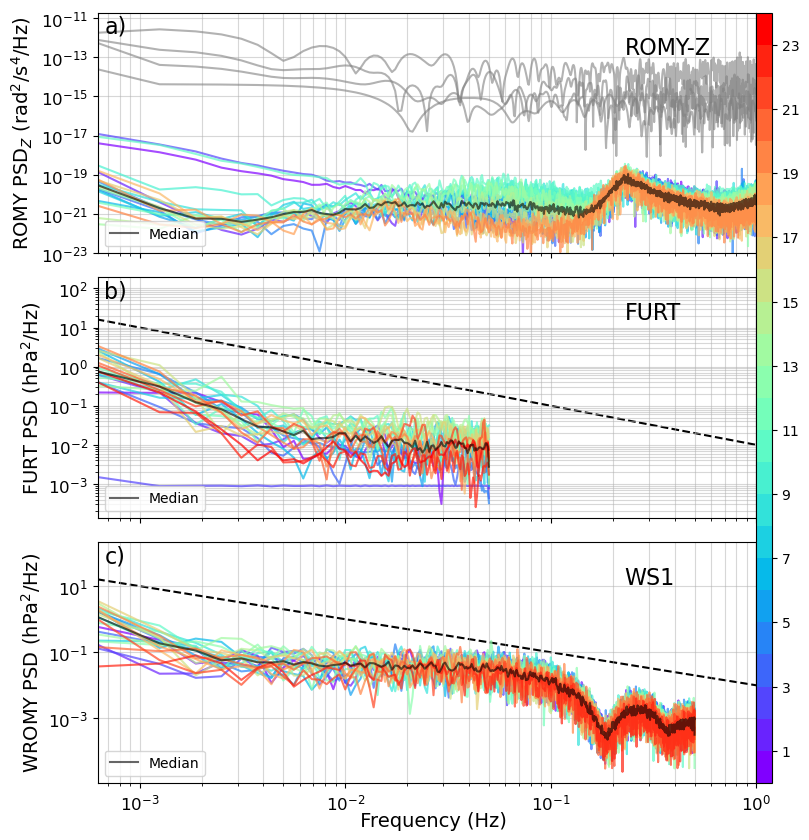

2023_WROMY_3600_20230430_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


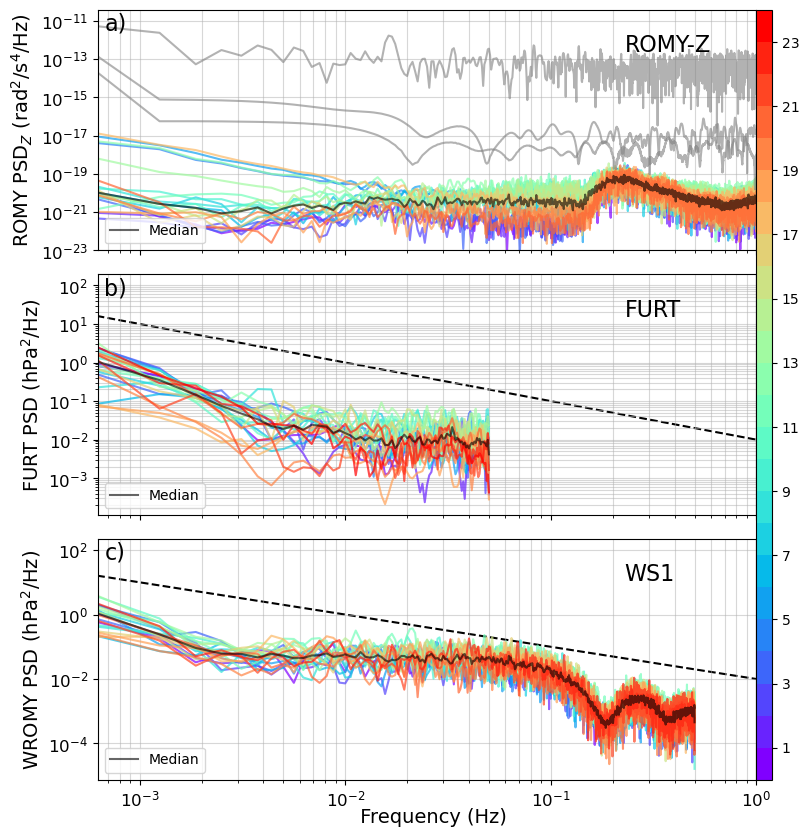

2023_WROMY_3600_20230501_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


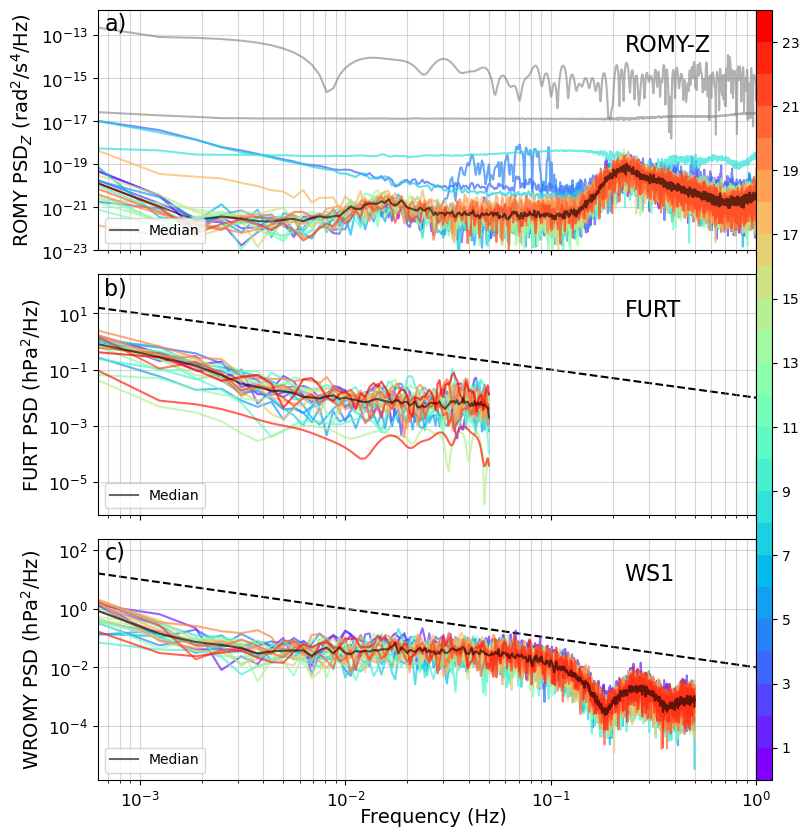

2023_WROMY_3600_20230502_hourly.pkl
 -> removed 9 rows due to mean thresholds!
 -> 15 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


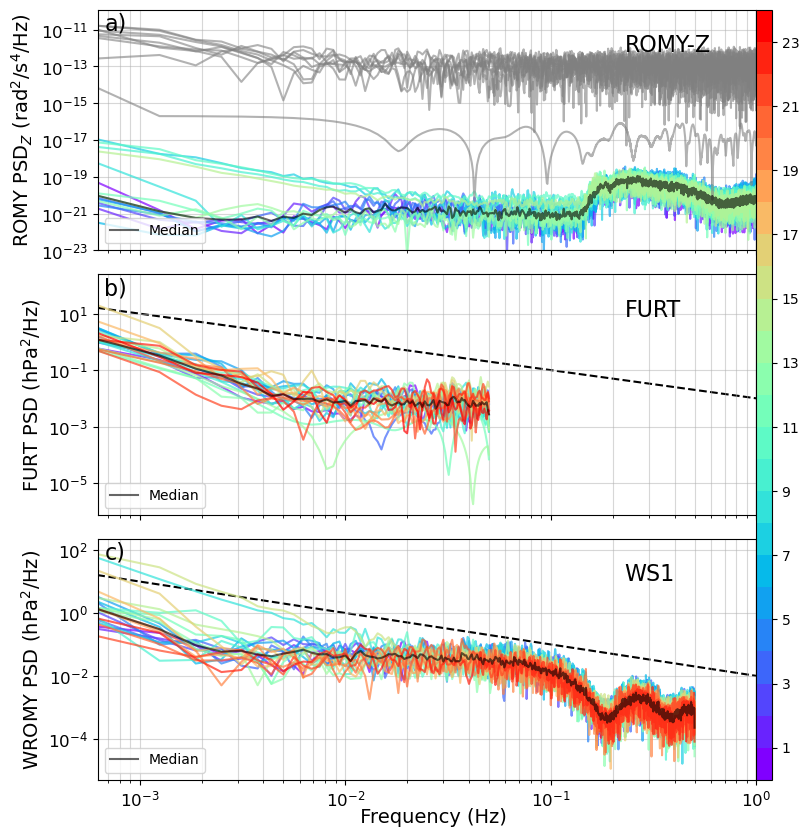

2023_WROMY_3600_20230503_hourly.pkl
 -> removed 11 rows due to mean thresholds!
 -> 13 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


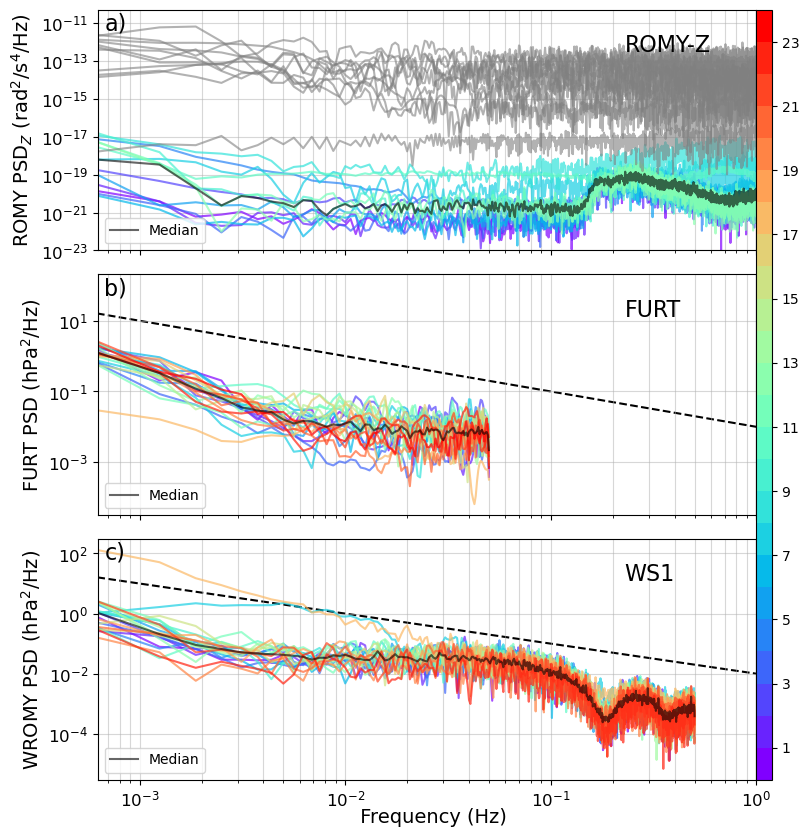

2023_WROMY_3600_20230504_hourly.pkl
 -> removed 7 rows due to mean thresholds!
 -> 17 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


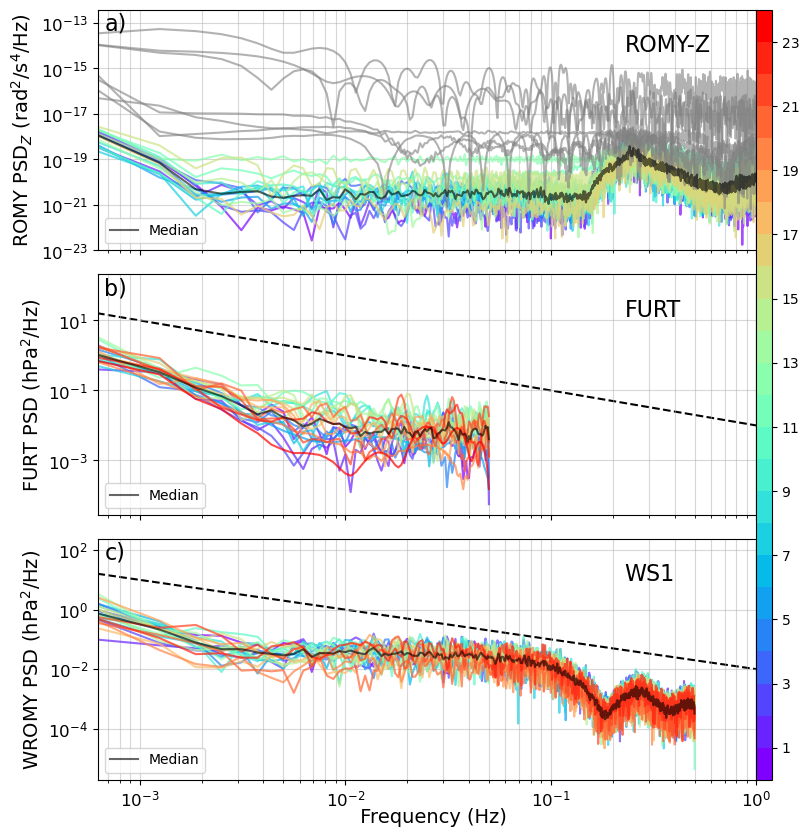

2023_WROMY_3600_20230505_hourly.pkl
 -> removed 21 rows due to mean thresholds!
 -> 3 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


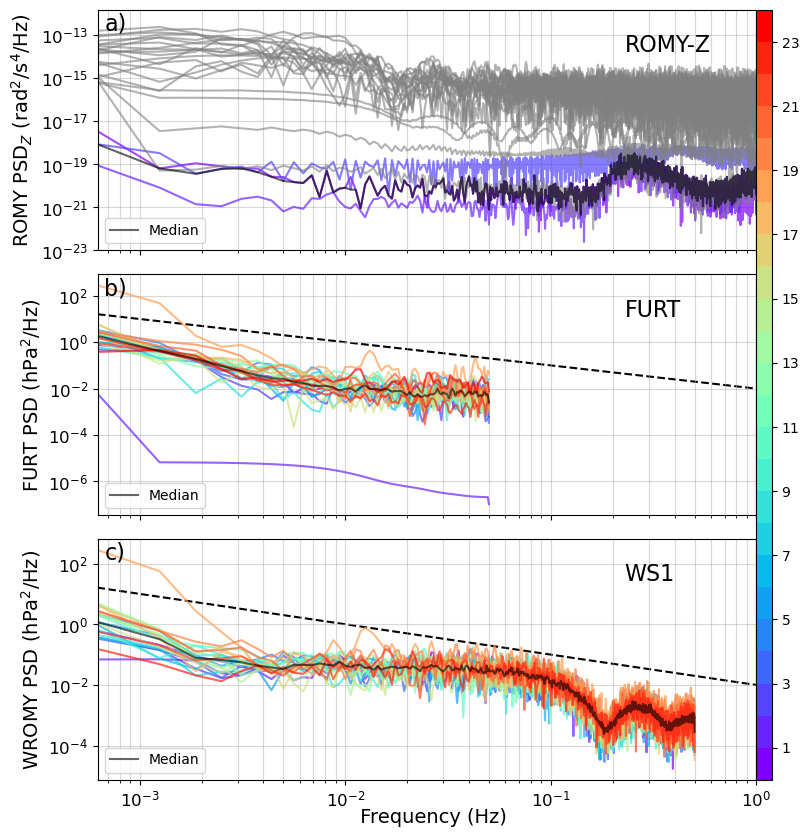

2023_WROMY_3600_20230506_hourly.pkl
 -> removed 20 rows due to mean thresholds!
 -> 4 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


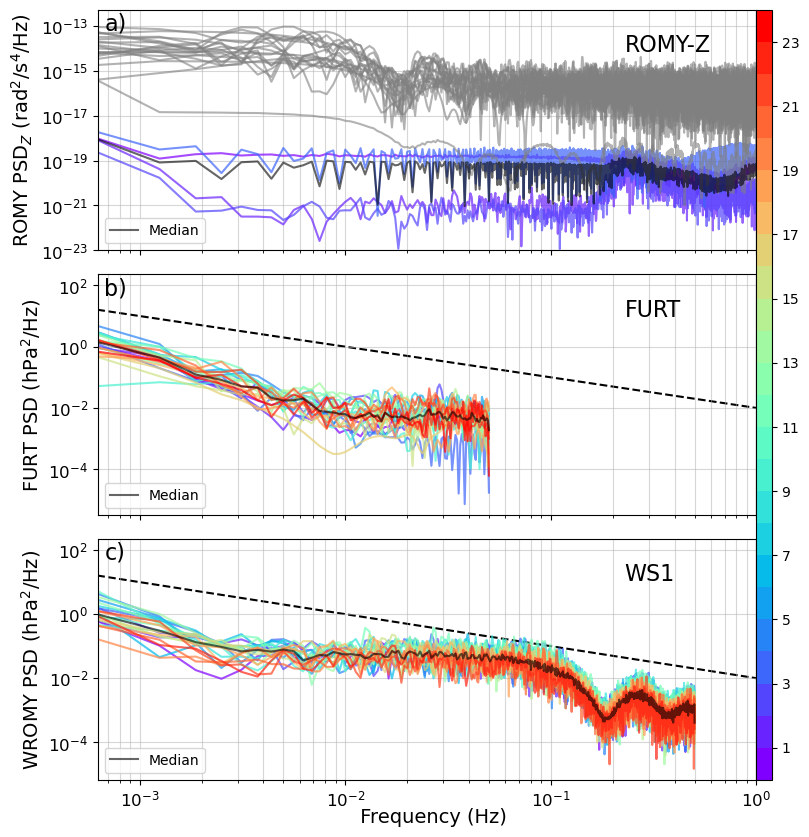

2023_WROMY_3600_20230507_hourly.pkl
 -> removed 22 rows due to mean thresholds!
 -> 2 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


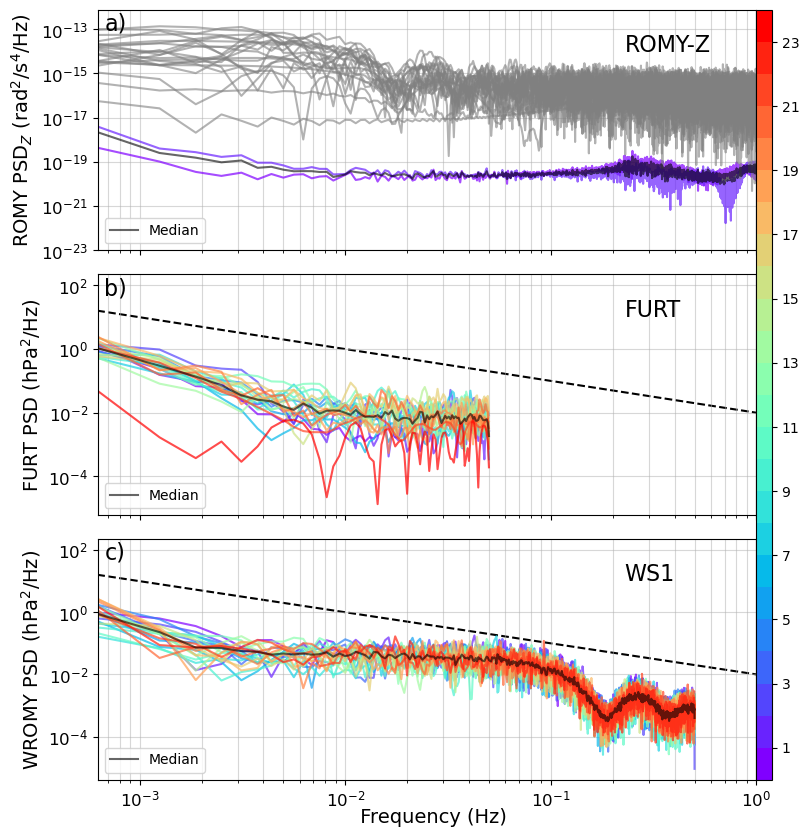

2023_WROMY_3600_20230508_hourly.pkl
2023_WROMY_3600_20230509_hourly.pkl
2023_WROMY_3600_20230510_hourly.pkl
2023_WROMY_3600_20230511_hourly.pkl
2023_WROMY_3600_20230512_hourly.pkl
2023_WROMY_3600_20230513_hourly.pkl
2023_WROMY_3600_20230514_hourly.pkl
2023_WROMY_3600_20230515_hourly.pkl
2023_WROMY_3600_20230516_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


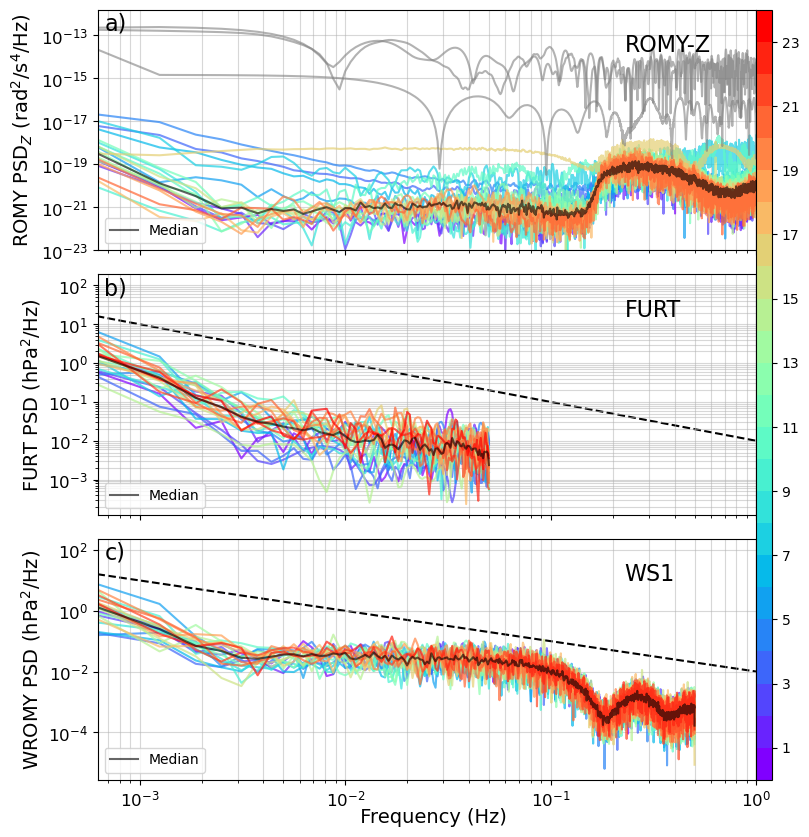

2023_WROMY_3600_20230517_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


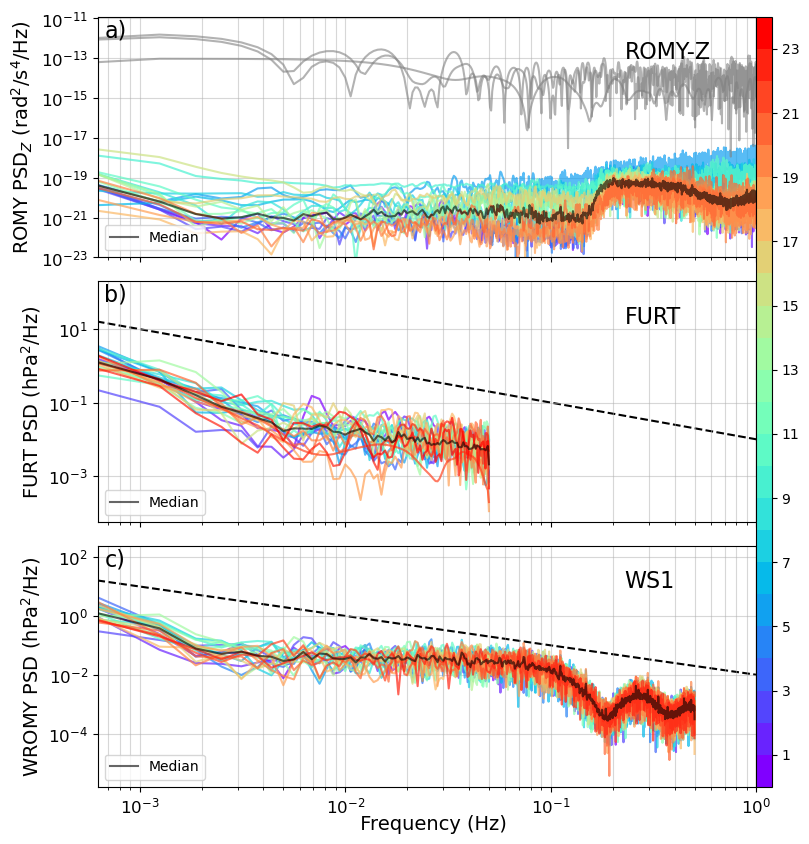

2023_WROMY_3600_20230518_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


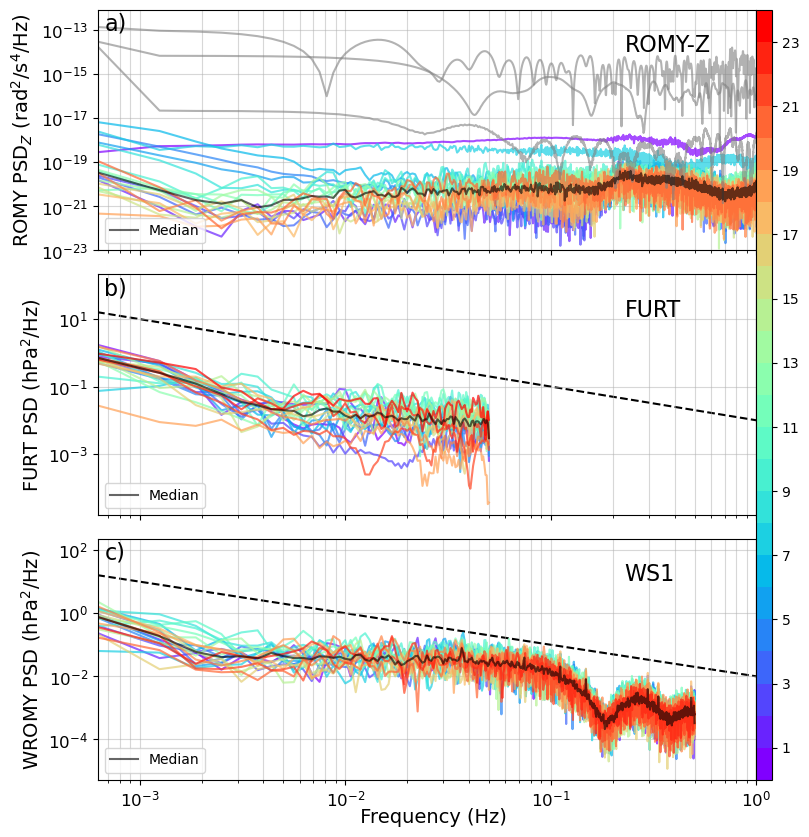

2023_WROMY_3600_20230519_hourly.pkl
 -> removed 5 rows due to mean thresholds!
 -> 19 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


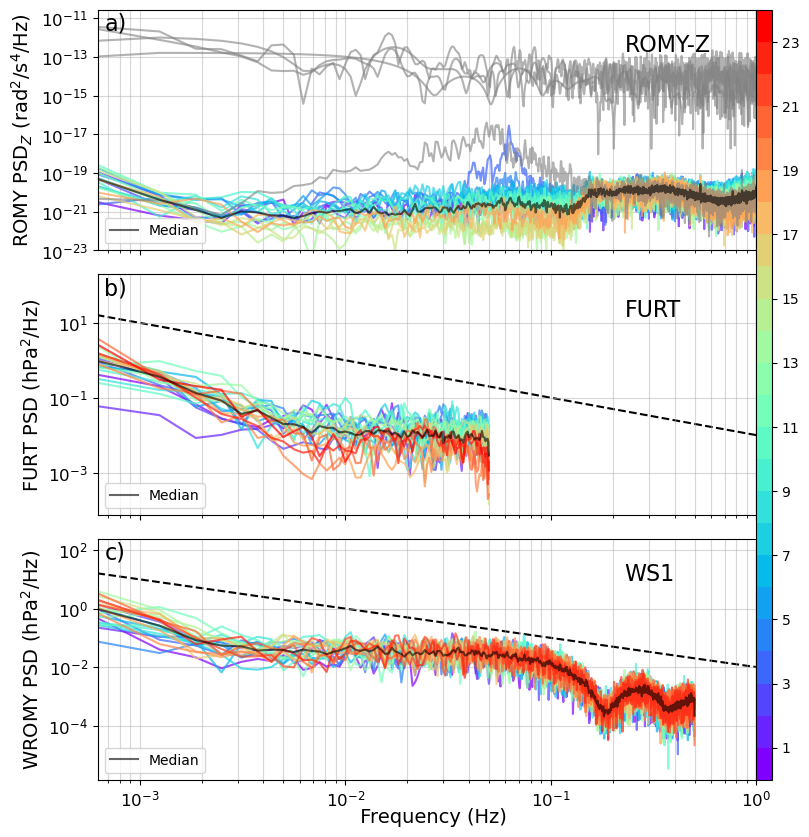

2023_WROMY_3600_20230520_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


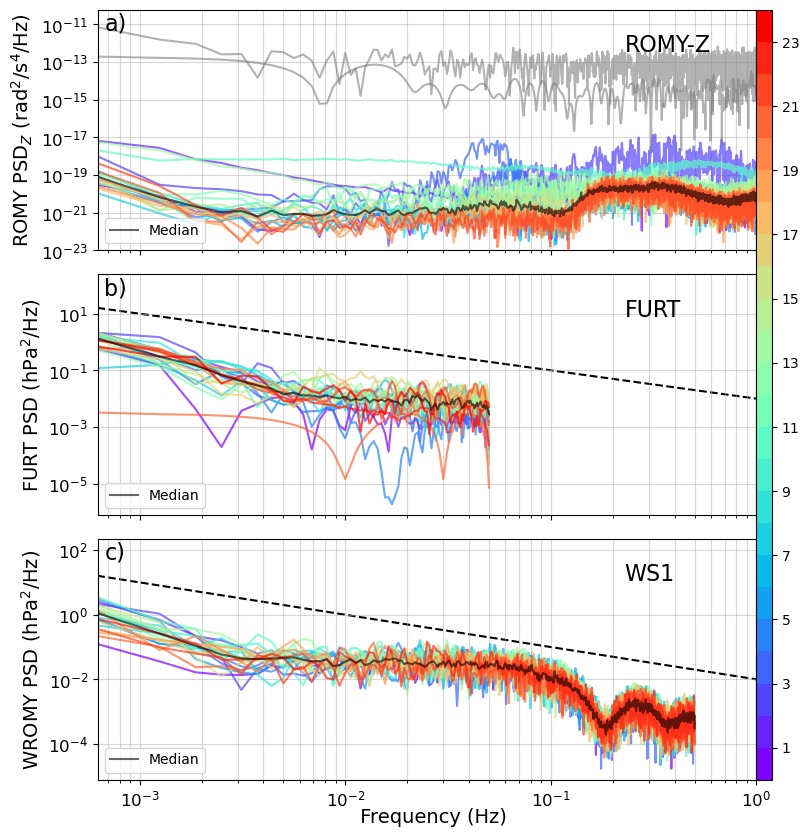

2023_WROMY_3600_20230521_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


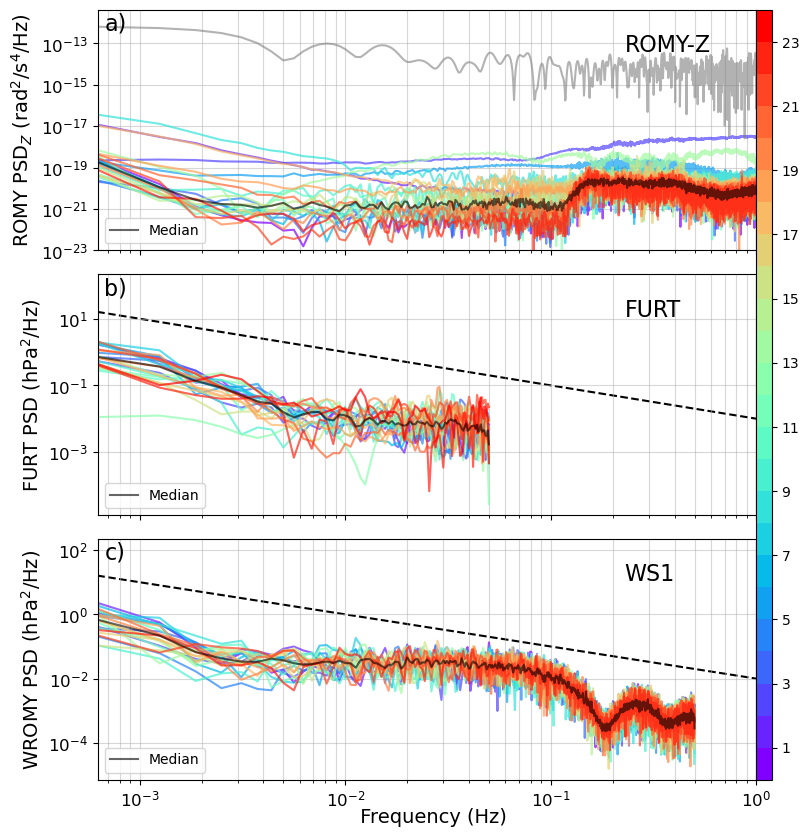

2023_WROMY_3600_20230522_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


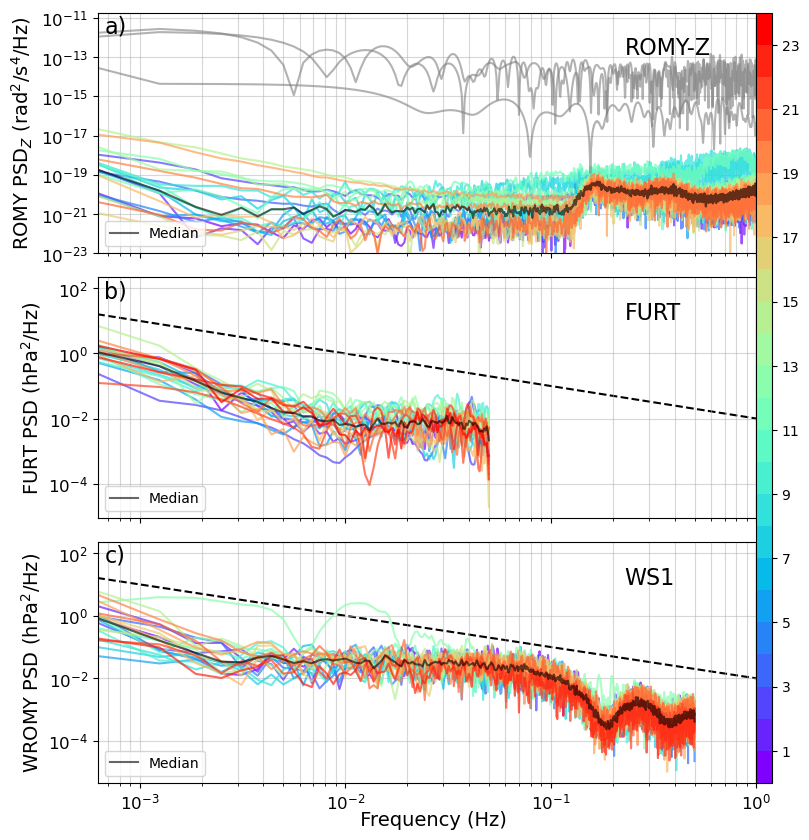

2023_WROMY_3600_20230523_hourly.pkl
 -> removed 7 rows due to mean thresholds!
 -> 17 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


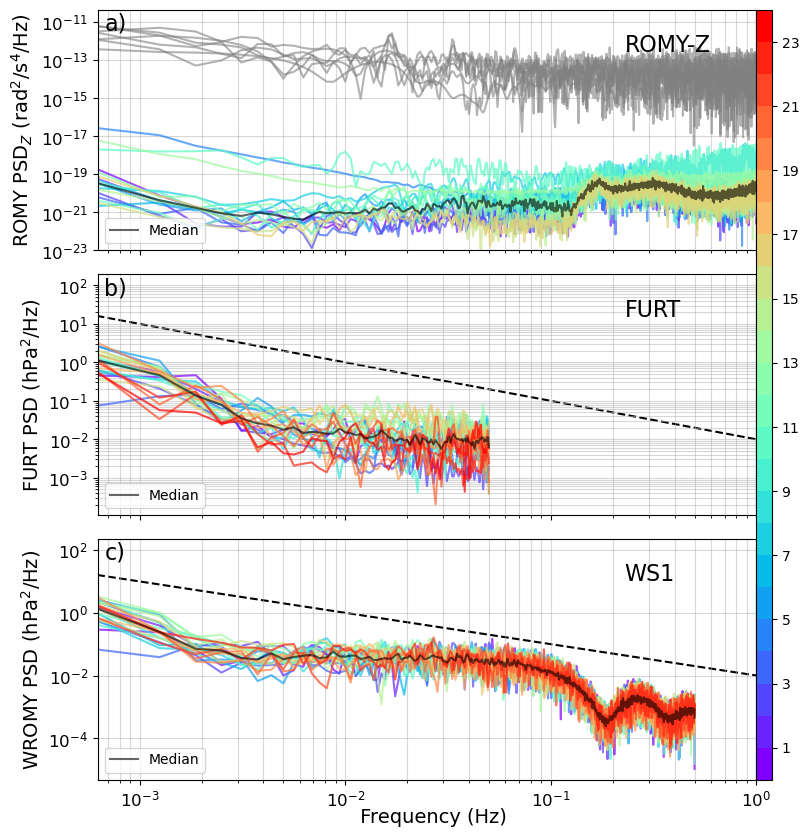

2023_WROMY_3600_20230524_hourly.pkl
 -> removed 22 rows due to mean thresholds!
 -> 2 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


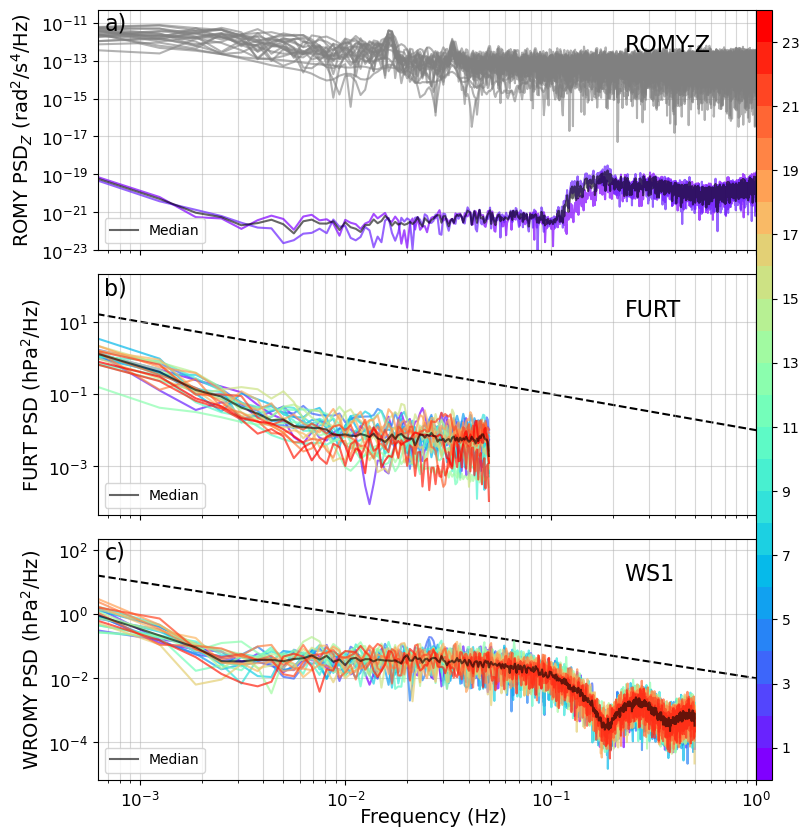

2023_WROMY_3600_20230525_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


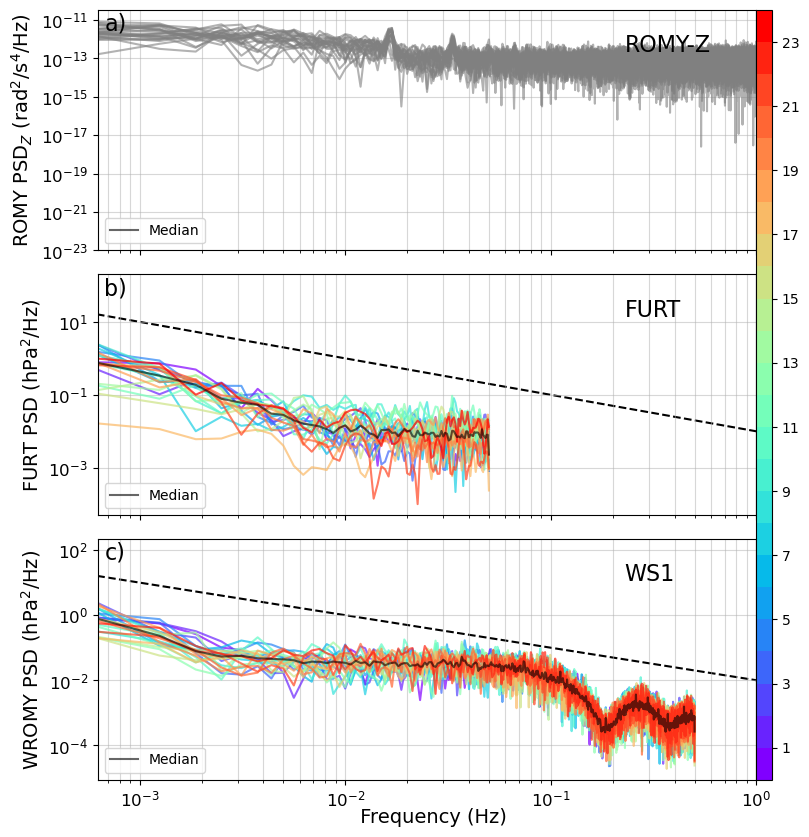

2023_WROMY_3600_20230526_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


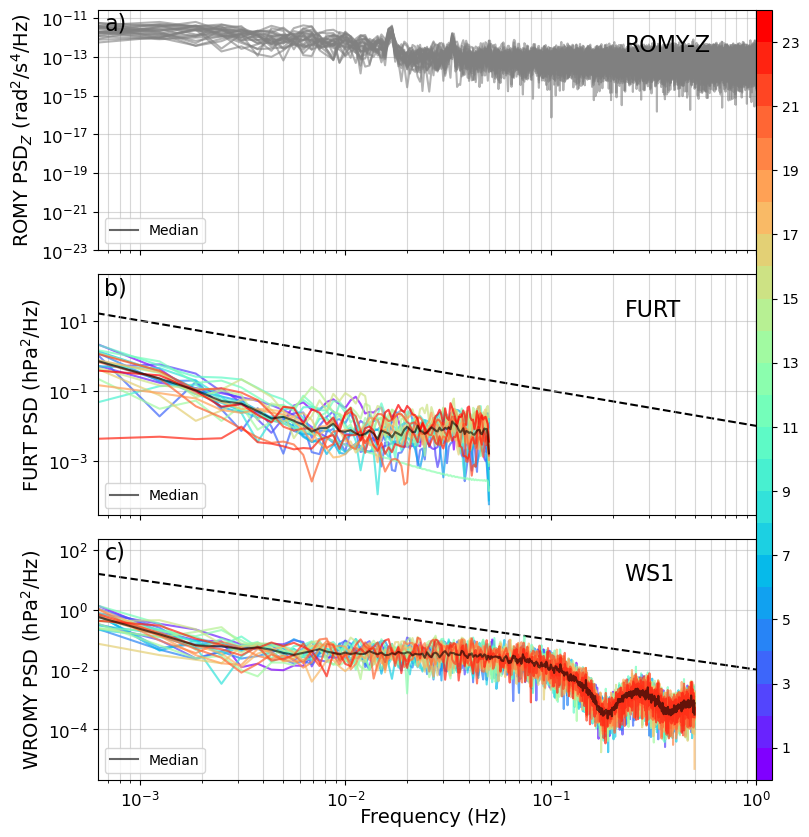

2023_WROMY_3600_20230527_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


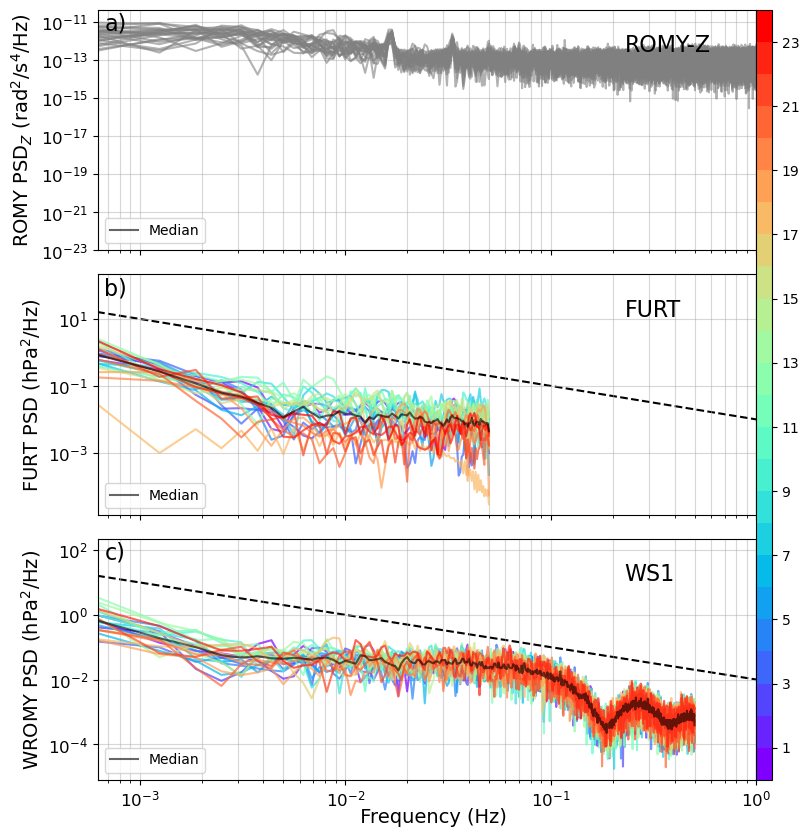

2023_WROMY_3600_20230528_hourly.pkl
2023_WROMY_3600_20230529_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


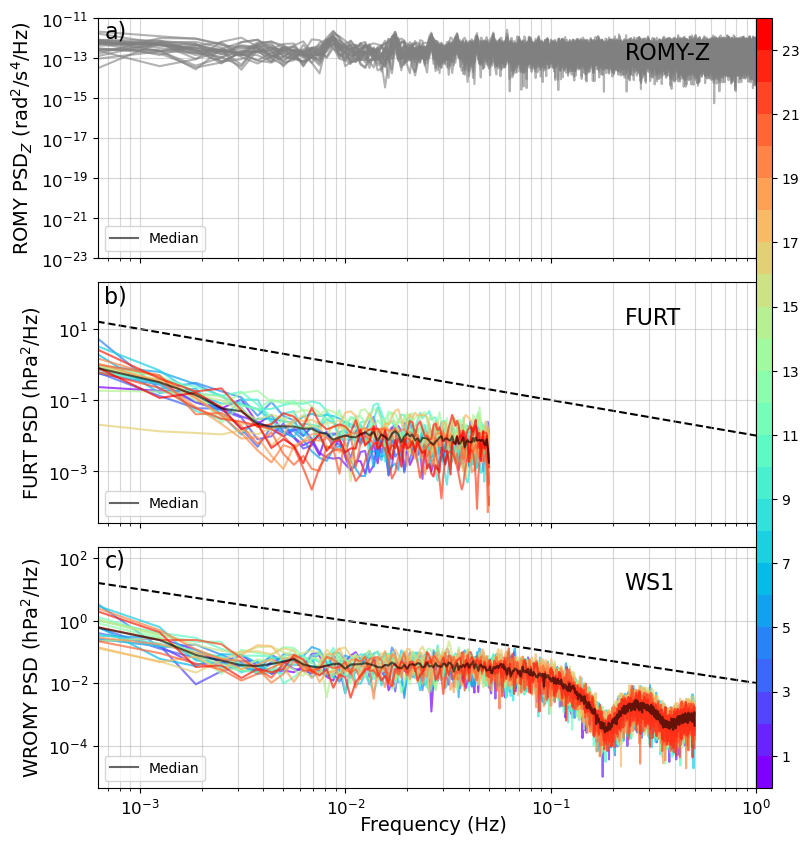

2023_WROMY_3600_20230530_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


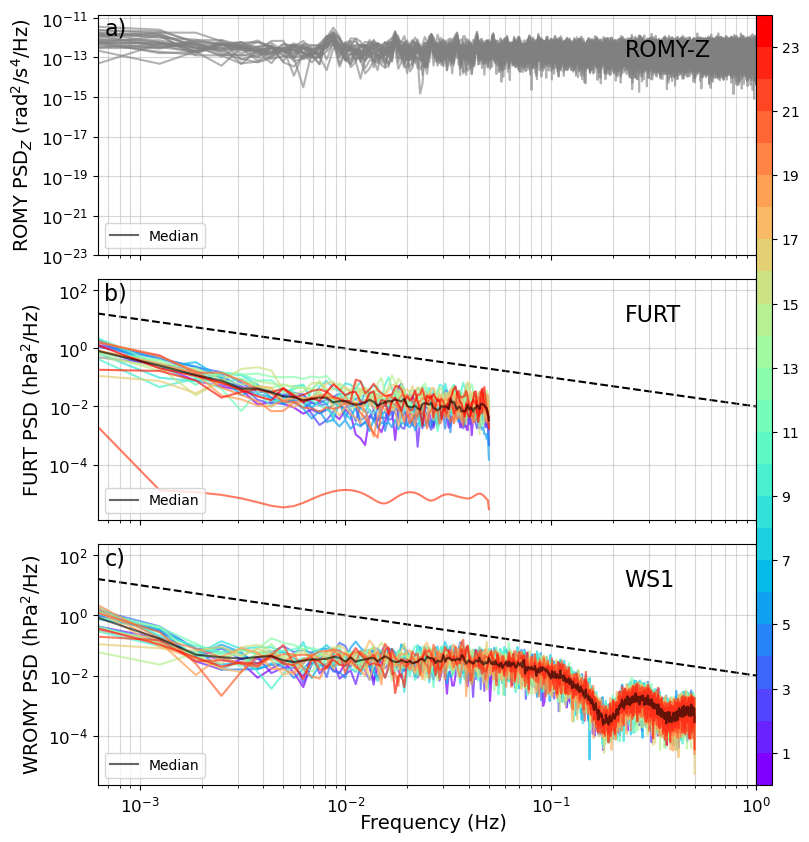

2023_WROMY_3600_20230531_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


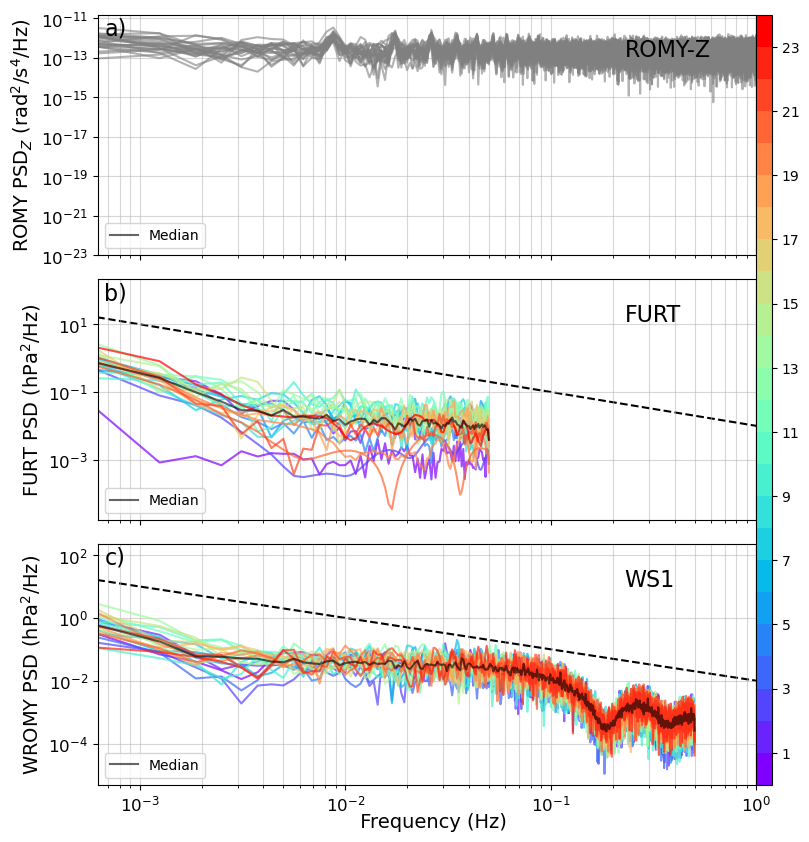

2023_WROMY_3600_20230601_hourly.pkl
2023_WROMY_3600_20230602_hourly.pkl
2023_WROMY_3600_20230603_hourly.pkl
 -> removed 4 rows due to mean thresholds!
 -> 20 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


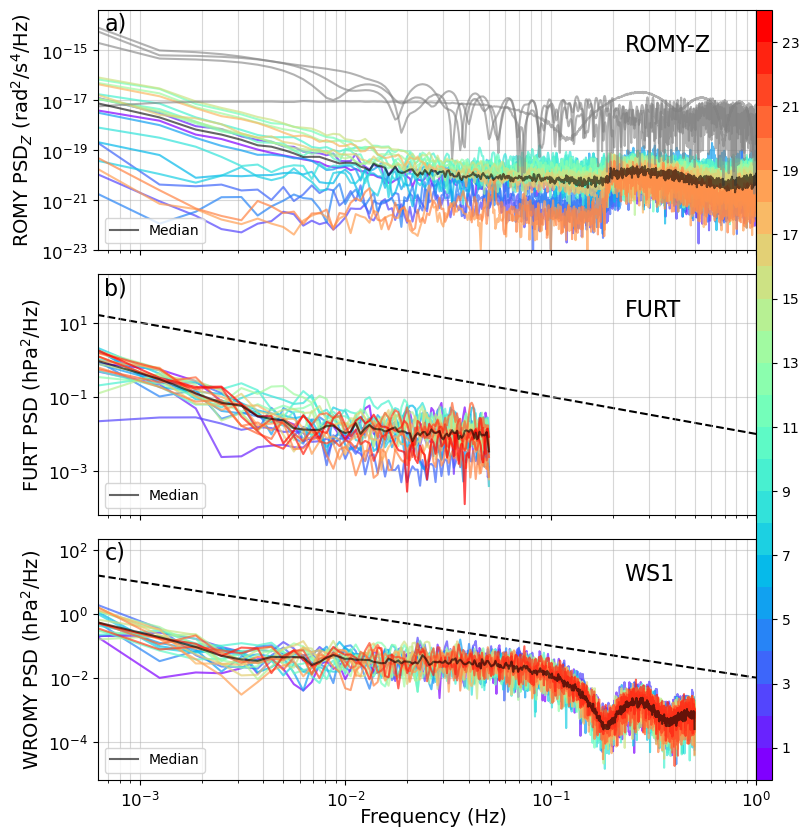

2023_WROMY_3600_20230604_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


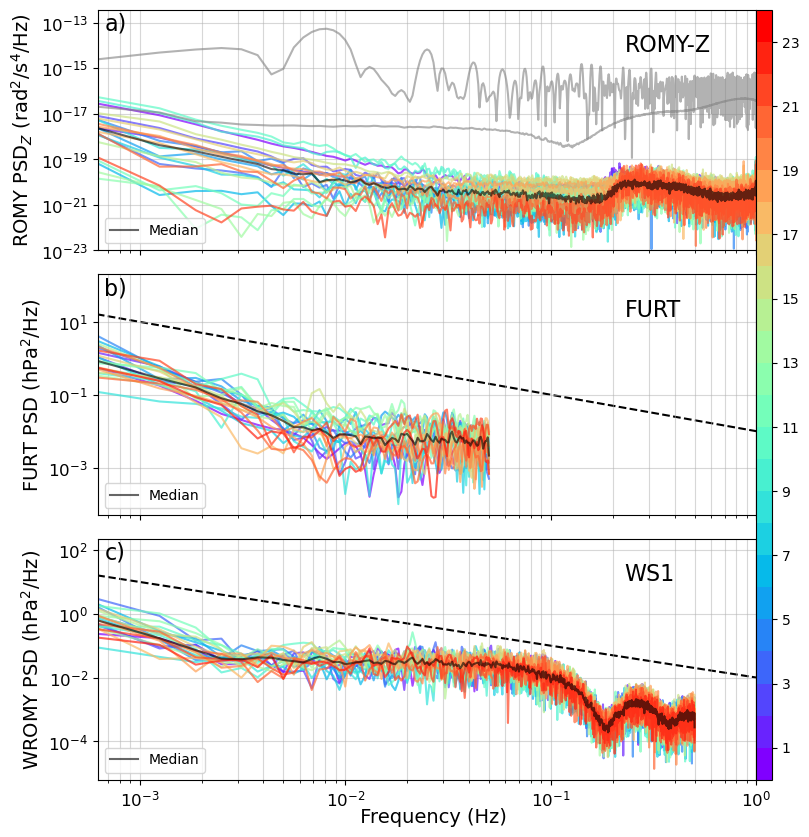

2023_WROMY_3600_20230605_hourly.pkl
2023_WROMY_3600_20230606_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


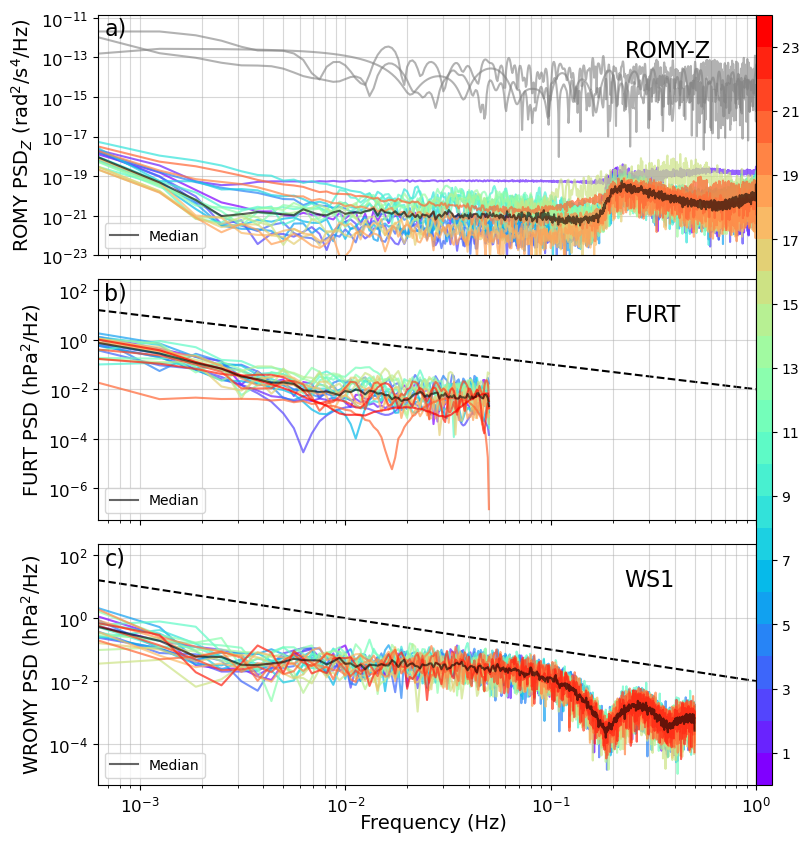

2023_WROMY_3600_20230607_hourly.pkl
2023_WROMY_3600_20230608_hourly.pkl
 -> removed 13 rows due to mean thresholds!
 -> 11 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


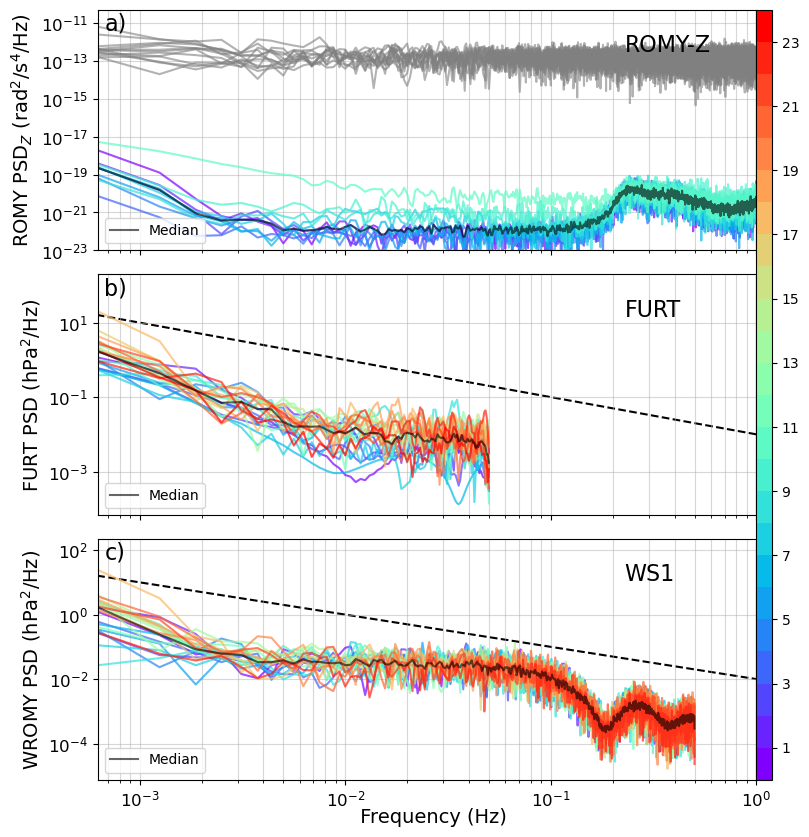

2023_WROMY_3600_20230609_hourly.pkl
2023_WROMY_3600_20230610_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


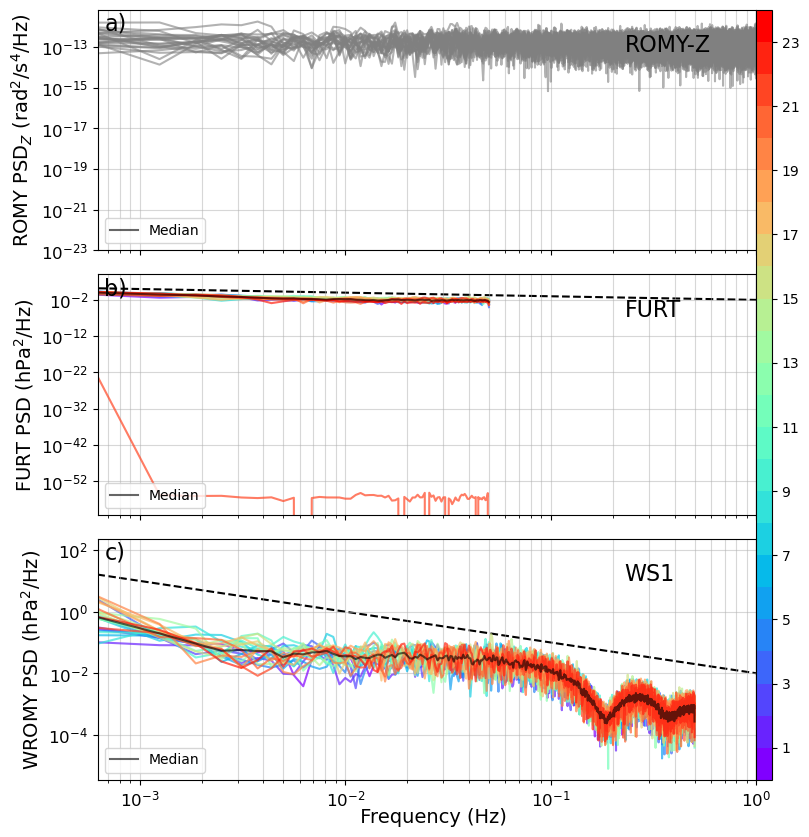

2023_WROMY_3600_20230611_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


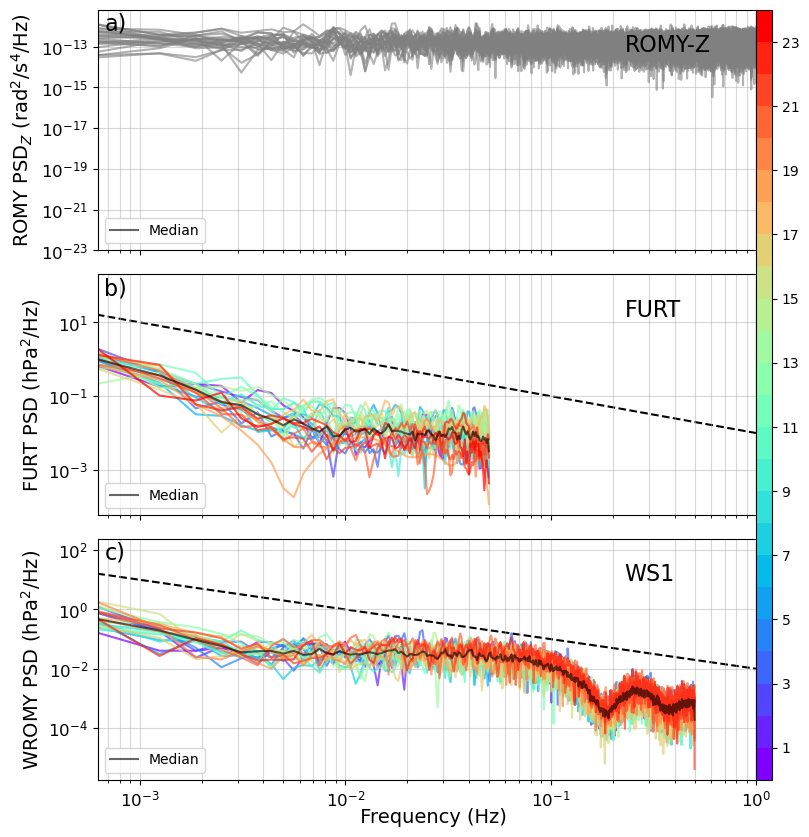

2023_WROMY_3600_20230612_hourly.pkl
2023_WROMY_3600_20230613_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


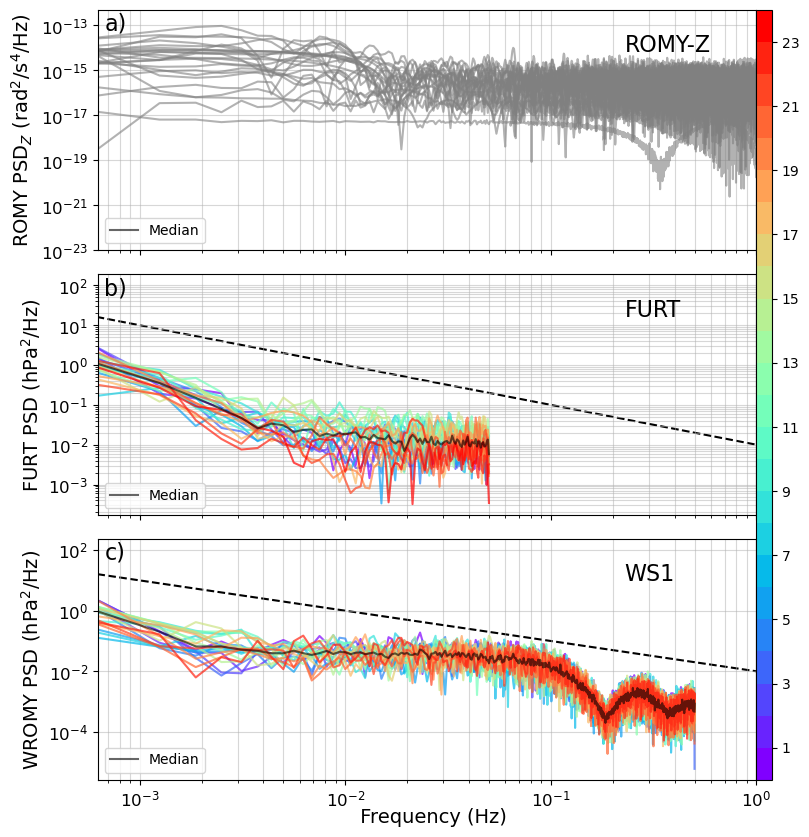

2023_WROMY_3600_20230614_hourly.pkl
 -> removed 23 rows due to mean thresholds!
 -> 1 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


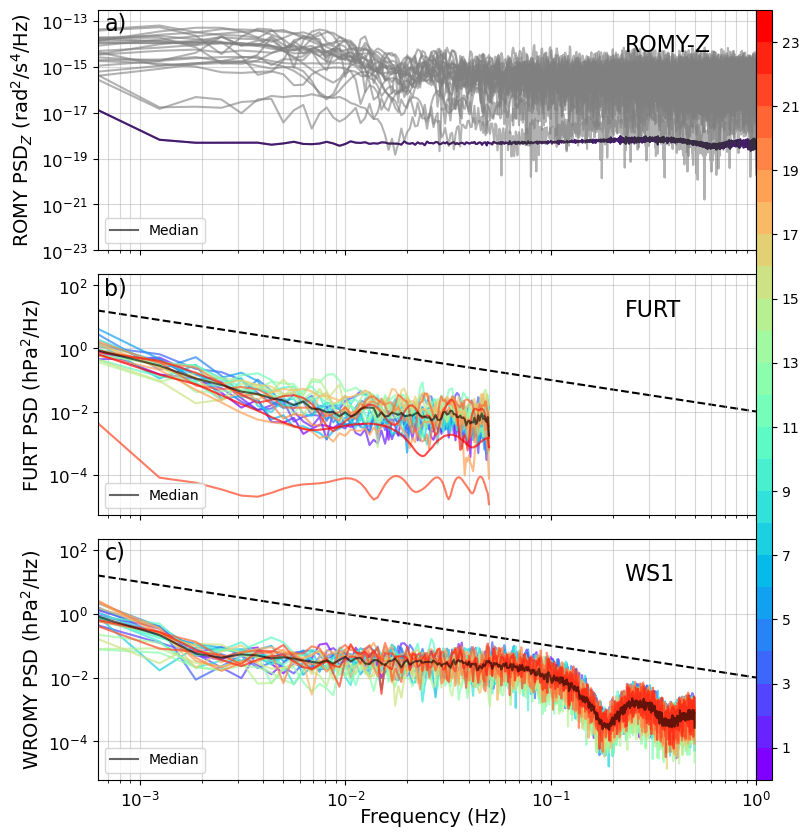

2023_WROMY_3600_20230615_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


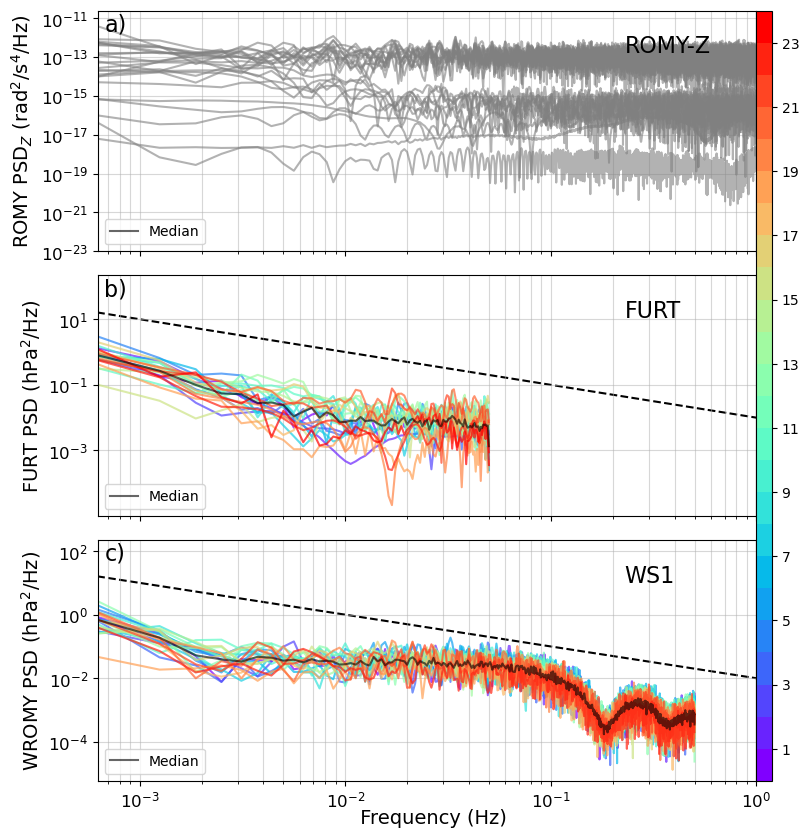

2023_WROMY_3600_20230616_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


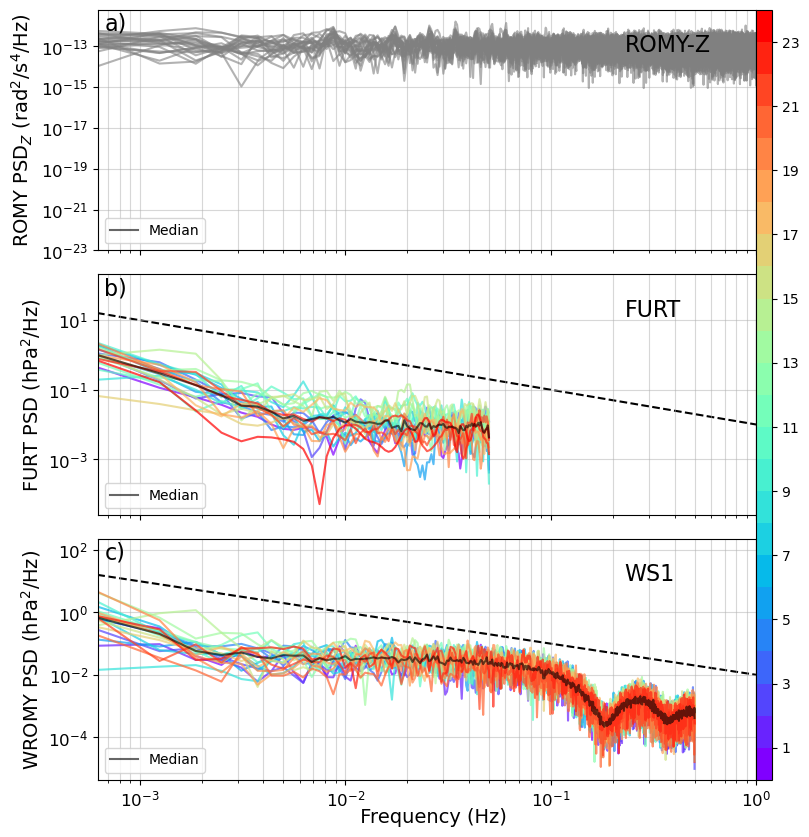

2023_WROMY_3600_20230617_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


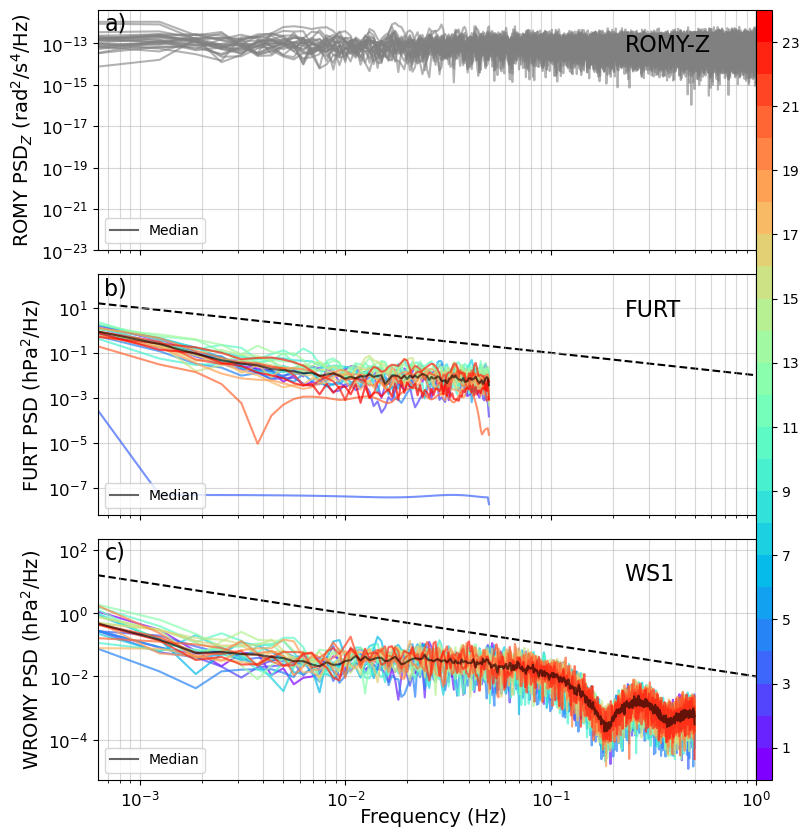

2023_WROMY_3600_20230618_hourly.pkl
 -> removed 24 rows due to mean thresholds!
 -> 0 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/brotzer/anaconda3/envs/obs2/lib/python3.9/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


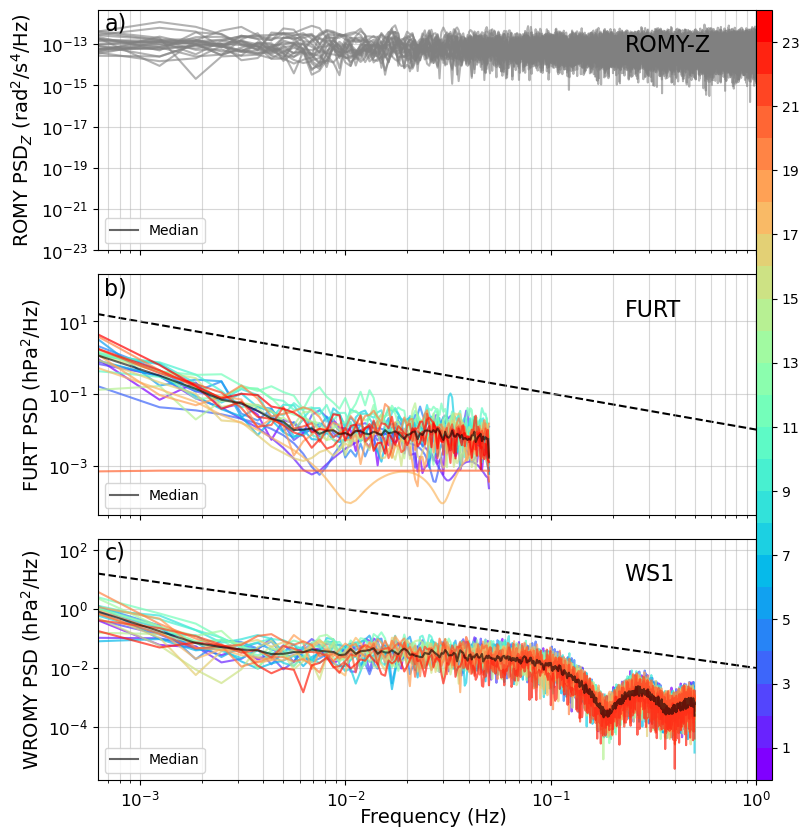

2023_WROMY_3600_20230619_hourly.pkl
 -> removed 17 rows due to mean thresholds!
 -> 7 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


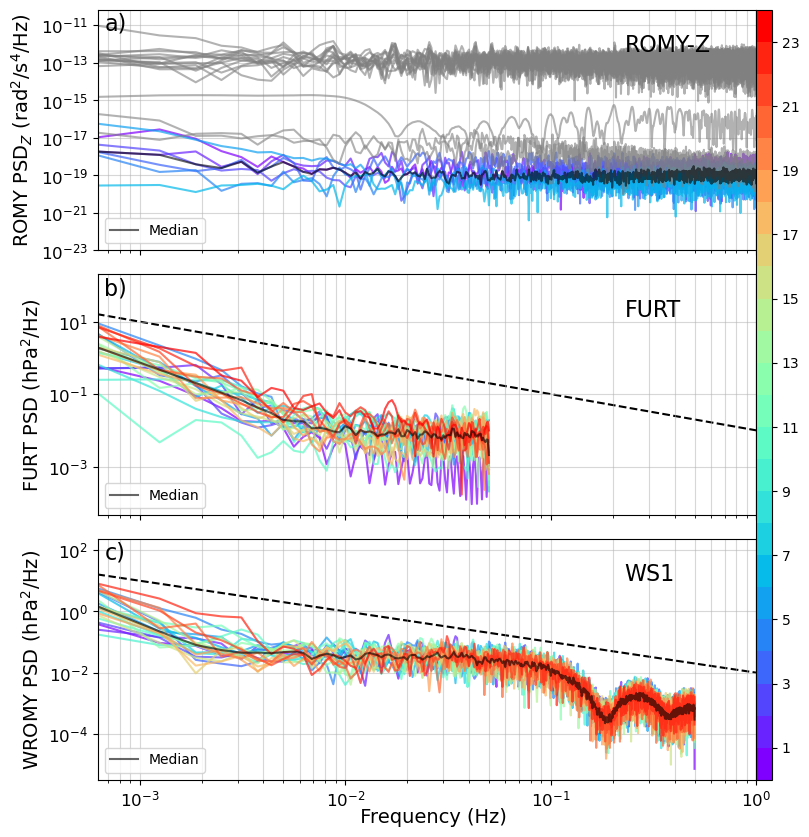

2023_WROMY_3600_20230620_hourly.pkl
 -> removed 6 rows due to mean thresholds!
 -> 18 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


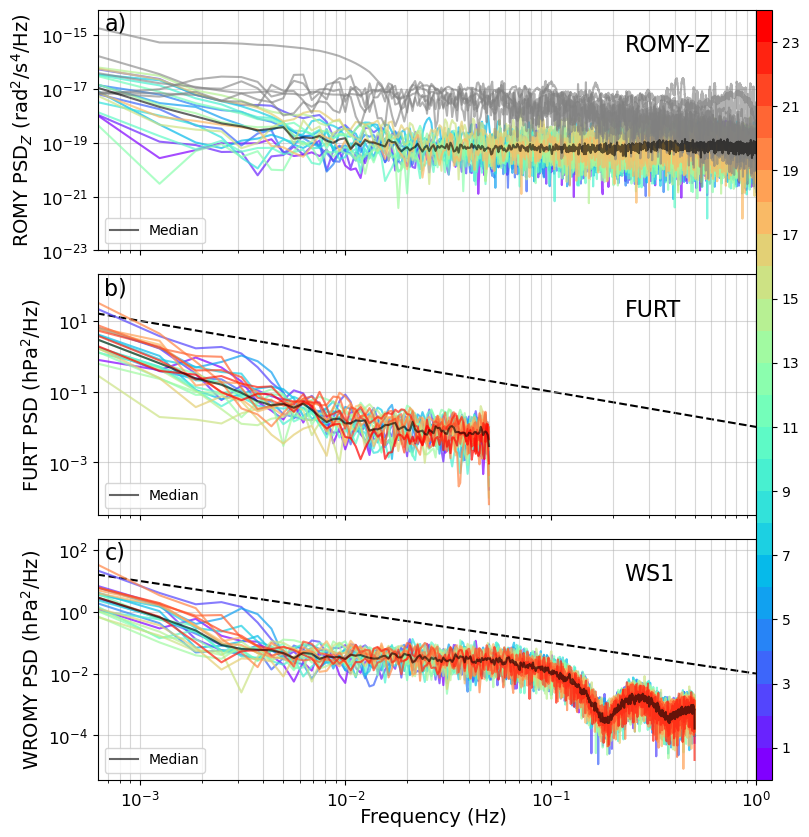

2023_WROMY_3600_20230621_hourly.pkl
2023_WROMY_3600_20230622_hourly.pkl
2023_WROMY_3600_20230623_hourly.pkl
2023_WROMY_3600_20230624_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


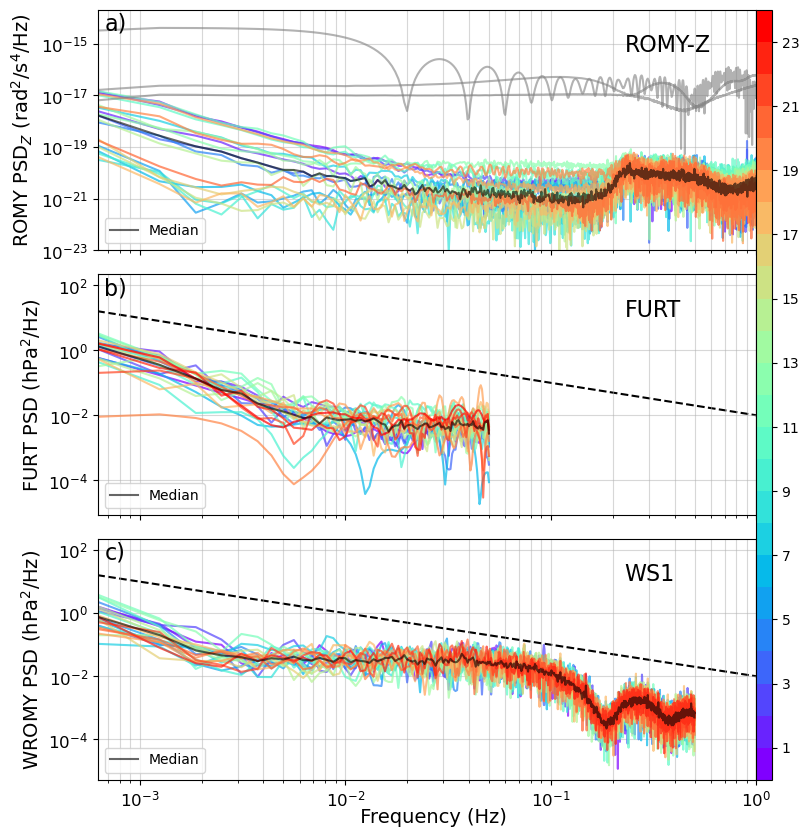

2023_WROMY_3600_20230625_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


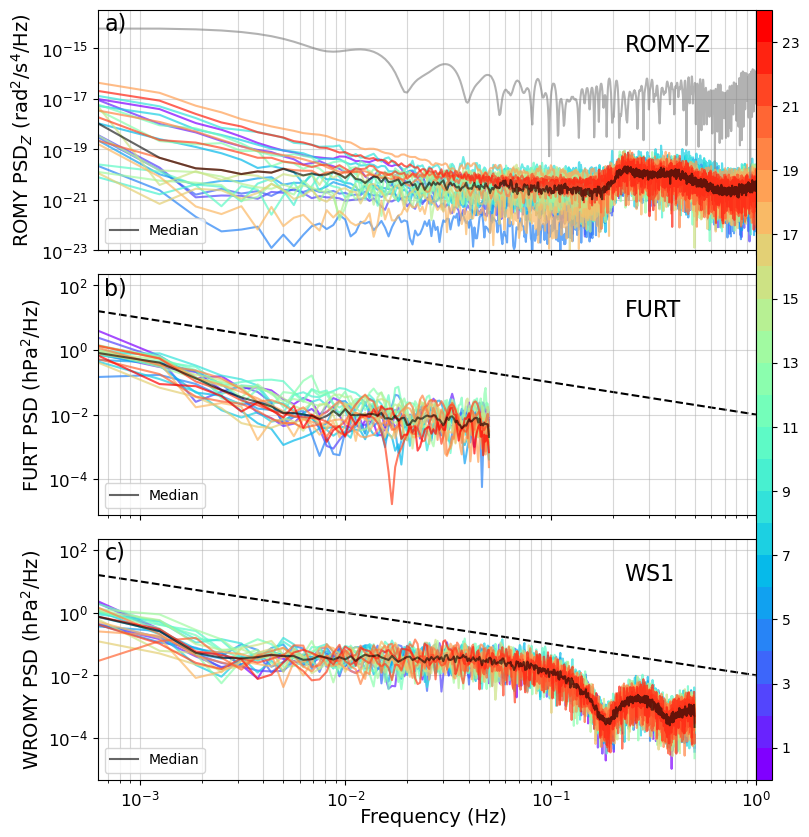

2023_WROMY_3600_20230626_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


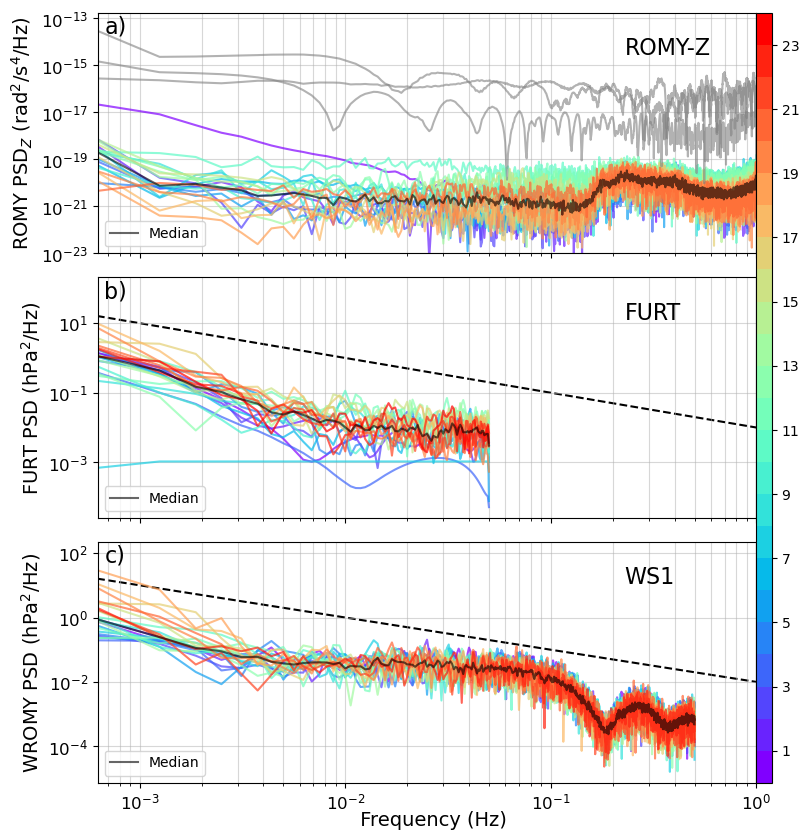

2023_WROMY_3600_20230627_hourly.pkl
2023_WROMY_3600_20230628_hourly.pkl
2023_WROMY_3600_20230629_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


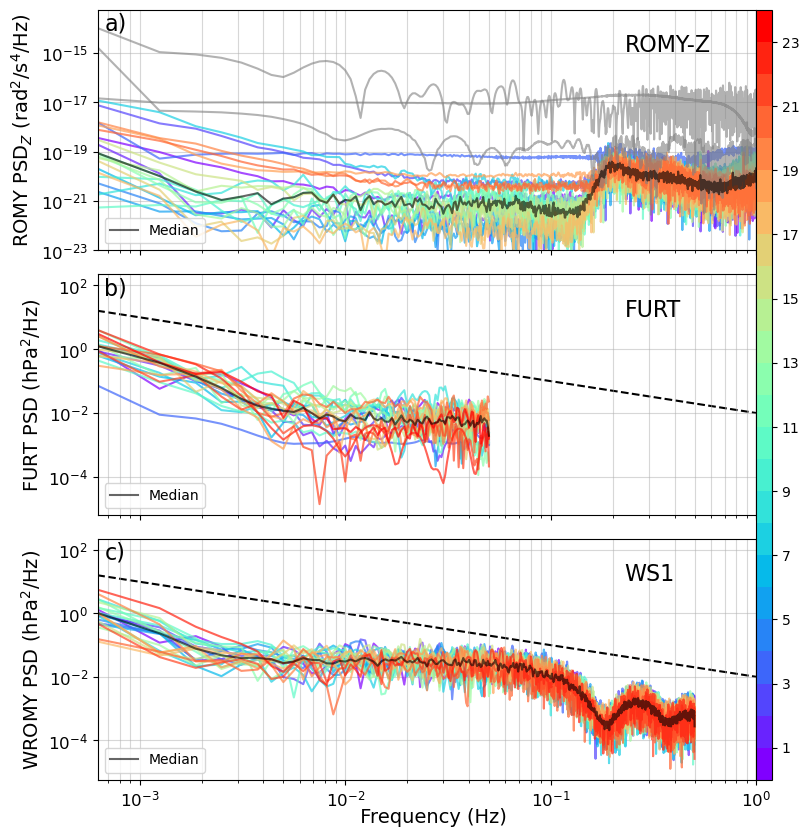

2023_WROMY_3600_20230630_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


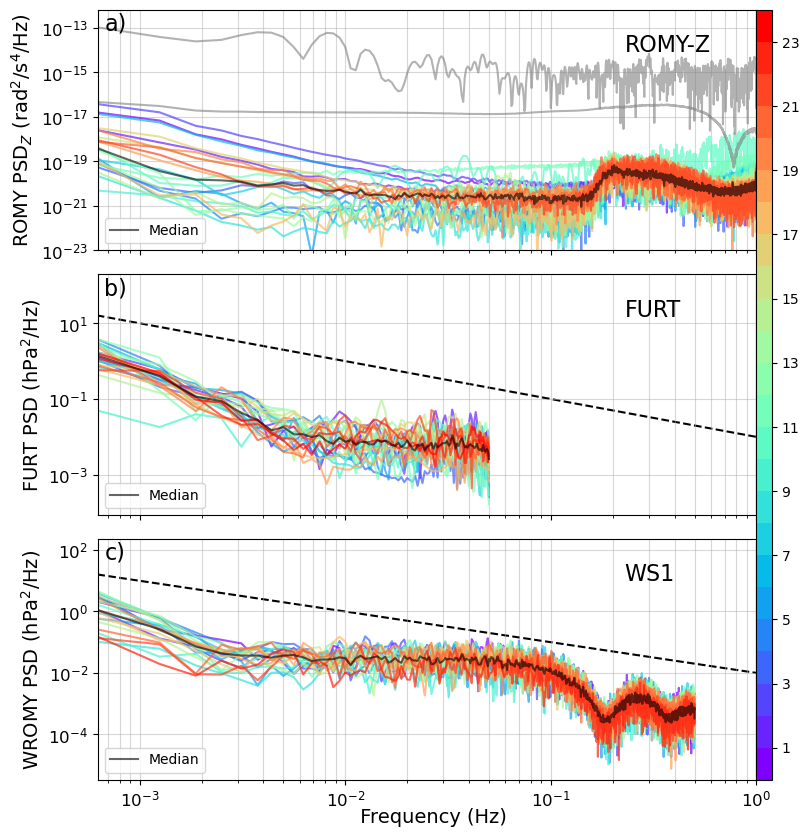

2023_WROMY_3600_20230701_hourly.pkl
 -> removed 4 rows due to mean thresholds!
 -> 20 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


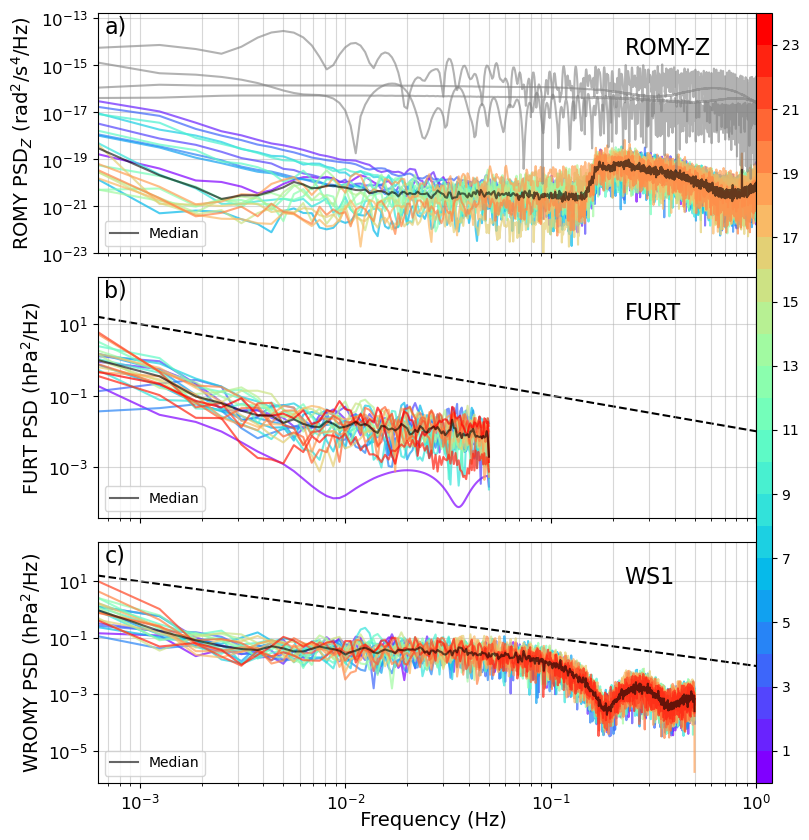

2023_WROMY_3600_20230702_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


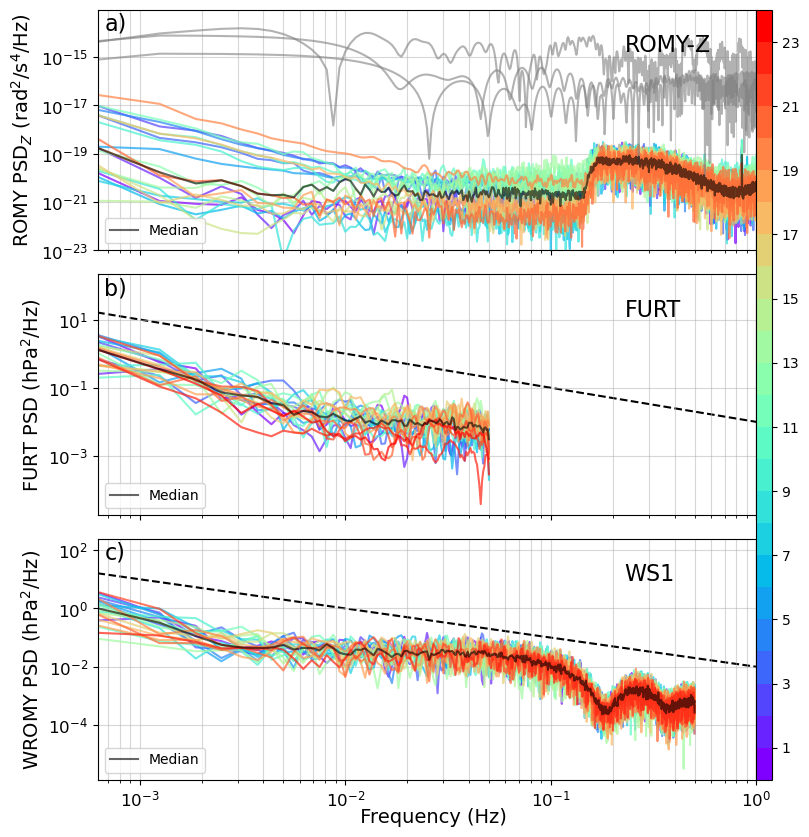

2023_WROMY_3600_20230703_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


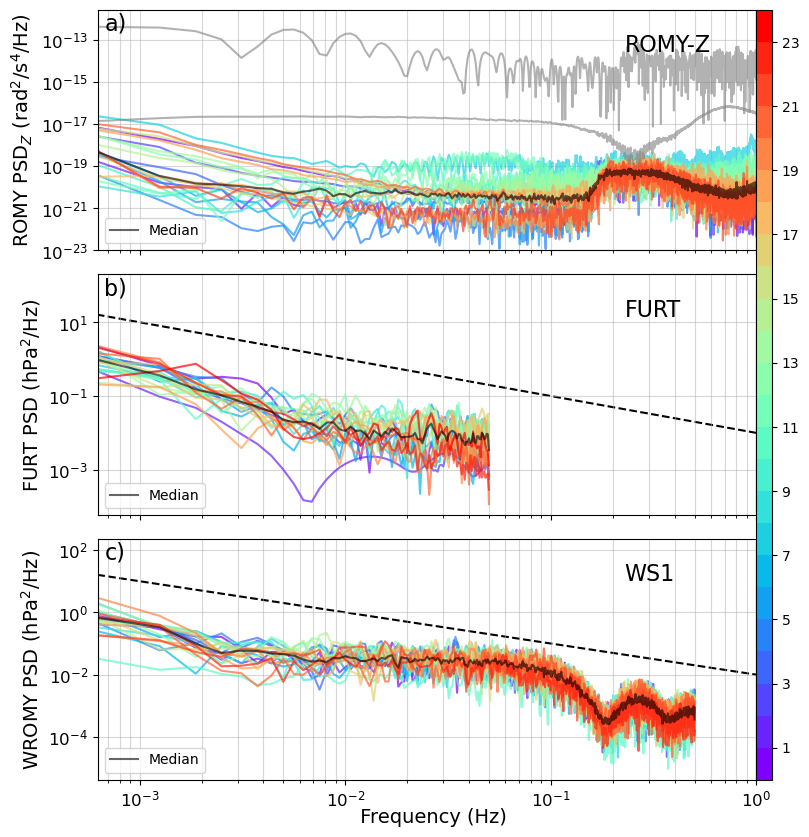

2023_WROMY_3600_20230704_hourly.pkl
 -> removed 4 rows due to mean thresholds!
 -> 20 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


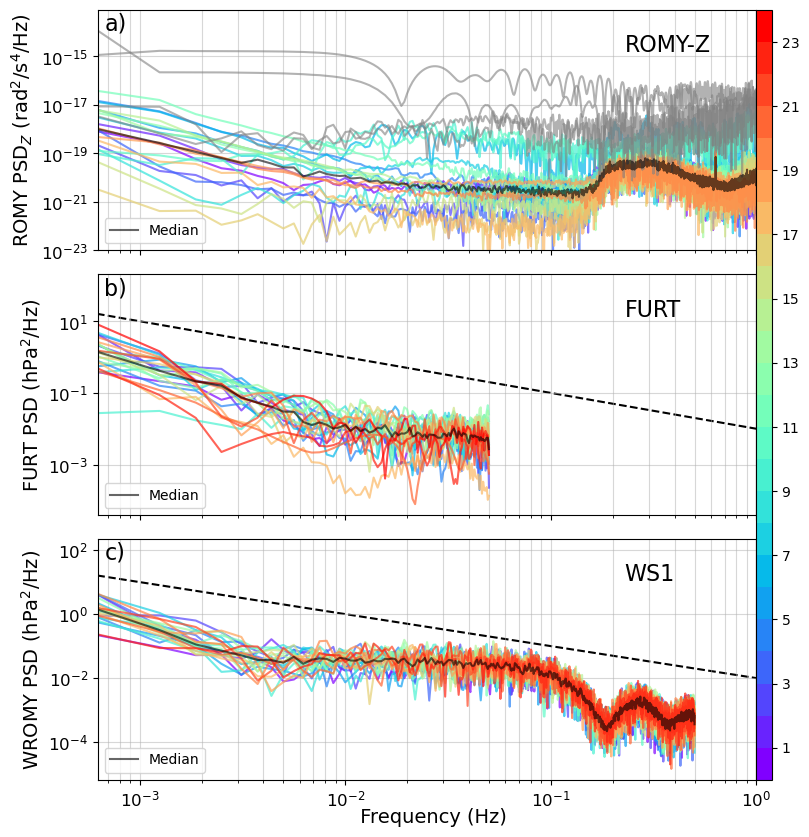

2023_WROMY_3600_20230705_hourly.pkl
 -> removed 5 rows due to mean thresholds!
 -> 19 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


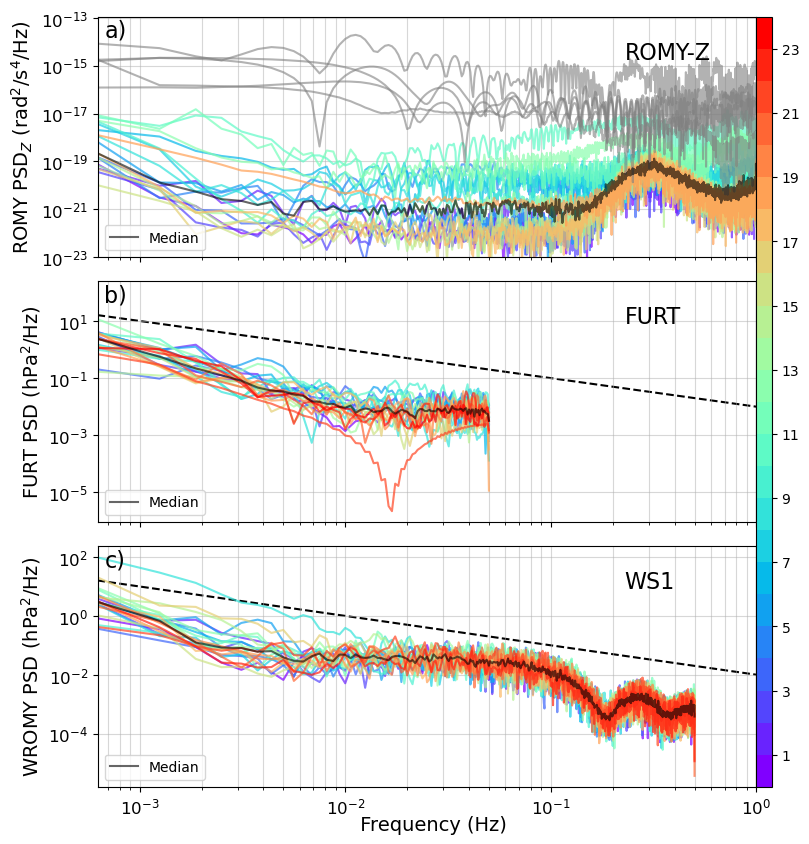

2023_WROMY_3600_20230706_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


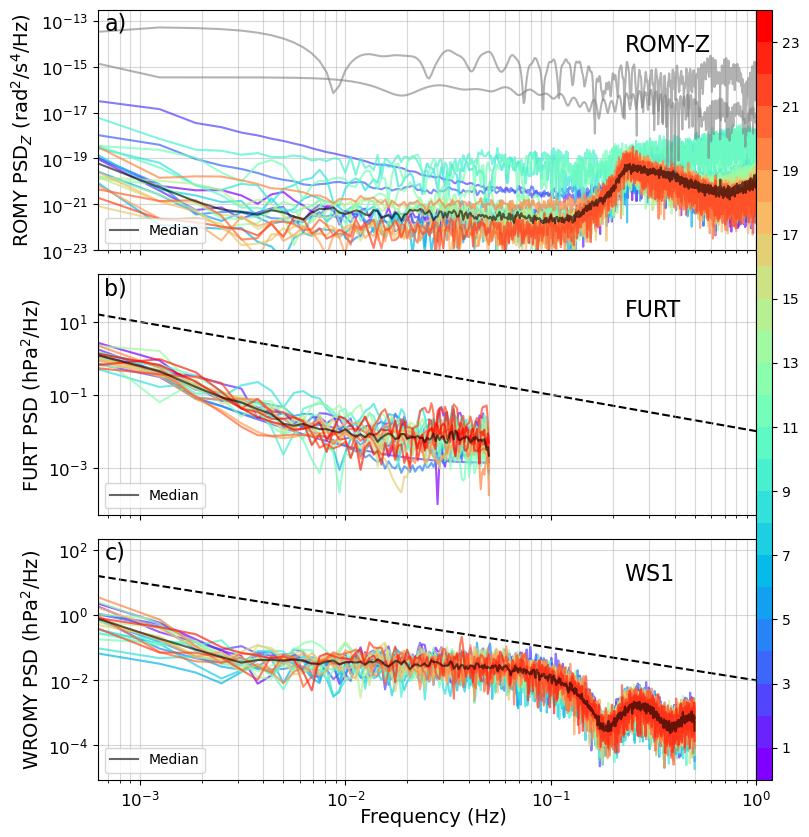

2023_WROMY_3600_20230707_hourly.pkl
 -> removed 6 rows due to mean thresholds!
 -> 18 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


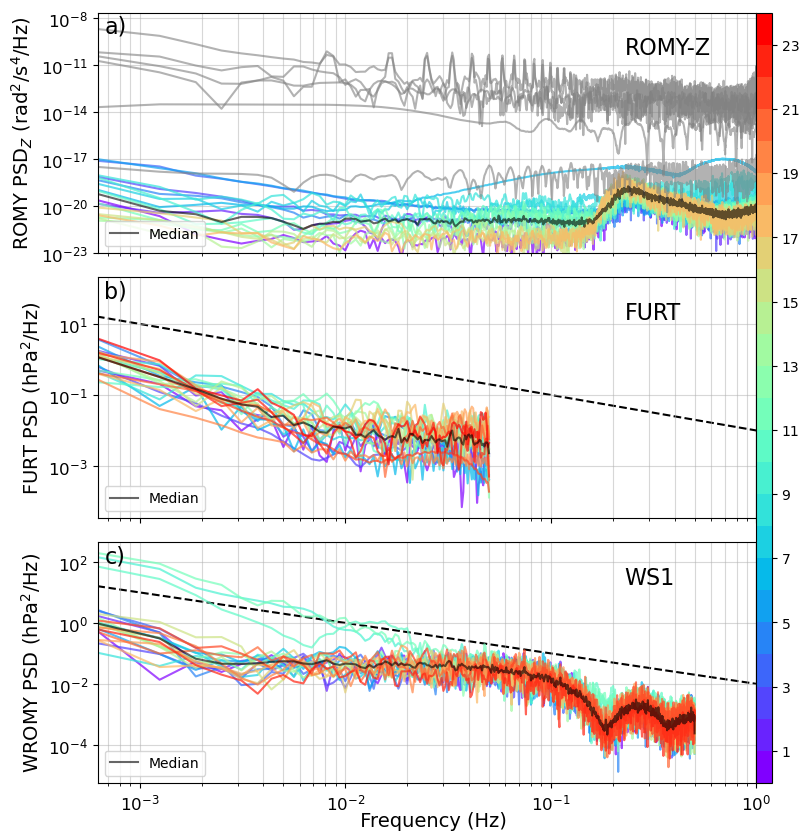

2023_WROMY_3600_20230708_hourly.pkl
 -> removed 12 rows due to mean thresholds!
 -> 12 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


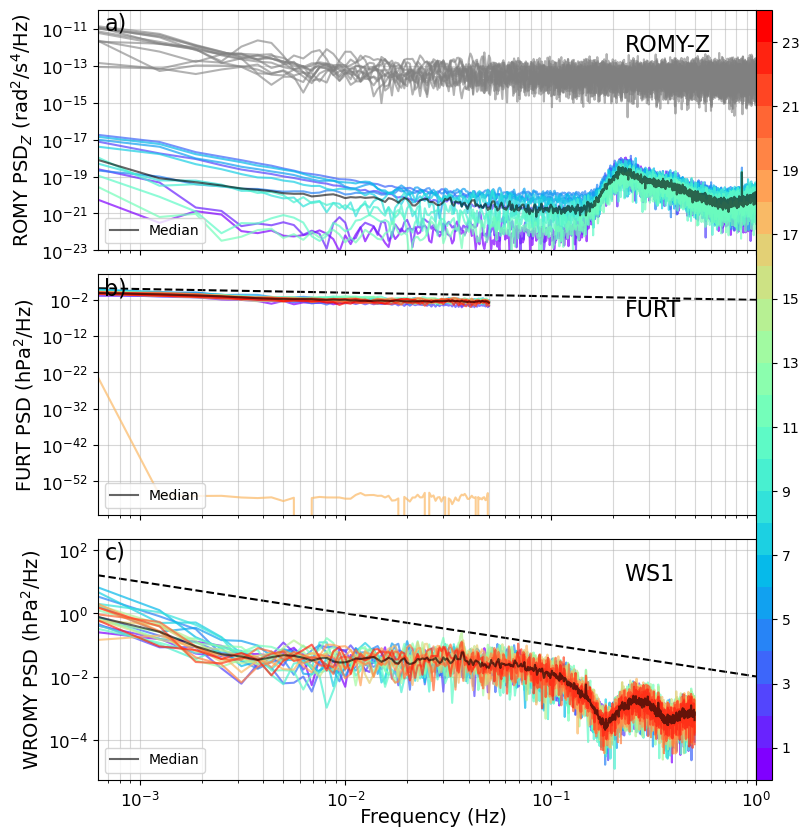

2023_WROMY_3600_20230709_hourly.pkl
 -> removed 10 rows due to mean thresholds!
 -> 14 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


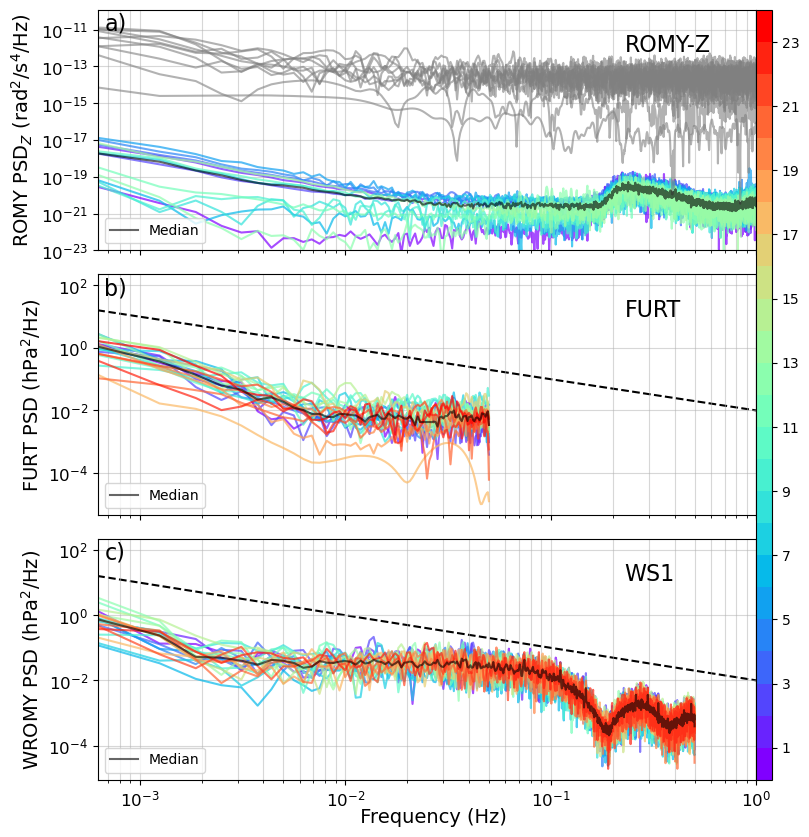

2023_WROMY_3600_20230710_hourly.pkl
 -> removed 15 rows due to mean thresholds!
 -> 9 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


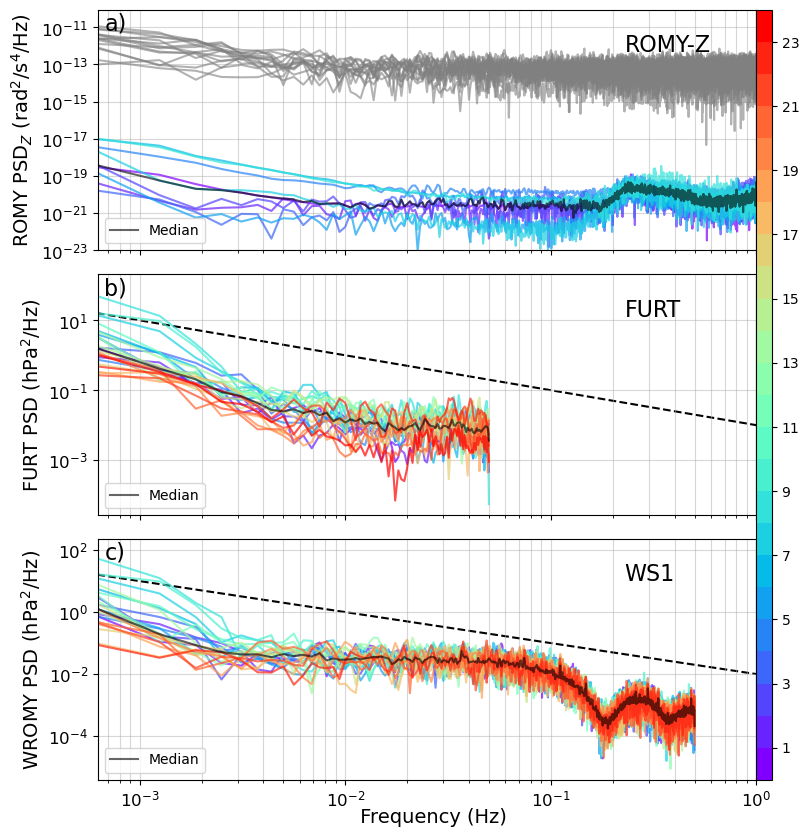

2023_WROMY_3600_20230711_hourly.pkl
 -> removed 18 rows due to mean thresholds!
 -> 6 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


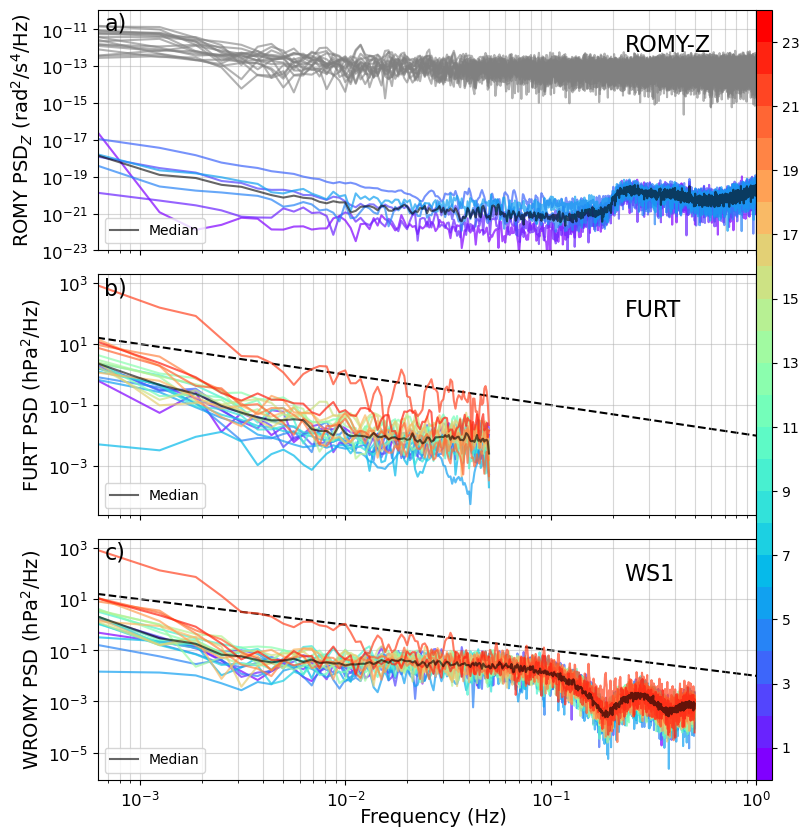

2023_WROMY_3600_20230712_hourly.pkl
 -> removed 22 rows due to mean thresholds!
 -> 2 psds remain
2023_WROMY_3600_20230713_hourly.pkl
 -> removed 22 rows due to mean thresholds!
 -> 2 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


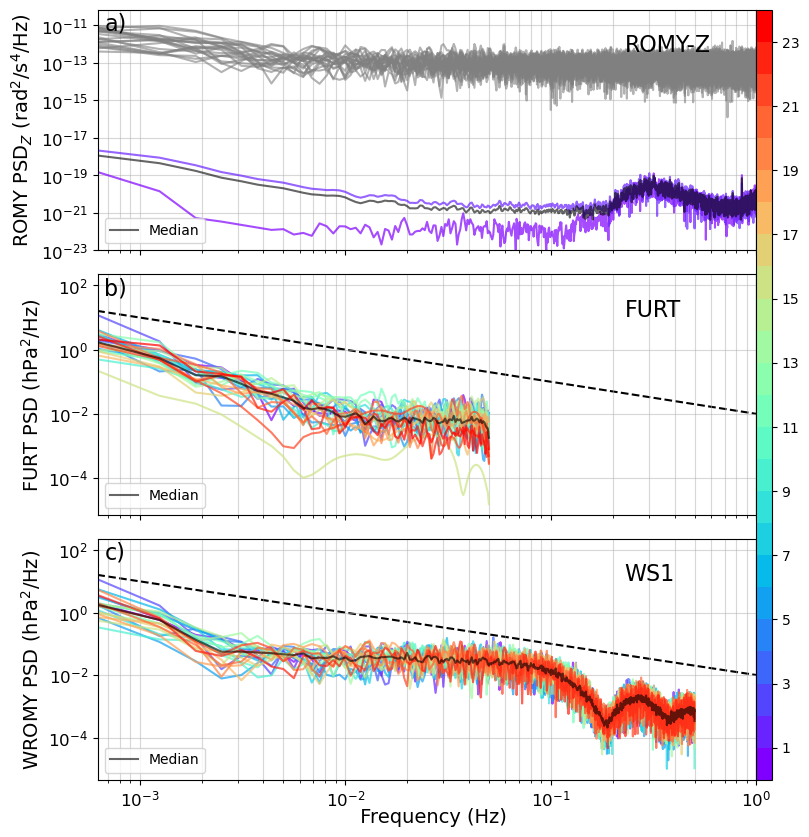

2023_WROMY_3600_20230714_hourly.pkl
 -> removed 9 rows due to mean thresholds!
 -> 15 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


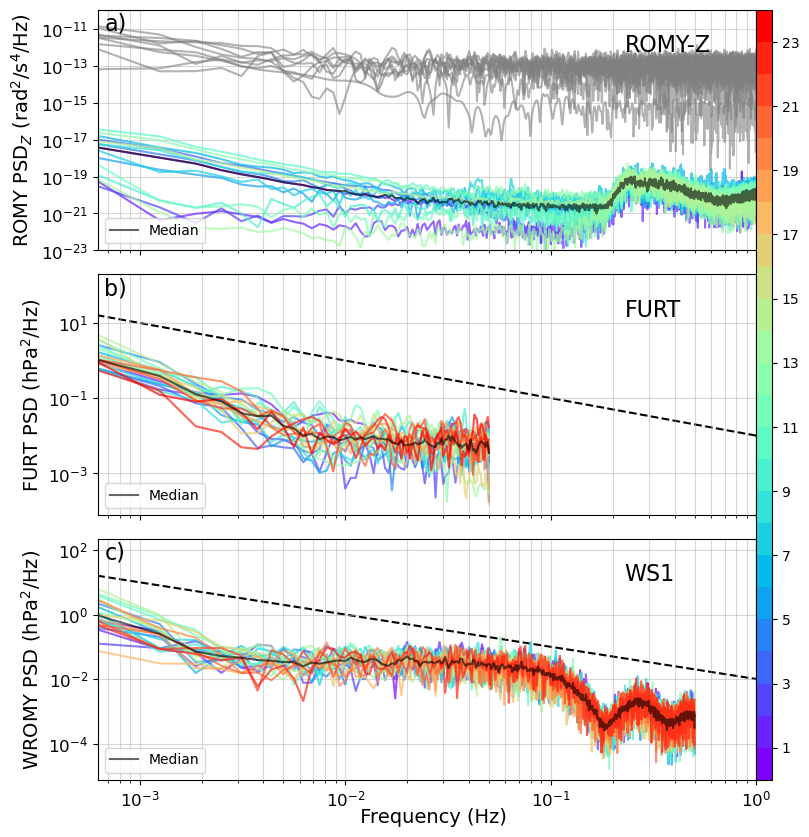

2023_WROMY_3600_20230715_hourly.pkl
 -> removed 12 rows due to mean thresholds!
 -> 12 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


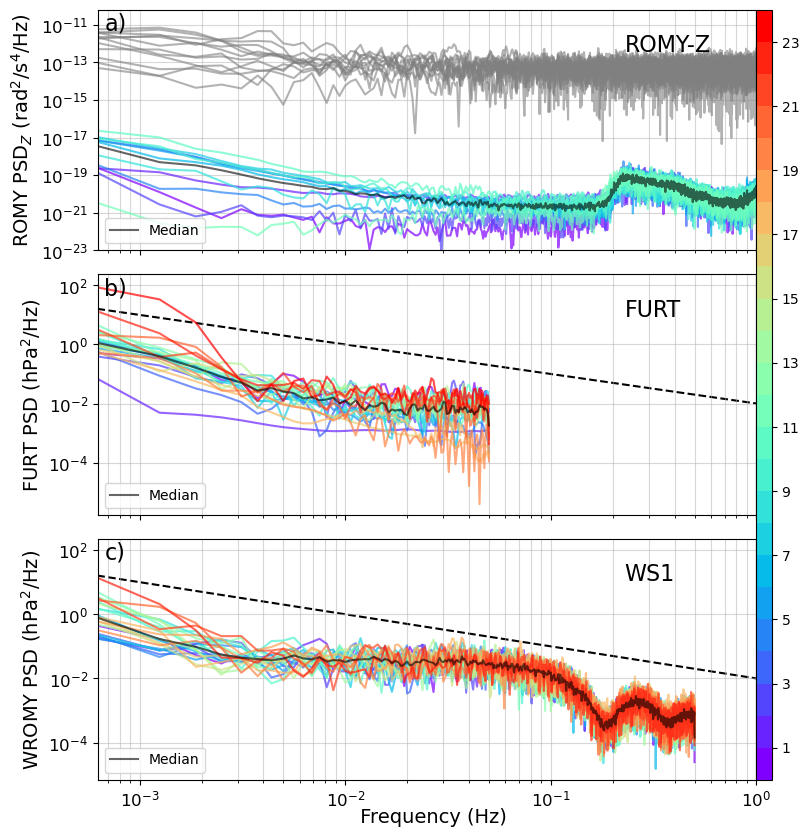

2023_WROMY_3600_20230716_hourly.pkl
 -> removed 18 rows due to mean thresholds!
 -> 6 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


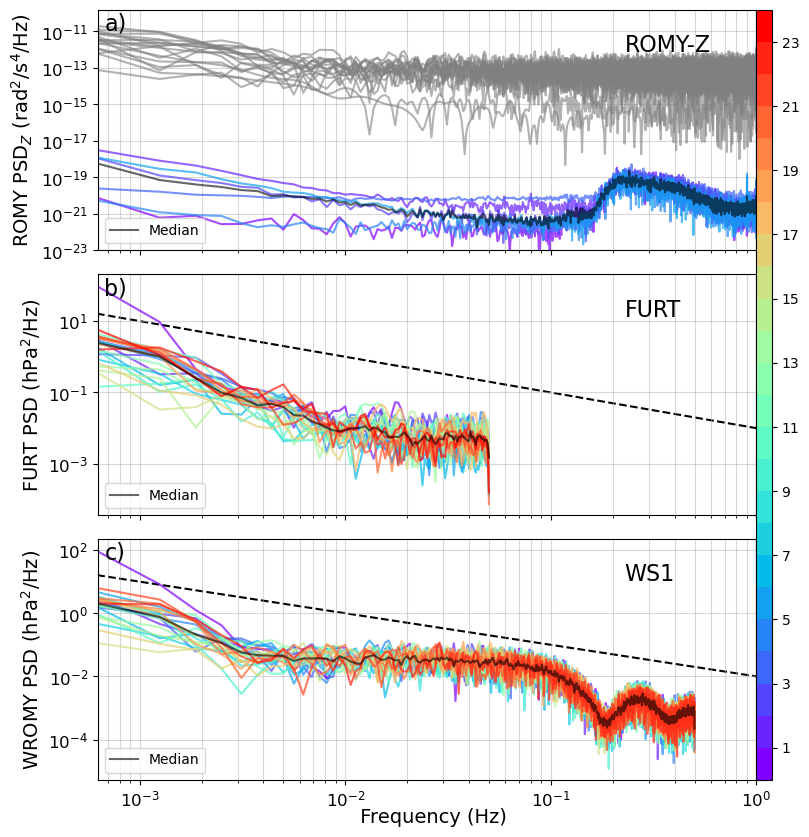

2023_WROMY_3600_20230717_hourly.pkl
 -> removed 19 rows due to mean thresholds!
 -> 5 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


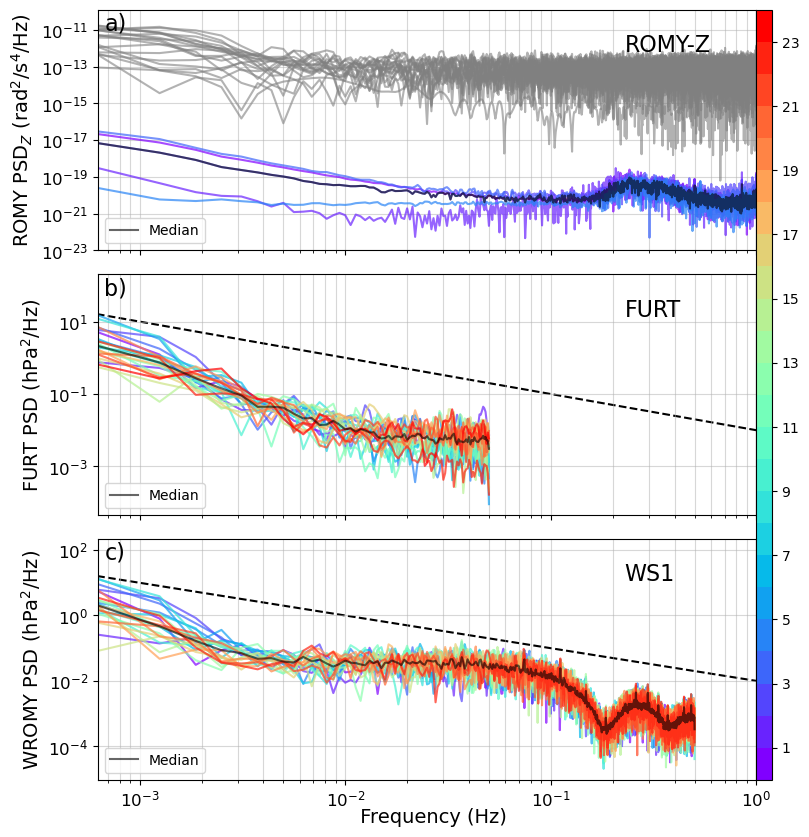

2023_WROMY_3600_20230718_hourly.pkl
 -> removed 12 rows due to mean thresholds!
 -> 12 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


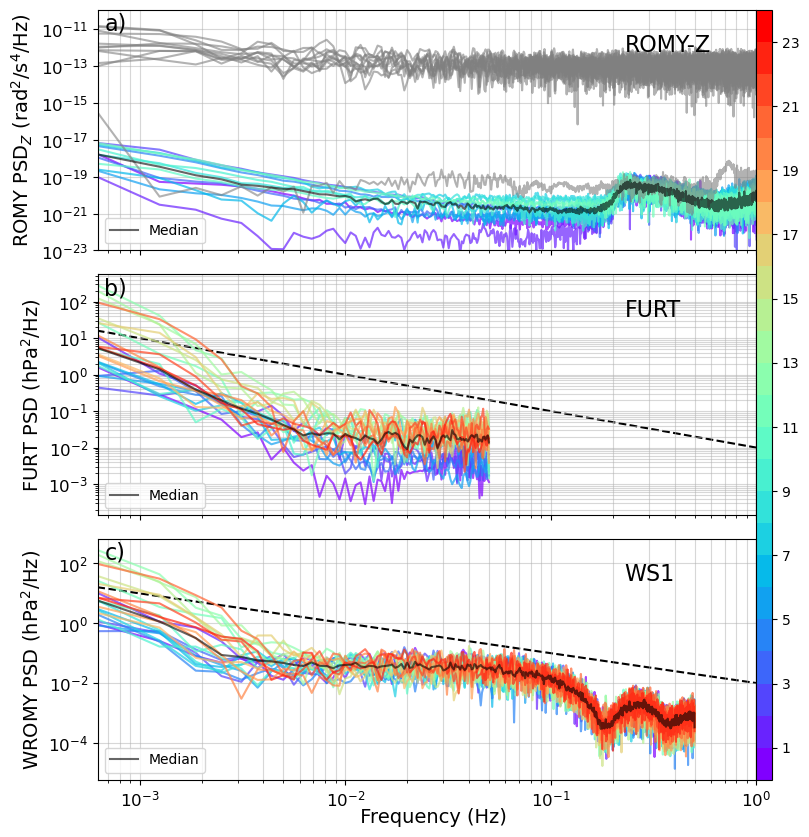

2023_WROMY_3600_20230719_hourly.pkl
 -> removed 20 rows due to mean thresholds!
 -> 4 psds remain
2023_WROMY_3600_20230720_hourly.pkl
 -> removed 16 rows due to mean thresholds!
 -> 8 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


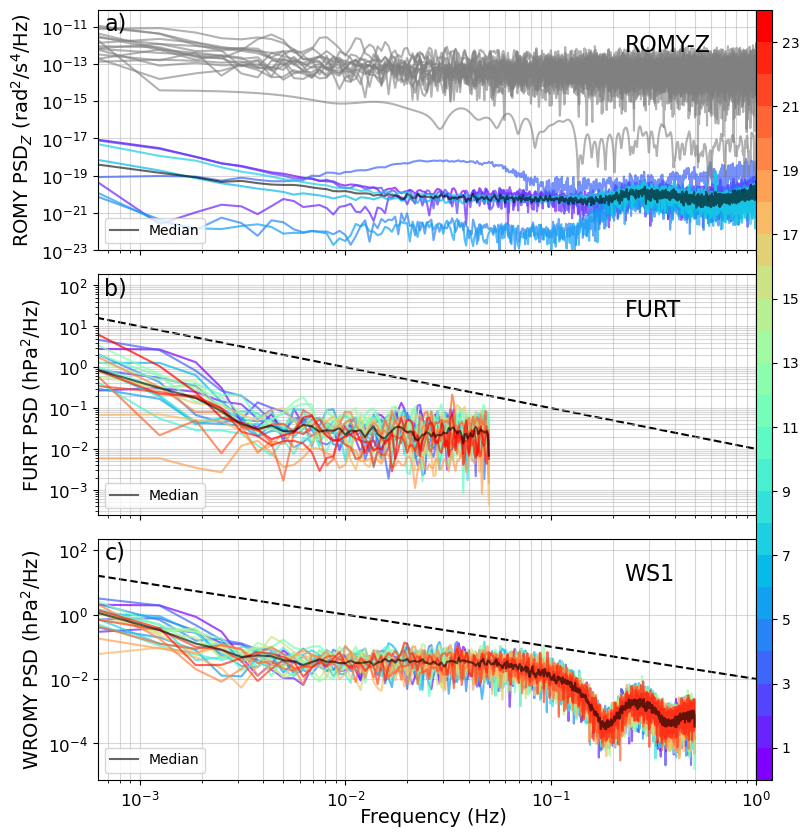

2023_WROMY_3600_20230721_hourly.pkl
 -> removed 16 rows due to mean thresholds!
 -> 8 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


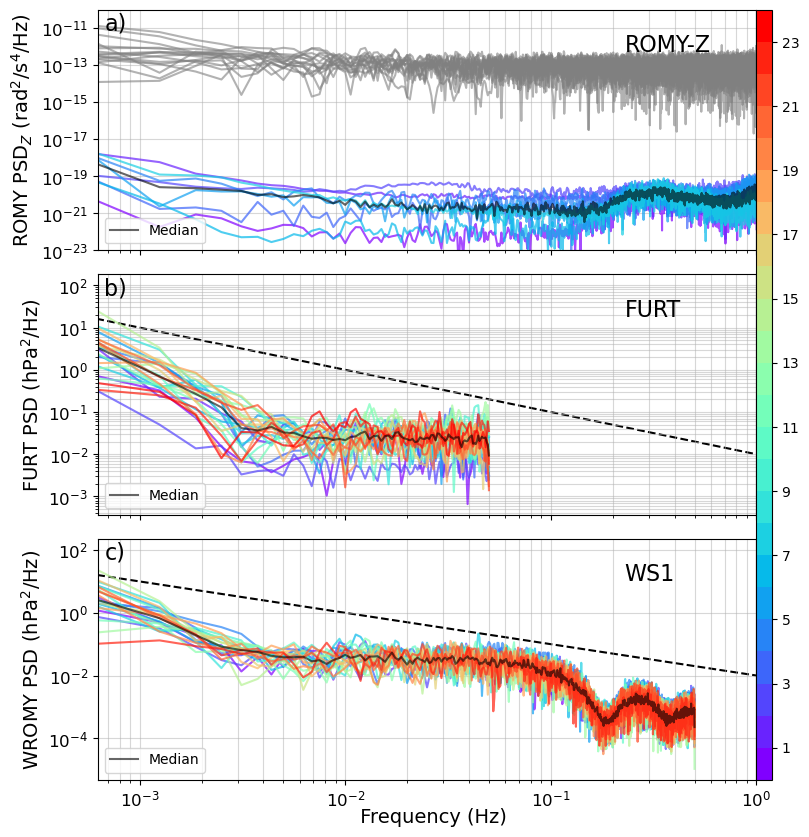

2023_WROMY_3600_20230722_hourly.pkl
 -> removed 19 rows due to mean thresholds!
 -> 5 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


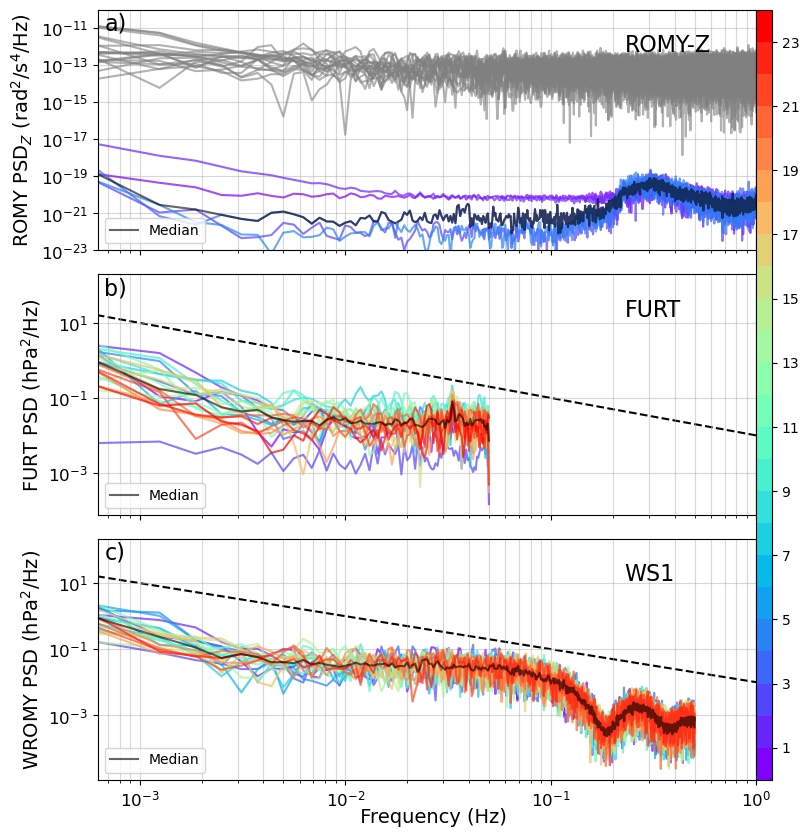

2023_WROMY_3600_20230723_hourly.pkl
 -> removed 16 rows due to mean thresholds!
 -> 8 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


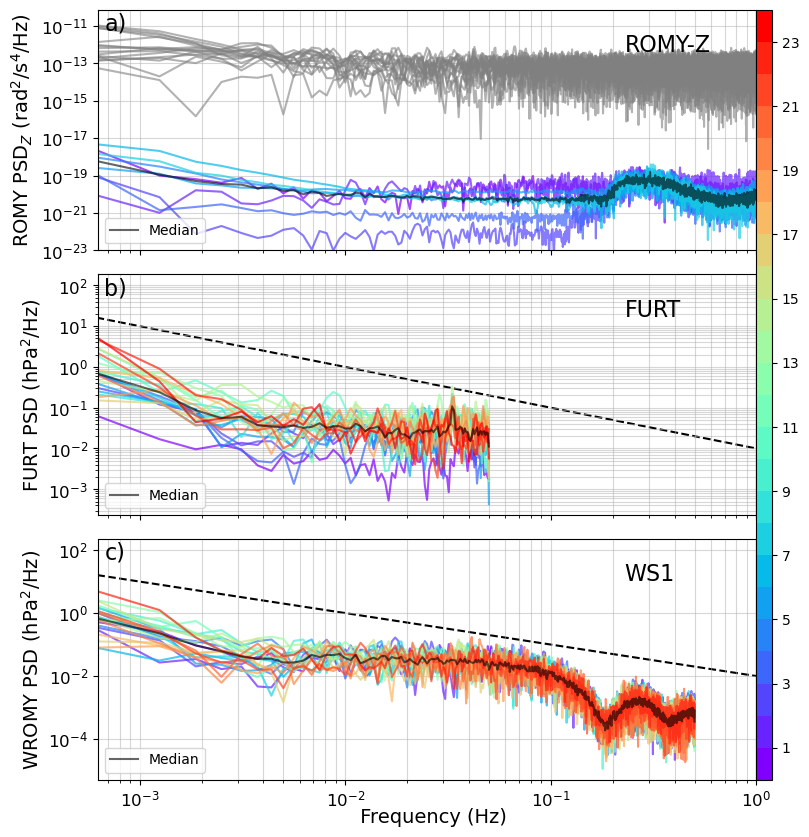

2023_WROMY_3600_20230724_hourly.pkl
 -> removed 17 rows due to mean thresholds!
 -> 7 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


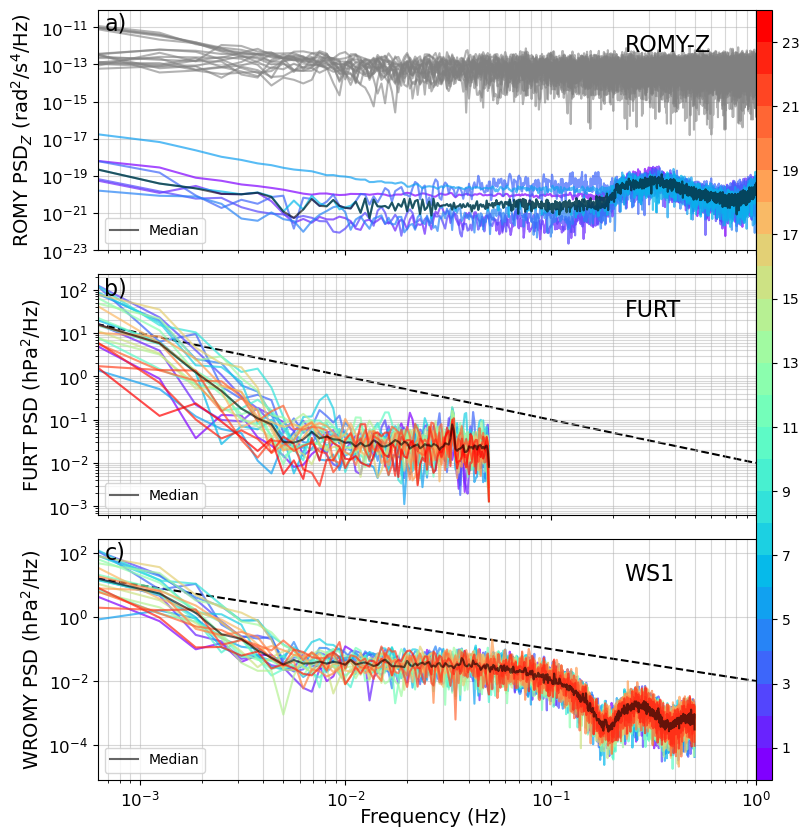

2023_WROMY_3600_20230725_hourly.pkl
 -> removed 17 rows due to mean thresholds!
 -> 7 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


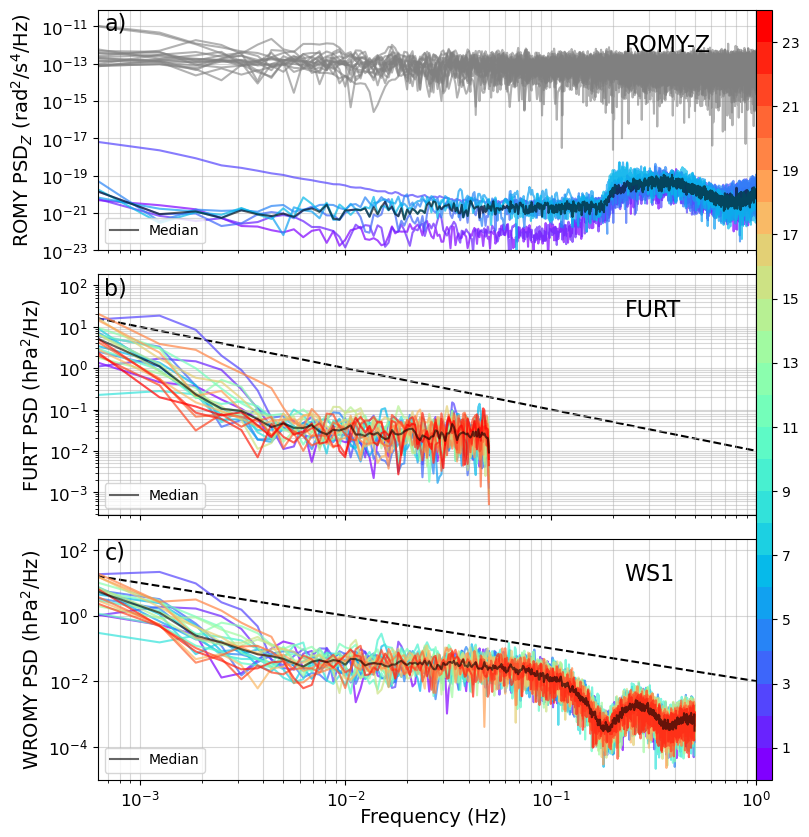

2023_WROMY_3600_20230726_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


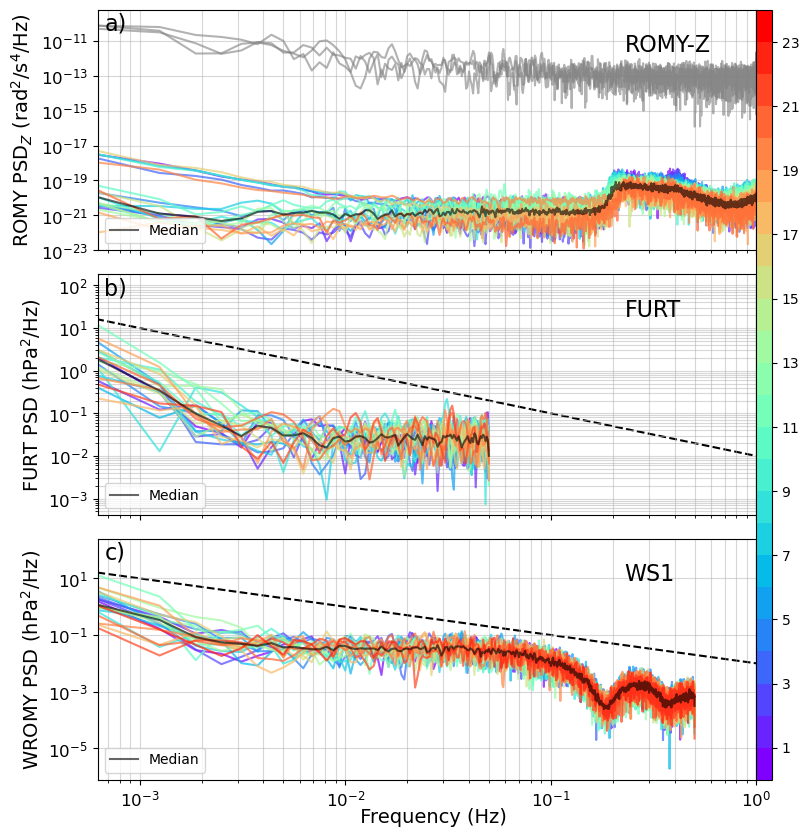

2023_WROMY_3600_20230727_hourly.pkl
 -> removed 3 rows due to mean thresholds!
 -> 21 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


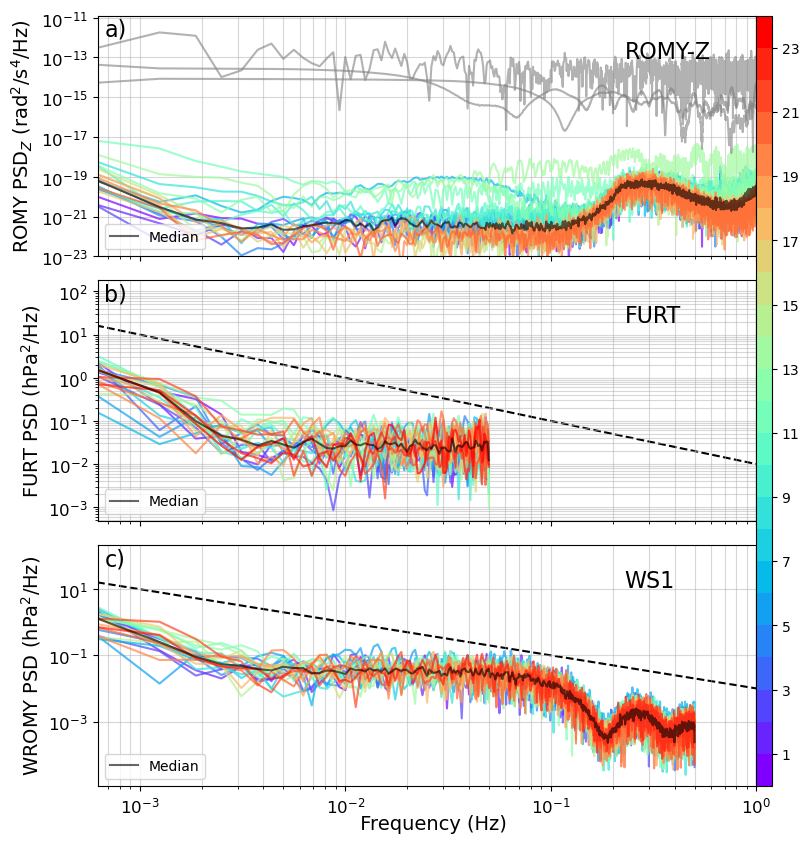

2023_WROMY_3600_20230728_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


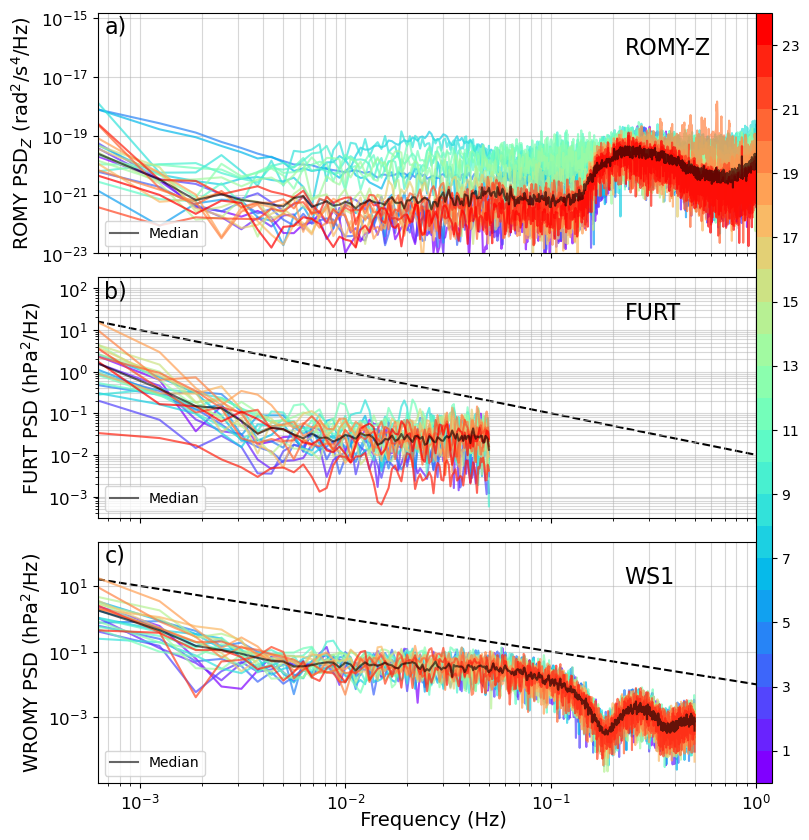

2023_WROMY_3600_20230729_hourly.pkl
 -> removed 2 rows due to mean thresholds!
 -> 22 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


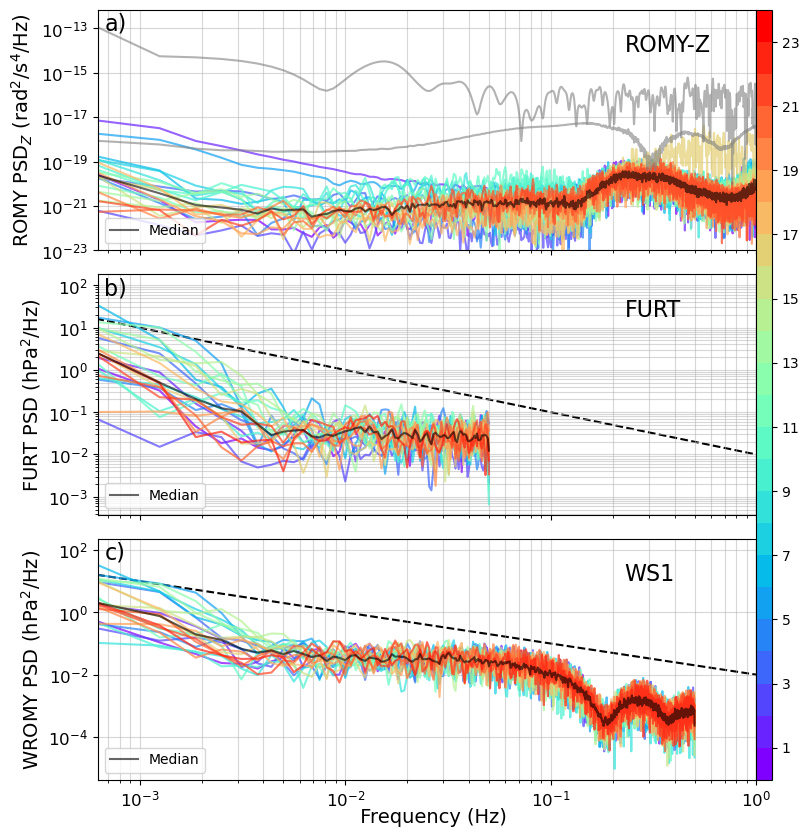

2023_WROMY_3600_20230730_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
2023_WROMY_3600_20230731_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


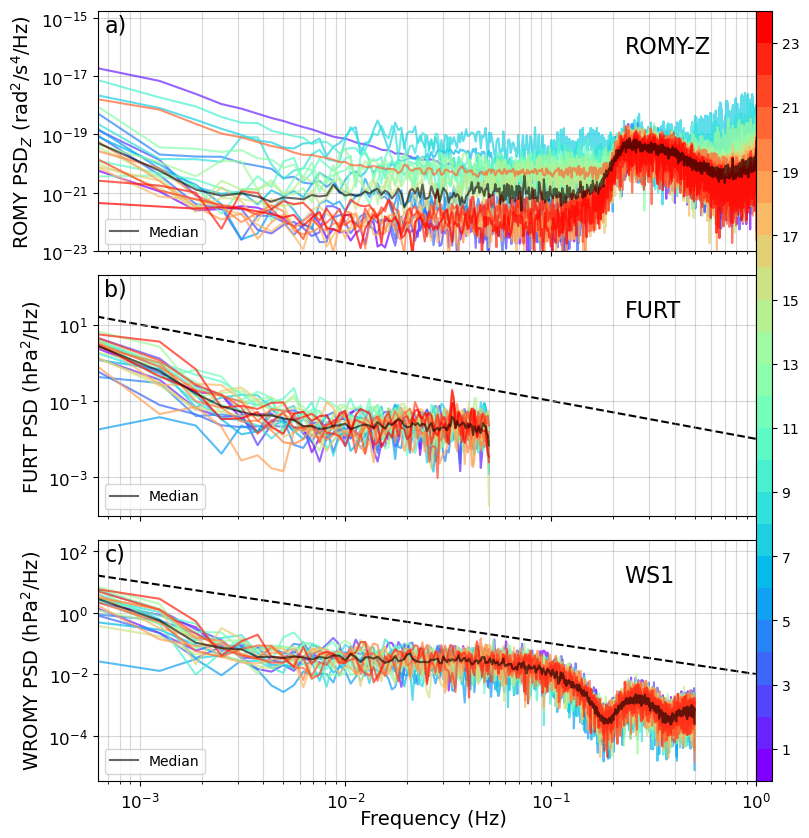

2023_WROMY_3600_20230801_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


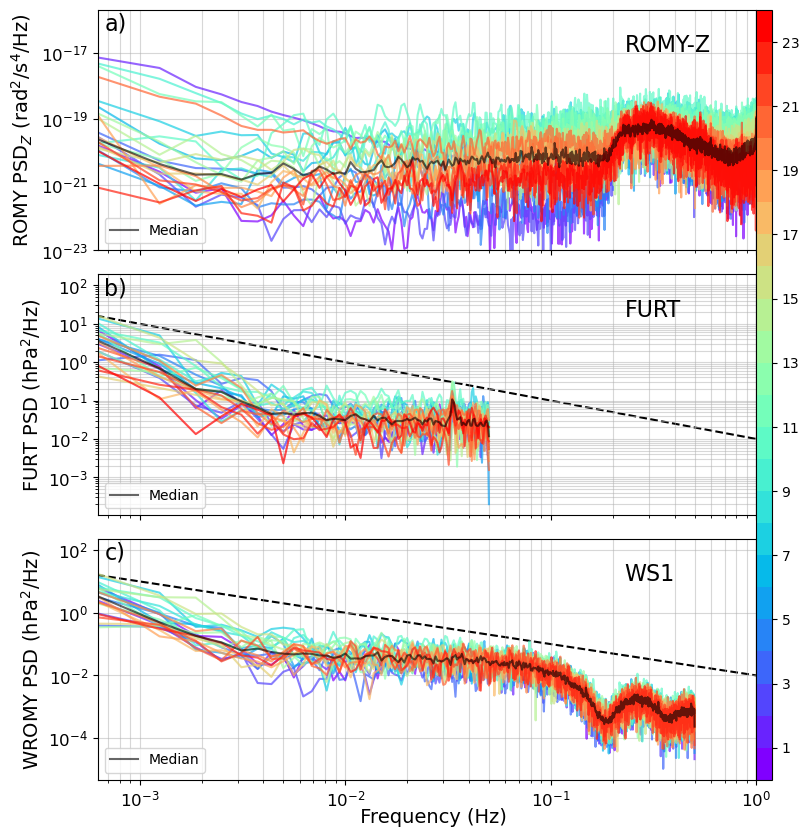

2023_WROMY_3600_20230802_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


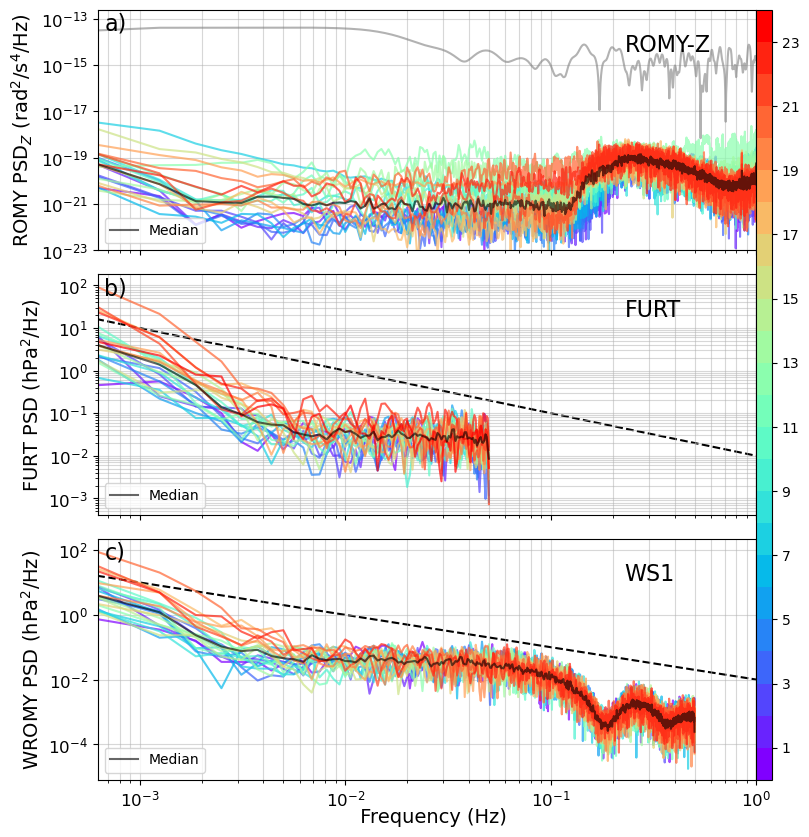

2023_WROMY_3600_20230803_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


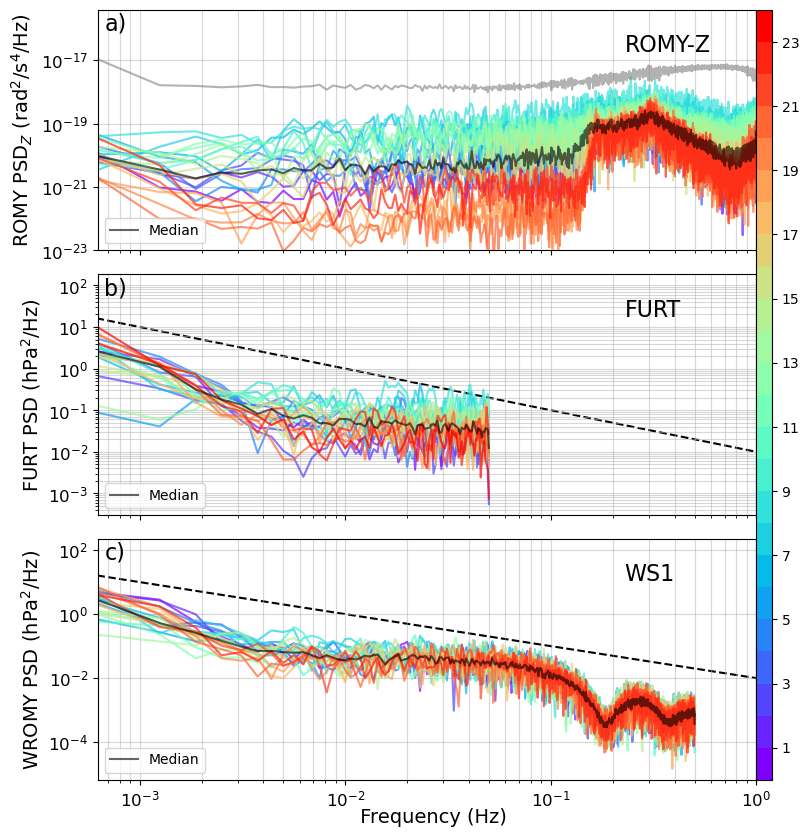

2023_WROMY_3600_20230804_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


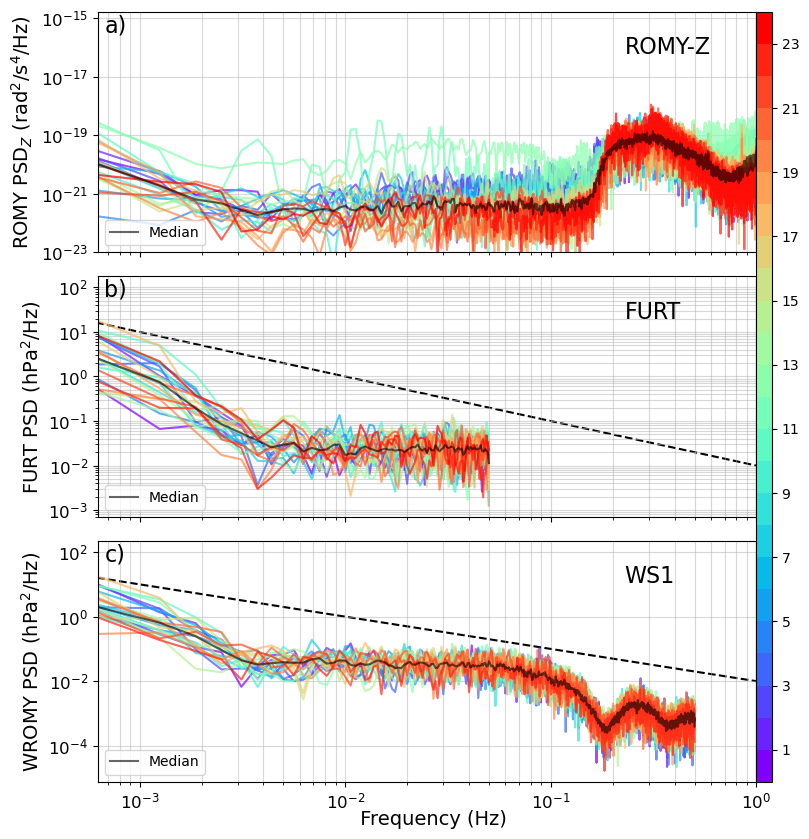

2023_WROMY_3600_20230805_hourly.pkl
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


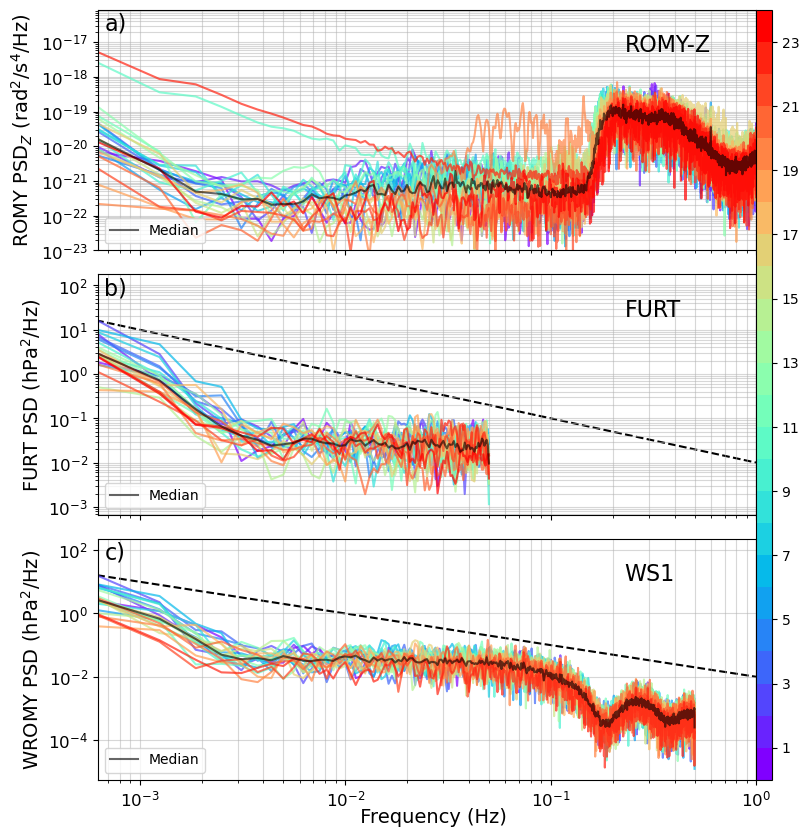

2023_WROMY_3600_20230806_hourly.pkl
 -> removed 1 rows due to mean thresholds!
 -> 23 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 24 psds remain
 -> removed 0 rows due to mean thresholds!
 -> 23 psds remain


/tmp/ipykernel_3454455/1406817038.py:16: RuntimeWarning: divide by zero encountered in divide
  ppp = 1/ff[mm]


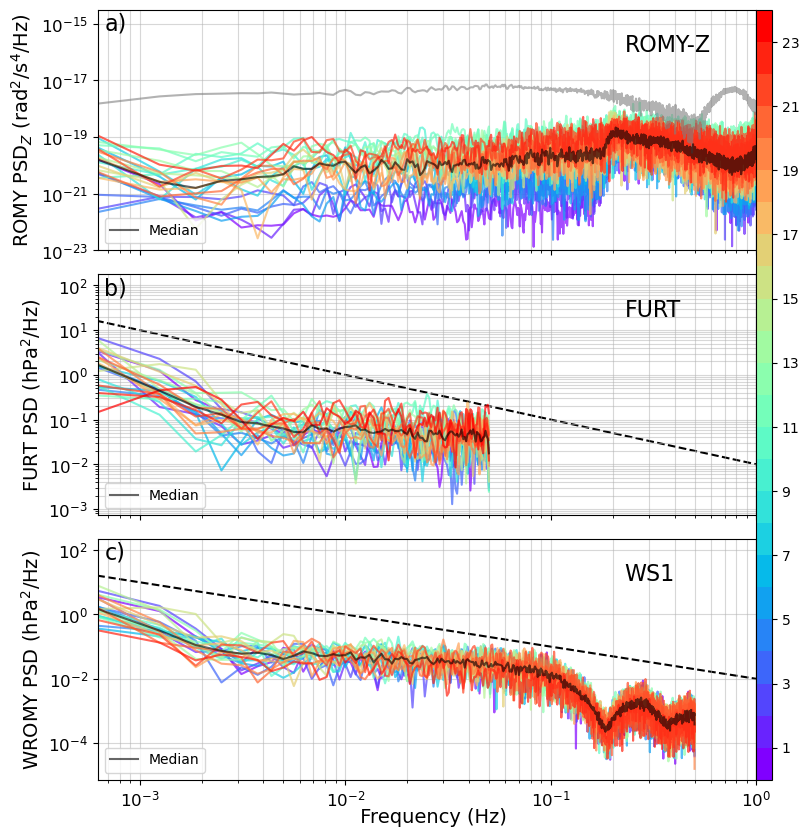

In [50]:
config['files'] = [file for file in os.listdir(config['inpath']) if "hourly" in file]
config['files'].sort()


psds_medians_out, times_out = [],[]

for file in config['files']:

    print(file)

    day = file.split("_")[-2]

    config['outpath_figname'] = "joint_"+day

    if os.path.isfile(config['outpath_figures']+config['outpath_figname']):
        continue

    try:
        ff_rot_z = pickle.load(open(path+f"ROMY/2023_ROMY_Z_3600_frequency_axis.pkl", 'rb'))
        rot_z = __load_data_file(path,f"ROMY/2023_ROMY_Z_3600_{day}_hourly.pkl")
        rot_z, rejected_rot = __remove_noisy_psds(rot_z, threshold_mean=1e-18, ff=ff_rot_z, flim=0.1)
#         rot_z, ff_rot_z = __cut_frequencies_array(rot_z, ff_rot_z, config['frequency_limits'][0], config['frequency_limits'][1])

#         ff_rot_z = pickle.load(open(path+f"ROMY/2023_ROMY_V_3600_frequency_axis.pkl", 'rb'))
#         rot_z = __load_data_file(path,f"ROMY/2023_ROMY_V_3600_{day}_hourly.pkl")
#         rot_z, rejected_rot = __remove_noisy_psds(rot_z, threshold_mean=1e-18, ff=ff_rot_z, flim=0.1)
#         rot_z, ff_rot_z = __cut_frequencies_array(rot_z, ff_rot_z, config['frequency_limits'][0], config['frequency_limits'][1])


        ff_furt = pickle.load(open(path+f"FURT/2023_FURT_3600_frequency_axis.pkl", 'rb'))
        furt = __load_data_file(path,f"FURT/2023_FURT_3600_{day}_hourly.pkl")
        furt, rejected_furt = __remove_noisy_psds(furt, threshold_mean=1e2)
#         furt, ff_furt = __cut_frequencies_array(furt, ff_furt, config['frequency_limits'][0], config['frequency_limits'][1])

        ff_wromy = pickle.load(open(path+f"WROMY/2023_WROMY_3600_frequency_axis.pkl", 'rb'))
        wromy = __load_data_file(path,f"WROMY/2023_WROMY_3600_{day}_hourly.pkl")
        wromy, rejected_wromy = __remove_noisy_psds(wromy, threshold_mean=1e2)
#         wromy, ff_wromy = __cut_frequencies_array(wromy, ff_wromy, config['frequency_limits'][0], config['frequency_limits'][1])

    except:
        continue

    fig = __makeplot_colorlines_overview(config,
                                         [ff_rot_z, ff_furt, ff_wromy],
                                         [rot_z, furt, wromy],
                                         [rejected_rot, rejected_furt, rejected_wromy],
                                         day)


    fig.savefig(config['outpath_figures']+config['outpath_figname']+".png", format="png", transparent=False, bbox_inches='tight', dpi=200)

In [64]:
    ## output data
#     psds_medians_out.append(psds_median)
#     times_out.append(time)

# ## write output
# output = {"times": array(times_out).astype(int), "frequencies": array(ff), "psds_medians": array(psds_medians_out)}

# with open(f"{config['inpath']}{config['inname']}_psds_filtered_medians.pkl", 'wb') as file:
#     pickle.dump(output, file, protocol=pickle.HIGHEST_PROTOCOL)